# Importación de librerías

In [5]:
!pip install pydataxm

In [88]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pydataxm import *
import datetime as dt
from datetime import datetime, timedelta
import requests
import matplotlib.dates as mdates 
objetoAPI = pydataxm.ReadDB()

## Demanda por actividad económica

In [30]:
df_demanda_se = objetoAPI.request_data(
                        "DemaComeNoReg",
                        "CIIU",
                        dt.date(2021, 1, 1),
                        dt.date(2024, 9, 30),
        )

c:\Users\Juliana\AppData\Local\Programs\Python\Python39\lib\site-packages\pydataxm\pydataxm.py:234: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead
  data[col] = pd.to_numeric(data[col],errors='ignore')
c:\Users\Juliana\AppData\Local\Programs\Python\Python39\lib\site-packages\pydataxm\pydataxm.py:236: FutureWarning: errors='ignore' is deprecated and will raise in a future version. Use to_datetime without passing `errors` and catch exceptions explicitly instead
  data['Date'] = pd.to_datetime(data['Date'],errors='ignore', format= '%Y-%m-%d')


In [3]:
df_demanda_se = pd.read_csv('./data/demanda_actividad_economica.csv')

In [5]:
df_demanda_se.head()

,Id,Values_Activity,Values_Subactivity,Values_code,Values_Hour01,Values_Hour02,Values_Hour03,Values_Hour04,Values_Hour05,Values_Hour06,...,Values_Hour16,Values_Hour17,Values_Hour18,Values_Hour19,Values_Hour20,Values_Hour21,Values_Hour22,Values_Hour23,Values_Hour24,Date
0,CIIU,"ACTIVIDADES ARTÍSTICAS, DE ENTRETENEMIENTO Y R...",ARTES PLÁSTICAS Y VISUALES,9005,30.48,24.99,25.32,21.72,22.17,20.50,...,82.23,78.69,79.79,82.28,79.94,79.38,80.69,70.32,49.41,2024-09-12
1,CIIU,"ACTIVIDADES ARTÍSTICAS, DE ENTRETENEMIENTO Y R...",ACTIVIDADES TEATRALES,9006,40.07,23.12,21.69,21.19,21.58,22.12,...,165.54,167.66,154.71,164.08,148.01,143.20,149.81,158.30,121.68,2024-09-12
2,CIIU,"ACTIVIDADES ARTÍSTICAS, DE ENTRETENEMIENTO Y R...",ACTIVIDADES DE ESPECTÁCULOS MUSICALES EN VIVO,9007,46.87,46.76,46.79,46.74,46.57,49.01,...,212.40,215.09,212.20,221.85,224.63,225.41,218.83,82.48,44.71,2024-09-12
3,CIIU,"ACTIVIDADES ARTÍSTICAS, DE ENTRETENEMIENTO Y R...",OTRAS ACTIVIDADES DE ESPECTÁCULOS EN VIVO,9008,88.41,80.01,79.61,74.44,61.27,61.91,...,203.78,227.73,260.78,209.93,172.26,151.44,135.26,115.08,107.99,2024-09-12
4,CIIU,"ACTIVIDADES ARTÍSTICAS, DE ENTRETENEMIENTO Y R...",ACTIVIDADES DE BIBLIOTECAS Y ARCHIVOS,9101,184.21,179.68,170.40,166.65,165.67,164.54,...,484.85,445.01,384.36,330.68,231.34,203.82,152.74,188.06,185.17,2024-09-12


In [6]:
df_demanda_se.columns

Index(['Id', 'Values_Activity', 'Values_Subactivity', 'Values_code',
       'Values_Hour01', 'Values_Hour02', 'Values_Hour03', 'Values_Hour04',
       'Values_Hour05', 'Values_Hour06', 'Values_Hour07', 'Values_Hour08',
       'Values_Hour09', 'Values_Hour10', 'Values_Hour11', 'Values_Hour12',
       'Values_Hour13', 'Values_Hour14', 'Values_Hour15', 'Values_Hour16',
       'Values_Hour17', 'Values_Hour18', 'Values_Hour19', 'Values_Hour20',
       'Values_Hour21', 'Values_Hour22', 'Values_Hour23', 'Values_Hour24',
       'Date'],
      dtype='object')

## Descripción de las Columnas del DataFrame

- **Id**: Identificador único.
- **Values_Activity**: Actividad económica principal relacionada con el consumo de energía.
- **Values_Subactivity**: Subactividad económica específica dentro de la actividad principal.
- **Values_code**: Código que representa la subactividad económica.
- **Values_Hour01 a Values_Hour24**: Demanda de energía en kWh para cada hora del día, de 01 a 24.
- **Date**: Fecha del registro de demanda de energía.

In [7]:
# Convertir a formato fecha
df_demanda_se['Date'] = pd.to_datetime(df_demanda_se['Date'])

In [8]:
# Sumar nulos por columna
df_demanda_se.isnull().sum()

Id                       0
Values_Activity          0
Values_Subactivity       0
Values_code              0
Values_Hour01          631
Values_Hour02          635
Values_Hour03          631
Values_Hour04          647
Values_Hour05          659
Values_Hour06          623
Values_Hour07         3373
Values_Hour08         4391
Values_Hour09         4394
Values_Hour10         4420
Values_Hour11         4492
Values_Hour12         4518
Values_Hour13         4577
Values_Hour14         4602
Values_Hour15         4555
Values_Hour16         4392
Values_Hour17         3935
Values_Hour18         3367
Values_Hour19          597
Values_Hour20          580
Values_Hour21          588
Values_Hour22          595
Values_Hour23          627
Values_Hour24          640
Date                     0
dtype: int64

Se observa que algunas columnas de hora tienen valores nulos, lo cual se debe a que no se registró demanda de energía para esa hora de esa actividad económica. En este caso, se reemplazan los valores nulos por cero.

In [9]:
# Reemplazar nulos por 0
df_demanda_se.fillna(0, inplace=True)

In [10]:
df_demanda_se.nunique()

Id                         1
Values_Activity           20
Values_Subactivity       362
Values_code              362
Values_Hour01         275622
Values_Hour02         274214
Values_Hour03         272763
Values_Hour04         272399
Values_Hour05         272676
Values_Hour06         273834
Values_Hour07         279813
Values_Hour08         291175
Values_Hour09         297154
Values_Hour10         300216
Values_Hour11         303254
Values_Hour12         304234
Values_Hour13         302513
Values_Hour14         302799
Values_Hour15         302471
Values_Hour16         302083
Values_Hour17         299277
Values_Hour18         293968
Values_Hour19         294890
Values_Hour20         292921
Values_Hour21         289741
Values_Hour22         283909
Values_Hour23         279103
Values_Hour24         277866
Date                    1369
dtype: int64

In [11]:
df_demanda_se['Values_Activity'].unique()

array(['ACTIVIDADES ARTÍSTICAS, DE ENTRETENEMIENTO Y RECREACIÓN',
       'ACTIVIDADES DE ATENCIÓN DE LA SALUD HUMANA Y DE ASISTENCIA SOCIAL',
       'ACTIVIDADES DE ORGANIZACIONES Y ENTIDADES EXTRATERRITORIALES',
       'ACTIVIDADES DE SERVICIOS ADMINISTRATIVOS Y DE APOYO',
       'ACTIVIDADES FINANCIERAS Y DE SEGUROS',
       'ACTIVIDADES INMOBILIARIAS',
       'ACTIVIDADES PROFESIONALES, CIENTÍFICAS Y TÉCNICAS',
       'ADMINISTRACIÓN PÚBLICA Y DEFENSA; PLANES DE SEGURIDAD SOCIAL DE AFILIACIÓN OBLIGATORIA',
       'AGRICULTURA, GANADERÍA, CAZA, SILVICULTURA Y PESCA',
       'ALOJAMIENTO Y SERVICIOS DE COMIDA',
       'COMERCIO AL POR MAYOR Y AL POR MENOR; REPARACIÓN DE VEHÍCULOS AUTOMOTORES Y MOTOCICLETAS',
       'CONSTRUCCIÓN',
       'DISTRIBUCIÓN DE AGUA; EVACUACIÓN Y TRATAMIENTO DE AGUAS RESIDUALES, GESTIÓN DE DESECHOS Y ACTIVIDADES DE SANEAMIENTO AMBIENTAL',
       'EDUCACIÓN', 'EXPLOTACIÓN DE MINAS Y CANTERAS',
       'INDUSTRIAS MANUFACTURERAS', 'INFORMACIÓN Y COMUNICACIONES'

Al imprimir el dataframe se observa que la información de demanda se encuentra por horas, por lo que se procede a agrupar por día sumando la demanda de cada hora. También se incluye unicamente la información de la la actividad económica porque la subactividad tiene mucha variabilidad.

In [12]:
horas = [f'Values_Hour{i:02d}' for i in range(1, 25)]
df_demanda_se['Total'] = df_demanda_se[horas].sum(axis=1)

Se eligen las columnas a utilizar y se renombran para facilitar su manipulación.

In [13]:
df_demanda_se = df_demanda_se[['Values_Activity', 'Date', 'Total']]

In [14]:
df_demanda_se.columns = ['CIIU', 'Fecha', 'Demanda']

In [15]:
df_demanda_se.describe()

,Fecha,Demanda
count,482866,4.828660e+05
mean,2022-11-14 23:37:56.979534592,1.910988e+05
min,2021-01-01 00:00:00,1.000000e-02
25%,2021-12-09 00:00:00,4.729600e+03
50%,2022-11-15 00:00:00,2.247765e+04
75%,2023-10-22 00:00:00,1.114271e+05
max,2024-09-30 00:00:00,1.610894e+07
std,NaN,7.727046e+05


### Descripción de Estadísticas

- **Cantidad de Registros (count)**: Se registraron un total de **482,866** entradas en el conjunto de datos.

- **Fecha Media (mean)**: La fecha promedio de los registros es **14 de noviembre de 2022 a las 23:37:56**. Esto indica que la mayoría de los datos están concentrados en el año 2022.

- **Fecha Mínima (min)**: La fecha más antigua en el conjunto de datos es el **1 de enero de 2021**, lo que significa que los datos abarcan un periodo de tiempo que inicia desde esa fecha.

- **Demanda Mínima (min)**: El valor mínimo de demanda registrado es de **0.01 kWh**, indicando que hubo momentos de muy baja o nula demanda.

- **Demanda Cuartil 25% (25%)**: El 25% de los registros tienen una demanda de **4,729.6 kWh**, lo que refleja que una parte significativa de los registros presenta niveles de demanda relativamente bajos.

- **Demanda Mediana (50%)**: La demanda mediana es de **22,477.65 kWh**, lo que sugiere que la mitad de los registros tienen una demanda igual o inferior a este valor.

- **Demanda Cuartil 75% (75%)**: El 75% de los registros muestran una demanda de **111,427.1 kWh**, indicando que una gran mayoría de las demandas diarias superan este umbral.

- **Demanda Máxima (max)**: La demanda máxima registrada es de **16,108,940 kWh**, lo que representa un pico significativo en el consumo de energía.

- **Desviación Estándar (std)**: La desviación estándar no está disponible (NaN), lo que sugiere que no se pudo calcular debido a la falta de datos suficientes o problemas en la agrupación de datos.


In [16]:
estadisticas_por_ciiu = df_demanda_se.groupby('CIIU')['Demanda'].describe()

In [17]:
estadisticas_por_ciiu

,count,mean,std,min,25%,50%,75%,max
CIIU,,,,,,,,
"ACTIVIDADES ARTÍSTICAS, DE ENTRETENEMIENTO Y RECREACIÓN",17068.0,1.772823e+04,2.795797e+04,43.39,2117.4375,4382.225,25006.2425,143885.41
ACTIVIDADES DE ATENCIÓN DE LA SALUD HUMANA Y DE ASISTENCIA SOCIAL,10952.0,1.947056e+05,4.030440e+05,235.15,15008.8925,43486.775,88978.1325,1439859.69
ACTIVIDADES DE ORGANIZACIONES Y ENTIDADES EXTRATERRITORIALES,1369.0,7.158876e+04,6.224365e+03,55669.43,67951.7400,70679.330,73481.1200,114091.14
ACTIVIDADES DE SERVICIOS ADMINISTRATIVOS Y DE APOYO,20443.0,2.277917e+04,3.636445e+04,38.13,2032.0550,4602.430,29002.1200,175483.70
ACTIVIDADES FINANCIERAS Y DE SEGUROS,19166.0,2.151365e+04,4.300884e+04,56.76,1807.9050,5177.905,11603.4075,193174.87
ACTIVIDADES INMOBILIARIAS,2738.0,4.784949e+05,9.477497e+04,232792.08,414299.2675,453741.630,572154.7575,679025.25
"ACTIVIDADES PROFESIONALES, CIENTÍFICAS Y TÉCNICAS",6845.0,5.402877e+04,5.537290e+04,2515.72,14650.9000,26208.010,82225.7400,190015.61
ADMINISTRACIÓN PÚBLICA Y DEFENSA; PLANES DE SEGURIDAD SOCIAL DE AFILIACIÓN OBLIGATORIA,10952.0,3.653753e+05,6.928712e+05,1091.58,31185.3225,101775.890,206816.1525,2611223.37
"AGRICULTURA, GANADERÍA, CAZA, SILVICULTURA Y PESCA",40785.0,8.216018e+04,1.841256e+05,0.67,8042.7900,25570.950,65955.5000,1200131.58


In [18]:
df_demanda_se_top_10 = df_demanda_se.groupby("CIIU")["Demanda"].sum().reset_index().sort_values(by="Demanda", ascending=False).head(10)

In [19]:
df_demanda_se_top_10

,CIIU,Demanda
15,INDUSTRIAS MANUFACTURERAS,3.801597e+10
14,EXPLOTACIÓN DE MINAS Y CANTERAS,2.561976e+10
10,COMERCIO AL POR MAYOR Y AL POR MENOR; REPARACI...,4.869155e+09
7,ADMINISTRACIÓN PÚBLICA Y DEFENSA; PLANES DE SE...,4.001591e+09
8,"AGRICULTURA, GANADERÍA, CAZA, SILVICULTURA Y P...",3.350903e+09
12,DISTRIBUCIÓN DE AGUA; EVACUACIÓN Y TRATAMIENTO...,2.871674e+09
1,ACTIVIDADES DE ATENCIÓN DE LA SALUD HUMANA Y D...,2.132416e+09
19,TRANSPORTE Y ALMACENAMIENTO,1.976418e+09
18,"SUMINISTRO DE ELECTRICIDAD, GAS, VAPOR Y AIRE ...",1.483156e+09
16,INFORMACIÓN Y COMUNICACIONES,1.439147e+09


### Análisis
1. **Industrias Manufactureras** lidera el consumo de energía con una demanda total de **38.02 mil millones de kWh**, indicando un alto nivel de actividad económica.
2. **Explotación de Minas y Canteras** es la segunda actividad más demandante, con aproximadamente **25.62 mil millones de kWh**, lo que refleja la importancia de este sector en términos de consumo energético.
3. **Comercio al por Mayor y al por Menor** también muestra un consumo significativo, aunque mucho menor que las dos primeras actividades, con **4.87 mil millones de kWh**.
4. Otros sectores, como la **Administración Pública**, **Agricultura**, y **Transporte**, presentan demandas inferiores, pero aún relevantes, en el contexto de consumo energético general.
5. La **información y comunicaciones** tienen una demanda más baja en comparación con las industrias más pesadas, sugiriendo un menor consumo de energía.

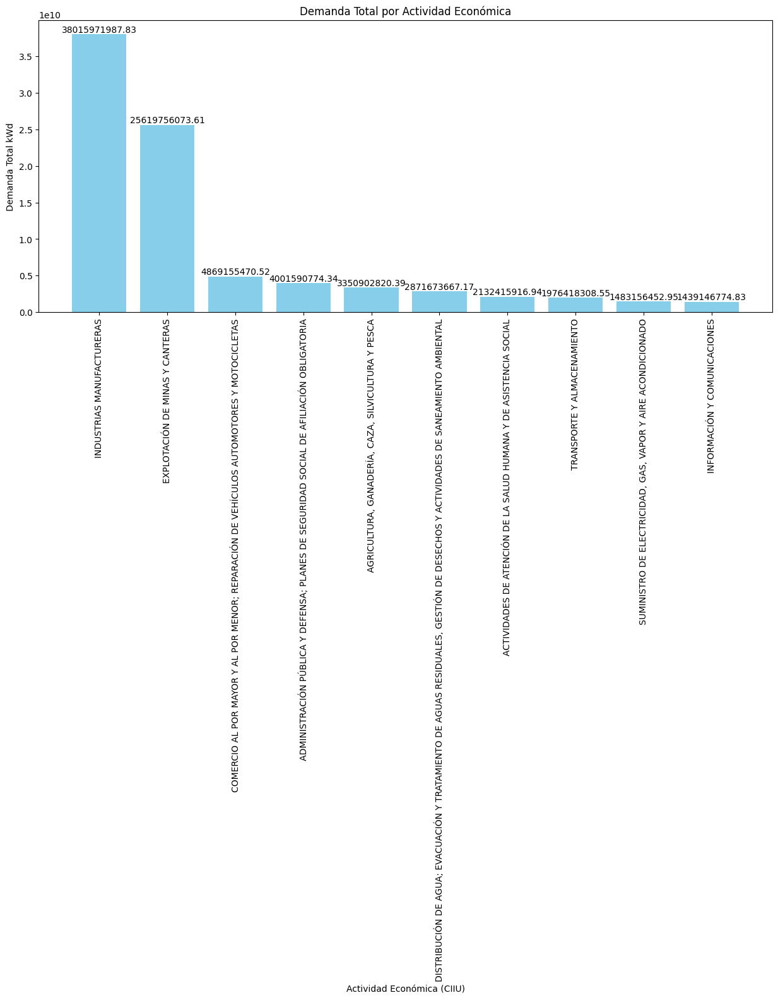

In [20]:
# Graficar la demanda total por actividad económica
plt.figure(figsize=(15, 6))


# Crear las barras
bars = plt.bar(df_demanda_se_top_10["CIIU"], df_demanda_se_top_10["Demanda"], color='skyblue')
plt.xlabel("Actividad Económica (CIIU)")
plt.ylabel("Demanda Total kWd")
plt.title("Demanda Total por Actividad Económica")
plt.xticks(rotation=90) 


# Añadir etiquetas de totales encima de cada barra
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval, round(yval, 2), ha="center", va="bottom")

plt.show()



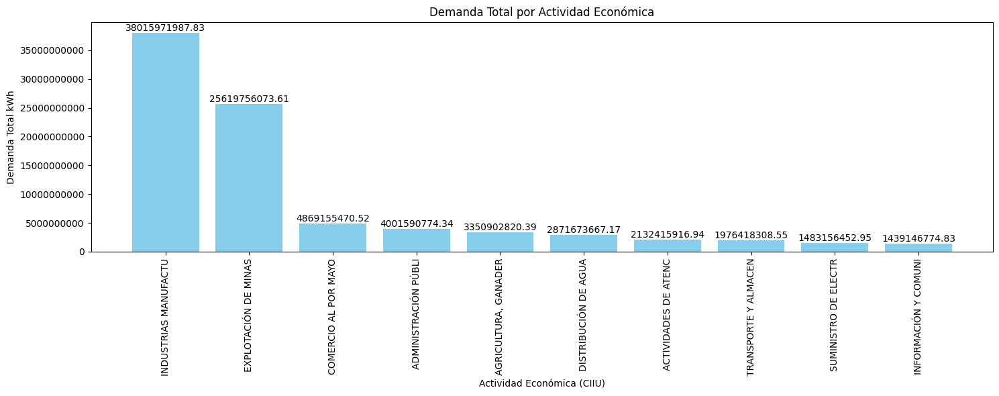

In [70]:
# Truncar las etiquetas de actividad económica a 10 caracteres
df_demanda_se_top_10["CIIU_abreviado"] = df_demanda_se_top_10["CIIU"].str[:20]

# Crear la figura
plt.figure(figsize=(15, 6))

# Crear las barras usando las etiquetas truncadas
bars = plt.bar(df_demanda_se_top_10["CIIU_abreviado"], df_demanda_se_top_10["Demanda"], color='skyblue')
plt.xlabel("Actividad Económica (CIIU)")
plt.ylabel("Demanda Total kWh")
plt.title("Demanda Total por Actividad Económica")
plt.xticks(rotation=90)

plt.ticklabel_format(axis="y", style="plain")

# Añadir etiquetas de totales encima de cada barra
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval, round(yval, 2), ha="center", va="bottom")

plt.tight_layout()
plt.show()

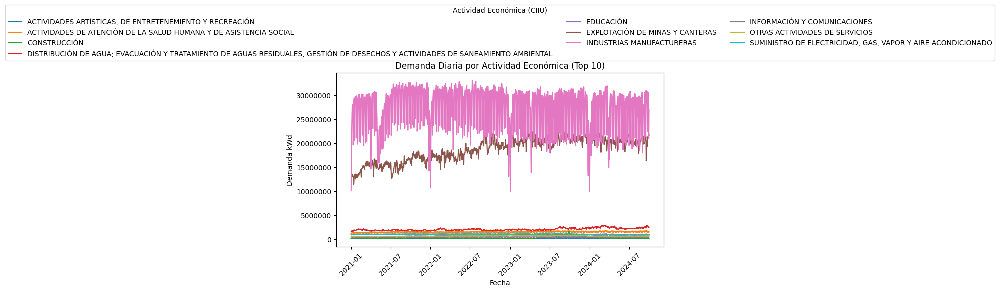

In [73]:
# Agrupar por fecha y CIIU y sumar la demanda diaria
df_demanda_diaria = df_demanda_se.groupby(['Fecha', 'CIIU'])['Demanda'].sum().reset_index()

# Filtrar las primeras 10 actividades económicas
top_10_ciiu = df_demanda_diaria['CIIU'].value_counts().head(10).index
df_top_10 = df_demanda_diaria[df_demanda_diaria['CIIU'].isin(top_10_ciiu)]

# Crear una figura
plt.figure(figsize=(15, 6))

# Graficar cada CIIU en una línea
for ciu in df_top_10['CIIU'].unique():
    subset = df_top_10[df_top_10['CIIU'] == ciu]
    plt.plot(subset['Fecha'], subset['Demanda'], label=ciu)

plt.xlabel("Fecha")
plt.ylabel("Demanda kWd")
plt.title("Demanda Diaria por Actividad Económica (Top 10)")

# Colocar la leyenda en la parte superior
plt.legend(title="Actividad Económica (CIIU)", bbox_to_anchor=(0.5, 1.05), loc='lower center', ncol=3)

plt.ticklabel_format(axis="y", style="plain")

plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

C:\Users\Juliana\AppData\Local\Temp\ipykernel_23116\2553104562.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_top_10['CIIU_abreviado'] = df_top_10['CIIU'].str[:20]


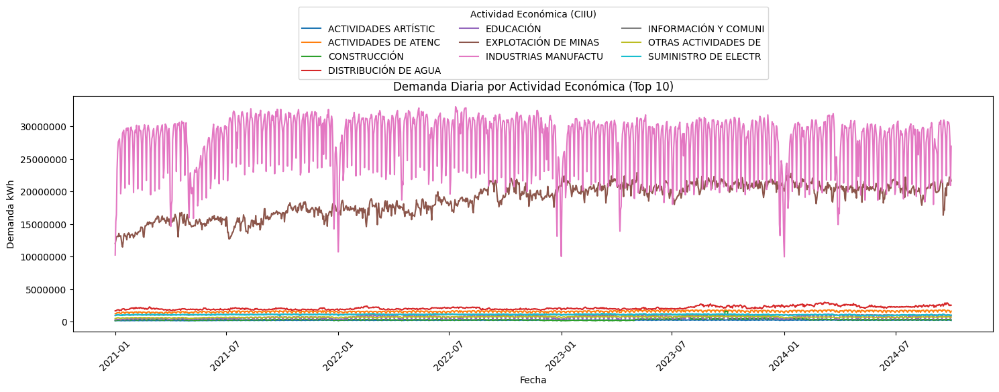

In [74]:
# Agrupar por fecha y CIIU y sumar la demanda diaria
df_demanda_diaria = df_demanda_se.groupby(['Fecha', 'CIIU'])['Demanda'].sum().reset_index()

# Filtrar las primeras 10 actividades económicas
top_10_ciiu = df_demanda_diaria['CIIU'].value_counts().head(10).index
df_top_10 = df_demanda_diaria[df_demanda_diaria['CIIU'].isin(top_10_ciiu)]

# Crear una columna de nombres abreviados con un máximo de 10 caracteres
df_top_10['CIIU_abreviado'] = df_top_10['CIIU'].str[:20]

# Crear una figura
plt.figure(figsize=(15, 6))

# Graficar cada CIIU abreviado en una línea
for ciu in df_top_10['CIIU_abreviado'].unique():
    subset = df_top_10[df_top_10['CIIU_abreviado'] == ciu]
    plt.plot(subset['Fecha'], subset['Demanda'], label=ciu)

plt.xlabel("Fecha")
plt.ylabel("Demanda kWh")
plt.title("Demanda Diaria por Actividad Económica (Top 10)")

# Colocar la leyenda en la parte superior
plt.legend(title="Actividad Económica (CIIU)", bbox_to_anchor=(0.5, 1.05), loc='lower center', ncol=3)

plt.ticklabel_format(axis="y", style="plain")

plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

### Demanda diaria por Actividad Económica

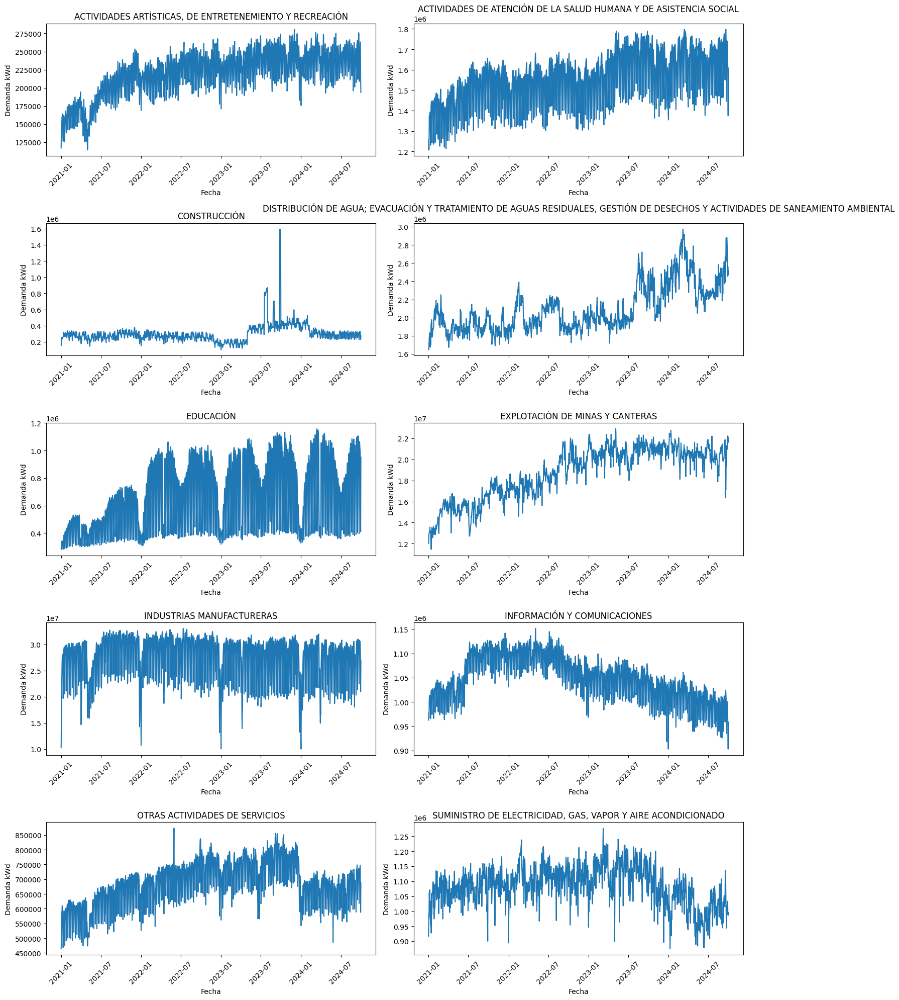

In [31]:
df_demanda_diaria = df_demanda_se.groupby(['Fecha', 'CIIU'])['Demanda'].sum().reset_index()

# Filtrar las primeras 10 actividades económicas
top_10_ciiu = df_demanda_diaria['CIIU'].value_counts().head(10).index
df_top_10 = df_demanda_diaria[df_demanda_diaria['CIIU'].isin(top_10_ciiu)]

pivot_df = df_top_10.pivot(index='Fecha', columns='CIIU', values='Demanda')

# Crear la figura y los ejes
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
axes = axes.flatten()

# Graficar cada CIIU en un subplot
for i, ciu in enumerate(pivot_df.columns):
    axes[i].plot(pivot_df.index, pivot_df[ciu], label=ciu)
    axes[i].set_title(ciu)
    axes[i].set_xlabel("Fecha")
    axes[i].set_ylabel("Demanda kWd")
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

### 2021

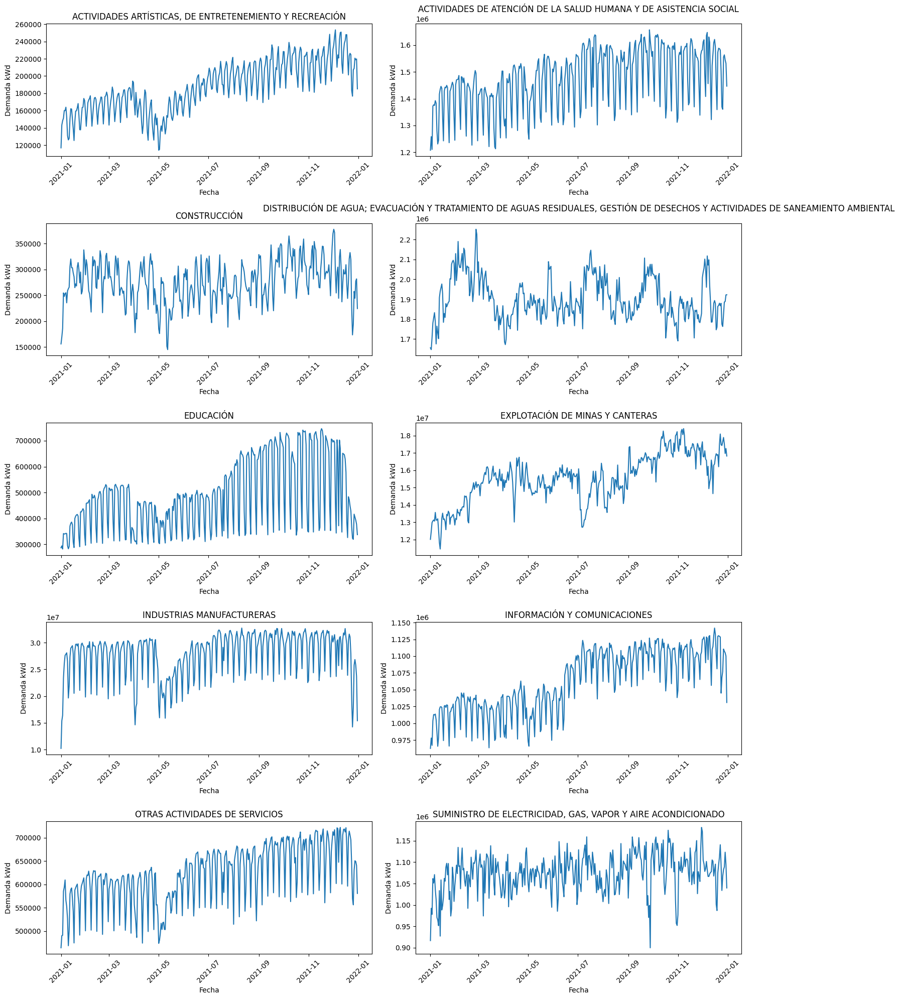

In [23]:
df_demanda_2021 = df_demanda_se[df_demanda_se['Fecha'].dt.year == 2021]

# Agrupar por fecha y CIIU y sumar la demanda diaria
df_demanda_diaria_2021 = df_demanda_2021.groupby(['Fecha', 'CIIU'])['Demanda'].sum().reset_index()

# Filtrar las primeras 10 actividades económicas
top_10_ciiu_2021 = df_demanda_diaria_2021['CIIU'].value_counts().head(10).index
df_top_10_2021 = df_demanda_diaria_2021[df_demanda_diaria_2021['CIIU'].isin(top_10_ciiu_2021)]

# Pivotear la tabla para obtener un formato adecuado para el gráfico
pivot_df_2021 = df_top_10_2021.pivot(index='Fecha', columns='CIIU', values='Demanda')

# Crear la figura y los ejes
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
axes = axes.flatten()

# Graficar cada CIIU en un subplot
for i, ciu in enumerate(pivot_df_2021.columns):
    axes[i].plot(pivot_df_2021.index, pivot_df_2021[ciu], label=ciu)
    axes[i].set_title(ciu)
    axes[i].set_xlabel("Fecha")
    axes[i].set_ylabel("Demanda kWd")
    axes[i].tick_params(axis='x', rotation=45)

# Ajustar el layout
plt.tight_layout()
plt.show()

### 2022

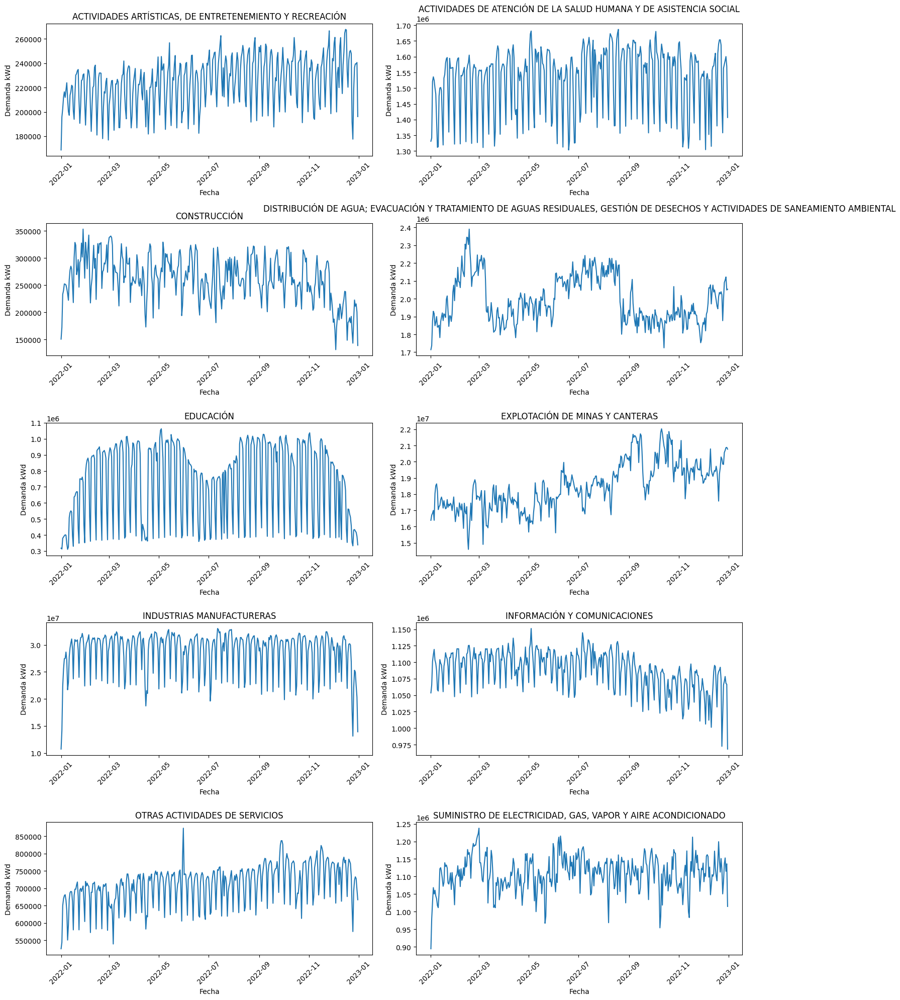

In [24]:
# Filtrar el dataframe para incluir solo el año 2022
df_demanda_2022 = df_demanda_se[df_demanda_se['Fecha'].dt.year == 2022]

# Agrupar por fecha y CIIU y sumar la demanda diaria
df_demanda_diaria_2022 = df_demanda_2022.groupby(['Fecha', 'CIIU'])['Demanda'].sum().reset_index()

# Filtrar las primeras 10 actividades económicas
top_10_ciiu_2022 = df_demanda_diaria_2022['CIIU'].value_counts().head(10).index
df_top_10_2022 = df_demanda_diaria_2022[df_demanda_diaria_2022['CIIU'].isin(top_10_ciiu_2022)]

# Pivotear la tabla para obtener un formato adecuado para el gráfico
pivot_df_2022 = df_top_10_2022.pivot(index='Fecha', columns='CIIU', values='Demanda')

# Crear la figura y los ejes
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
axes = axes.flatten()

# Graficar cada CIIU en un subplot
for i, ciu in enumerate(pivot_df_2022.columns):
    axes[i].plot(pivot_df_2022.index, pivot_df_2022[ciu], label=ciu)
    axes[i].set_title(ciu)
    axes[i].set_xlabel("Fecha")
    axes[i].set_ylabel("Demanda kWd")
    axes[i].tick_params(axis='x', rotation=45)

# Ajustar el layout
plt.tight_layout()
plt.show()

### 2023

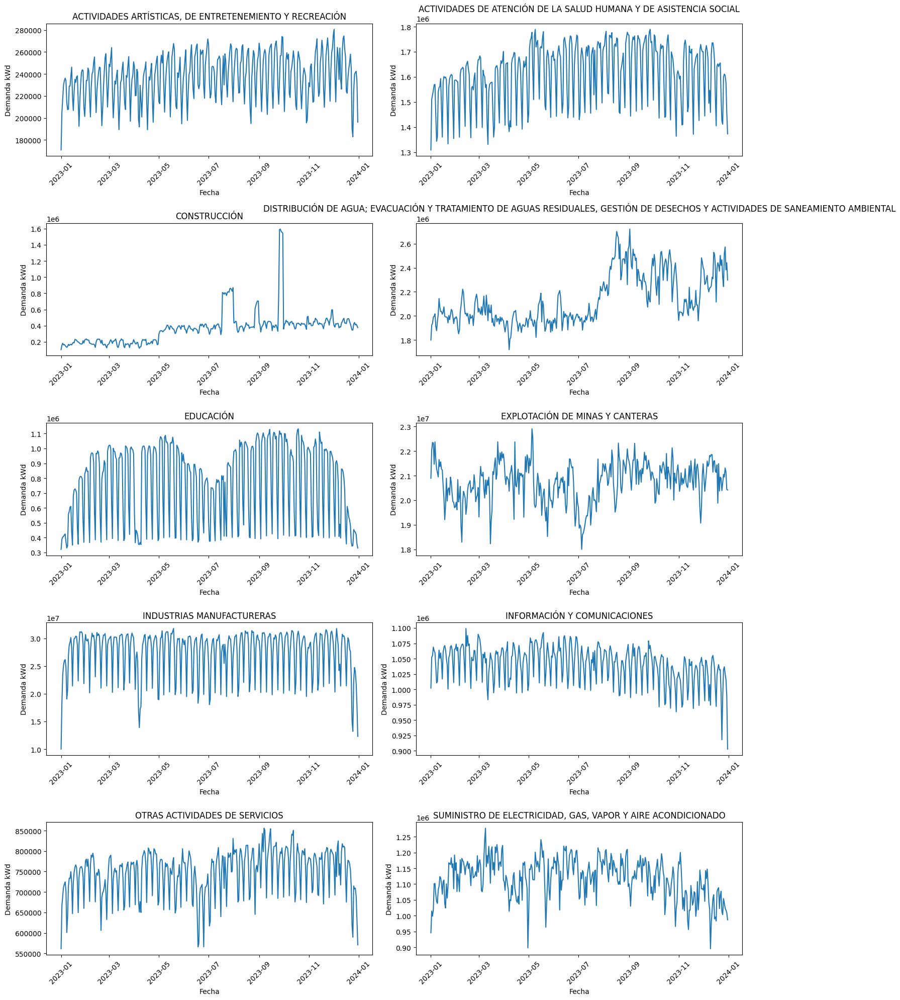

In [25]:
# Filtrar el dataframe para incluir solo el año 2023
df_demanda_2023 = df_demanda_se[df_demanda_se['Fecha'].dt.year == 2023]

# Agrupar por fecha y CIIU y sumar la demanda diaria
df_demanda_diaria_2023 = df_demanda_2023.groupby(['Fecha', 'CIIU'])['Demanda'].sum().reset_index()

# Filtrar las primeras 10 actividades económicas
top_10_ciiu_2023 = df_demanda_diaria_2023['CIIU'].value_counts().head(10).index
df_top_10_2023 = df_demanda_diaria_2023[df_demanda_diaria_2023['CIIU'].isin(top_10_ciiu_2023)]

# Pivotear la tabla para obtener un formato adecuado para el gráfico
pivot_df_2023 = df_top_10_2023.pivot(index='Fecha', columns='CIIU', values='Demanda')

# Crear la figura y los ejes
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
axes = axes.flatten()

# Graficar cada CIIU en un subplot
for i, ciu in enumerate(pivot_df_2023.columns):
    axes[i].plot(pivot_df_2023.index, pivot_df_2023[ciu], label=ciu)
    axes[i].set_title(ciu)
    axes[i].set_xlabel("Fecha")
    axes[i].set_ylabel("Demanda kWd")
    axes[i].tick_params(axis='x', rotation=45)

# Ajustar el layout
plt.tight_layout()
plt.show()

### 2024

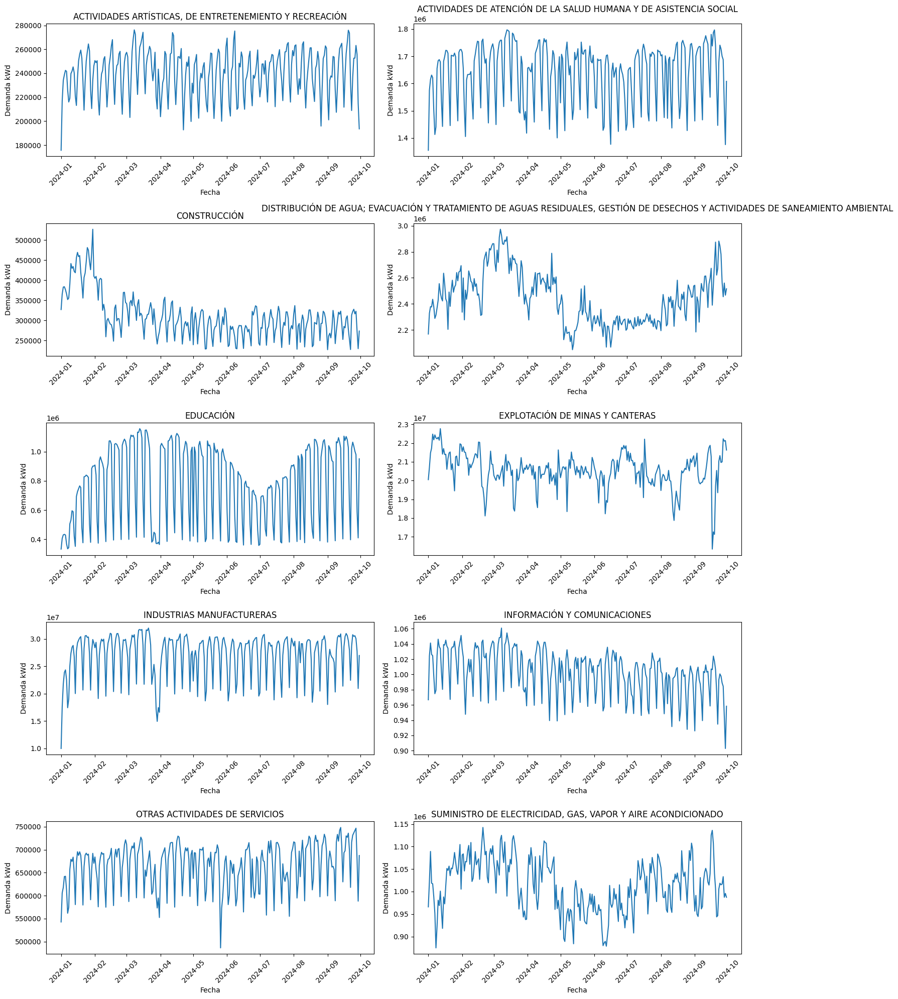

In [32]:
# Filtrar el dataframe para incluir solo el año 2024
df_demanda_2024 = df_demanda_se[df_demanda_se['Fecha'].dt.year == 2024]

# Agrupar por fecha y CIIU y sumar la demanda diaria
df_demanda_diaria_2024 = df_demanda_2024.groupby(['Fecha', 'CIIU'])['Demanda'].sum().reset_index()

# Filtrar las primeras 10 actividades económicas
top_10_ciiu_2024 = df_demanda_diaria_2024['CIIU'].value_counts().head(10).index
df_top_10_2024 = df_demanda_diaria_2024[df_demanda_diaria_2024['CIIU'].isin(top_10_ciiu_2024)]

# Pivotear la tabla para obtener un formato adecuado para el gráfico
pivot_df_2024 = df_top_10_2024.pivot(index='Fecha', columns='CIIU', values='Demanda')

# Crear la figura y los ejes
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 20))
axes = axes.flatten()

# Graficar cada CIIU en un subplot
for i, ciu in enumerate(pivot_df_2024.columns):
    axes[i].plot(pivot_df_2024.index, pivot_df_2024[ciu], label=ciu)
    axes[i].set_title(ciu)
    axes[i].set_xlabel("Fecha")
    axes[i].set_ylabel("Demanda kWd")
    axes[i].tick_params(axis='x', rotation=45)

# Ajustar el layout
plt.tight_layout()
plt.show()

## Demanda por Mercado de Comercialización  

In [33]:
df_demanda = pd.read_csv('./data_vieja/demanda_region.csv')

# Convertir a formato fecha
df_demanda['Date'] = pd.to_datetime(df_demanda['Date'])

# Filtrar por las fechas menor a 2024-10-01
df_demanda = df_demanda[df_demanda['Date'] < '2024-10-01']

In [4]:
df_demanda.head()

,Id,Values_code,Values_MarketType,Values_Hour01,Values_Hour02,Values_Hour03,Values_Hour04,Values_Hour05,Values_Hour06,Values_Hour07,...,Values_Hour16,Values_Hour17,Values_Hour18,Values_Hour19,Values_Hour20,Values_Hour21,Values_Hour22,Values_Hour23,Values_Hour24,Date
0,MercadoComercializacion,ANTIOQUIA,NO REGULADO,378191.79,373207.07,372796.25,373527.31,376376.99,385734.23,386971.59,...,414838.00,406570.22,391076.18,417662.11,411696.53,406289.62,393638.33,388427.85,378522.26,2024-09-12
1,MercadoComercializacion,ANTIOQUIA,REGULADO,725389.36,681233.57,660791.60,658666.64,706184.61,810299.14,909185.15,...,1160069.85,1141277.05,1095130.62,1146601.17,1148282.87,1098187.74,1007957.35,887890.37,778934.78,2024-09-12
2,MercadoComercializacion,ARAUCA,NO REGULADO,46481.52,45643.30,44646.32,43577.26,43553.70,51110.66,53721.40,...,70169.68,71416.78,70698.09,71122.14,70089.10,68689.24,66813.83,64849.63,64314.07,2024-09-12
3,MercadoComercializacion,ARAUCA,REGULADO,40245.18,38449.11,37372.19,36180.10,35018.85,33850.17,33189.69,...,47102.99,45685.88,43530.01,47227.19,47305.63,46531.25,45511.11,42814.98,39077.55,2024-09-12
4,MercadoComercializacion,BAJO PUTUMAYO,NO REGULADO,129.80,121.47,112.68,116.13,114.00,124.43,155.99,...,293.84,278.26,250.46,213.31,194.01,179.13,184.56,164.10,162.20,2024-09-12


In [34]:
df_demanda.columns

Index(['Id', 'Values_code', 'Values_MarketType', 'Values_Hour01',
       'Values_Hour02', 'Values_Hour03', 'Values_Hour04', 'Values_Hour05',
       'Values_Hour06', 'Values_Hour07', 'Values_Hour08', 'Values_Hour09',
       'Values_Hour10', 'Values_Hour11', 'Values_Hour12', 'Values_Hour13',
       'Values_Hour14', 'Values_Hour15', 'Values_Hour16', 'Values_Hour17',
       'Values_Hour18', 'Values_Hour19', 'Values_Hour20', 'Values_Hour21',
       'Values_Hour22', 'Values_Hour23', 'Values_Hour24', 'Date'],
      dtype='object')

- **Id**: Identificador único de cada registro.
- **Values_code**: Código que representa el mercado de comercialización de la energía.
- **Values_MarketType**: Tipo de mercado de comercialización de la energía (Regulado o No Regulado)
- **Values_Hour01 a Values_Hour24**: Demanda de energía en kWh registrada por cada hora del día, desde la hora 01 hasta la 24.
- **Date**: Fecha en la que se registra la demanda de energía.

In [35]:
# Sumar nulos por columna
df_demanda.isnull().sum()

Id                     0
Values_code            0
Values_MarketType      0
Values_Hour01        265
Values_Hour02        200
Values_Hour03        203
Values_Hour04        204
Values_Hour05        205
Values_Hour06        212
Values_Hour07        231
Values_Hour08        237
Values_Hour09        236
Values_Hour10        237
Values_Hour11        245
Values_Hour12        258
Values_Hour13        248
Values_Hour14        239
Values_Hour15        226
Values_Hour16        220
Values_Hour17        212
Values_Hour18        212
Values_Hour19        187
Values_Hour20        191
Values_Hour21        194
Values_Hour22        195
Values_Hour23        196
Values_Hour24        267
Date                   0
dtype: int64

Se observa que algunas columnas de hora tienen valores nulos, lo cual se debe a que no se registró demanda de energía para esa hora de ese mercado de comercialización. En este caso, se reemplazan los valores nulos por cero.

In [36]:
# Reemplazar nulos por 0
df_demanda.fillna(0, inplace=True)

Para facilitar el análisis, se agrupa la información por día sumando la demanda de cada hora. Se eligen las columnas a utilizar y se renombran para facilitar su manipulación.

In [37]:
horas = [f'Values_Hour{i:02d}' for i in range(1, 25)]
df_demanda['Total'] = df_demanda[horas].sum(axis=1)

In [39]:
df_demanda = df_demanda[['Values_code', 'Values_MarketType', 'Date', 'Total']]      

In [41]:
df_demanda.columns = ['Region', 'Mercado', 'Fecha', 'Demanda']

In [42]:
# Convertir a formato fecha
df_demanda['Fecha'] = pd.to_datetime(df_demanda['Fecha'])

In [43]:
df_demanda.describe()

,Fecha,Demanda
count,77083,7.708300e+04
mean,2022-11-13 18:47:21.124502272,3.772300e+06
min,2021-01-01 00:00:00,1.000000e-02
25%,2021-12-06 00:00:00,1.986582e+05
50%,2022-11-12 00:00:00,1.304753e+06
75%,2023-10-22 00:00:00,3.777916e+06
max,2024-09-30 00:00:00,3.446504e+07
std,NaN,6.317027e+06


- Rango Temporal: Los datos abarcan desde el 1 de enero de 2021 hasta el 30 de septiembre de 2024, cubriendo un período de casi cuatro años.
- Promedio y Mediana: La demanda promedio es de 3,772,300 kWh, mientras que la mediana es de 1,304,753 kWh, lo que sugiere una distribución sesgada hacia valores altos.
- Percentiles: El 50% de los valores de demanda están entre 198,658.2 kWh y 3,777,916 kWh.
- Demanda Máxima: Un valor máximo de 34,465,040 kWh indica algunos días de demanda excepcionalmente alta.
- Variabilidad: La desviación estándar de 6,317,027 kWh refleja una alta variabilidad en el consumo de energía diario.

In [44]:
df_demanda['Region'].unique()

array(['ANTIOQUIA', 'ARAUCA', 'BAJO PUTUMAYO', 'BOGOTA - CUNDINAMARCA',
       'BOYACA', 'CALDAS', 'CALI - YUMBO - PUERTO TEJADA', 'CAQUETA',
       'CARIBE MAR', 'CARIBE SOL', 'CARTAGO', 'CASANARE', 'CAUCA',
       'CHOCO', 'GUAVIARE', 'HUILA', 'META', 'NARIÑO',
       'NORTE DE SANTANDER', 'PEREIRA', 'POPAYAN - PURACE', 'PUTUMAYO',
       'QUINDIO', 'RUITOQUE', 'SANTANDER', 'TOLIMA', 'TULUA',
       'VALLE DEL CAUCA', 'VALLE DEL SIBUNDOY', 'SIN CLASIFICAR'],
      dtype=object)

In [45]:
# Estadisticas de la demanda por región
estadisticas_por_region = df_demanda.groupby('Region')['Demanda'].describe()

In [46]:
estadisticas_por_region

,count,mean,std,min,25%,50%,75%,max
Region,,,,,,,,
ANTIOQUIA,2738.0,1.466596e+07,6.278830e+06,4211178.00,8.887926e+06,1.291145e+07,2.098662e+07,24260817.81
ARAUCA,2738.0,1.376108e+06,6.422881e+05,156.05,8.211413e+05,9.870333e+05,2.166987e+06,2409498.74
BAJO PUTUMAYO,2641.0,1.207193e+05,1.141750e+05,0.01,4.468230e+03,1.867703e+05,2.300570e+05,297778.21
BOGOTA - CUNDINAMARCA,2738.0,2.199470e+07,9.128757e+06,6560707.21,1.364755e+07,1.869182e+07,3.168225e+07,34465036.33
BOYACA,2738.0,4.903730e+06,2.464890e+06,2008382.89,2.524782e+06,3.880747e+06,7.413527e+06,8703896.33
CALDAS,2738.0,2.382674e+06,5.654119e+05,595215.47,1.897702e+06,2.357250e+06,2.908416e+06,3473857.87
CALI - YUMBO - PUERTO TEJADA,2738.0,5.745979e+06,1.655395e+06,1950889.47,4.477019e+06,5.269448e+06,7.276193e+06,9146975.39
CAQUETA,2738.0,4.204123e+05,4.063538e+05,3291.24,1.937670e+04,1.146521e+05,8.199817e+05,1107164.74
CARIBE MAR,2738.0,1.555729e+07,6.653152e+06,4992791.90,9.154848e+06,1.401185e+07,2.167282e+07,27034936.46


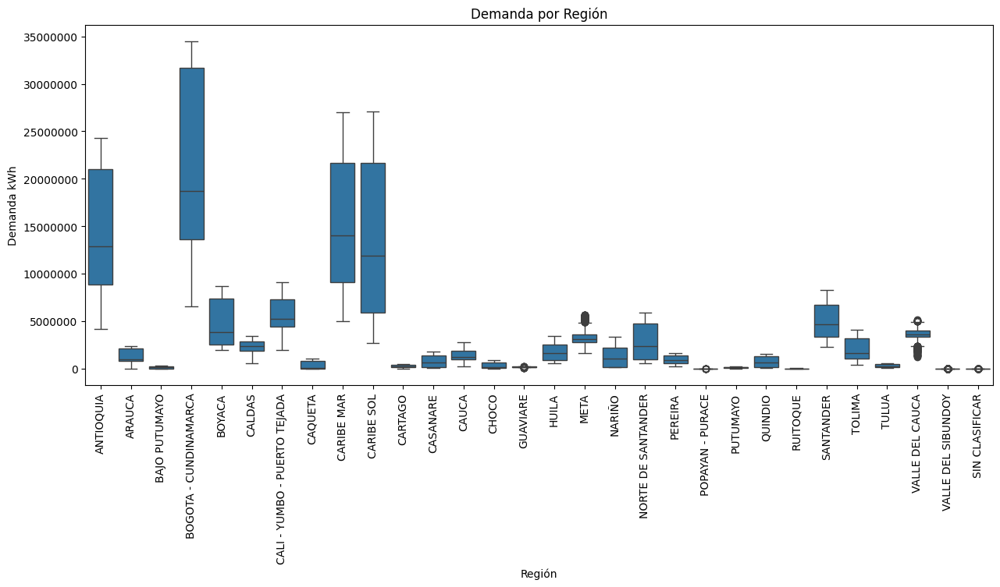

In [75]:
# Diagrama de caja de la demanda por región
plt.figure(figsize=(15, 6))
sns.boxplot(data=df_demanda, x='Region', y='Demanda')
plt.xlabel("Región")
plt.ylabel("Demanda kWh")
plt.title("Demanda por Región")
plt.ticklabel_format(axis="y", style="plain")
plt.xticks(rotation=90)

plt.show()

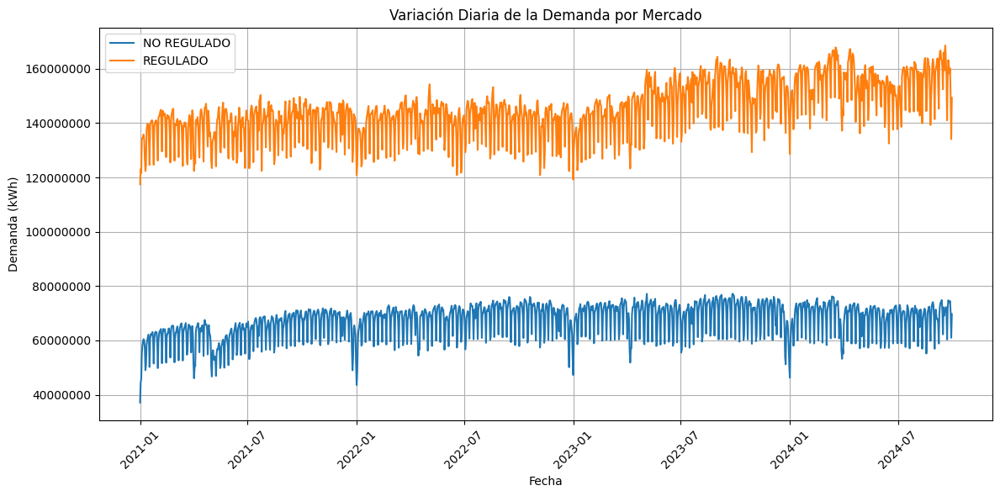

In [76]:
# Agrupar por fecha y tipo de mercado para obtener la suma de la demanda
daily_demand = df_demanda.groupby(['Fecha', 'Mercado'])['Demanda'].sum().reset_index()

# Graficar la variación diaria de la demanda para ambos mercados
plt.figure(figsize=(12, 6))
for mercado in daily_demand['Mercado'].unique():
    subset = daily_demand[daily_demand['Mercado'] == mercado]
    plt.plot(subset['Fecha'], subset['Demanda'], label=mercado)

plt.title('Variación Diaria de la Demanda por Mercado')
plt.xlabel('Fecha')
plt.ylabel('Demanda (kWh)')
plt.legend()
plt.grid()
plt.xticks(rotation=45)
plt.ticklabel_format(axis="y", style="plain")
plt.tight_layout()
plt.show()


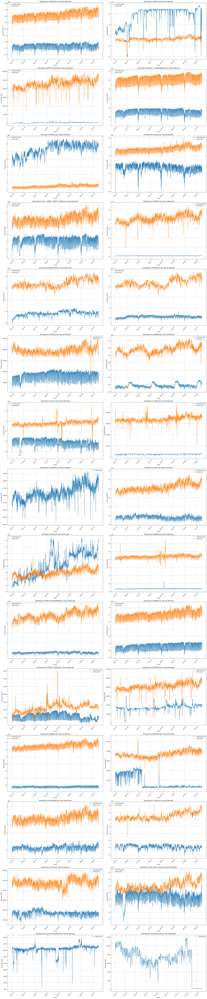

In [63]:
demanda_diaria = df_demanda.groupby(['Fecha', 'Mercado'])['Demanda'].sum().reset_index()

# Graficar por región en un grid de subgráficas
regiones = df_demanda['Region'].unique()
num_regiones = len(regiones)

# Crear un grid de subgráficas
fig, axes = plt.subplots(nrows=(num_regiones + 1) // 2, ncols=2, figsize=(25, 120))
axes = axes.flatten()  # Aplanar el array de ejes para un acceso más fácil

for i, region in enumerate(regiones):
    subset = df_demanda[df_demanda['Region'] == region]
    demanda_diaria_region = subset.groupby(['Fecha', 'Mercado'])['Demanda'].sum().reset_index()

    for mercado in demanda_diaria_region['Mercado'].unique():
        reg_subset = demanda_diaria_region[demanda_diaria_region['Mercado'] == mercado]
        axes[i].plot(reg_subset['Fecha'], reg_subset['Demanda'], label=mercado)

    axes[i].set_title(f'Demanda en {region} por Tipo de Mercado')
    axes[i].set_xlabel('Fecha')
    axes[i].set_ylabel('Demanda (kWh)')
    axes[i].legend()
    axes[i].grid()
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

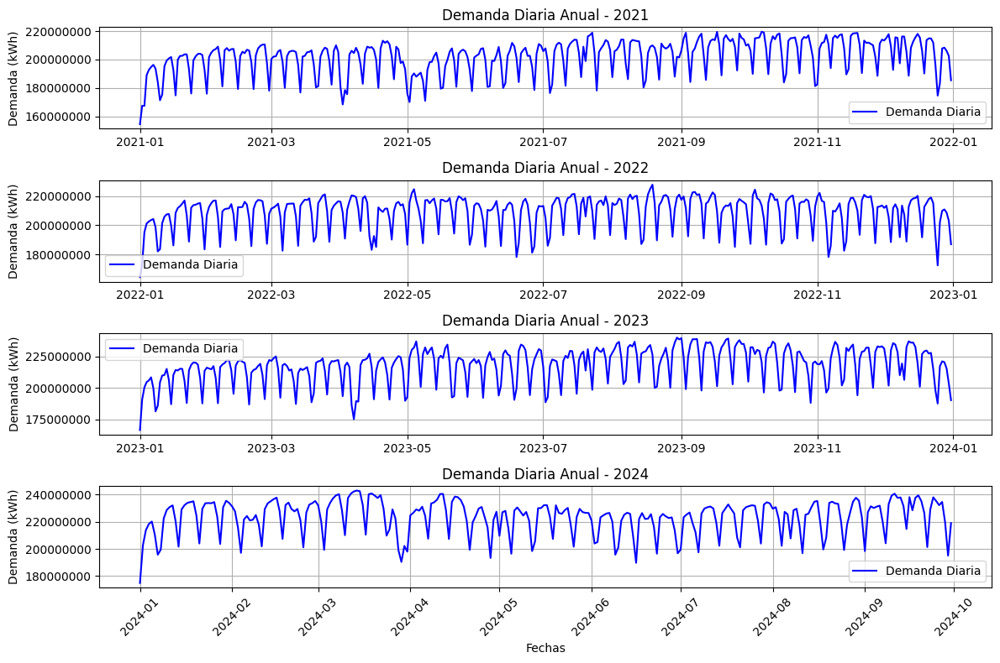

In [81]:
# Agrupar por fecha y año para obtener la demanda diaria
demanda_diaria_anual = df_demanda.groupby(['Fecha'])['Demanda'].sum().reset_index()

# Agregar una columna de año sin modificar el DataFrame original
demanda_diaria_anual['Año'] = demanda_diaria_anual['Fecha'].dt.year

# Obtener los años únicos en el DataFrame
anios = demanda_diaria_anual['Año'].unique()
num_anios = len(anios)

# Crear un grid de subgráficas
fig, axes = plt.subplots(nrows=num_anios, ncols=1, figsize=(12, 8))

for i, anio in enumerate(anios):
    subset = demanda_diaria_anual[demanda_diaria_anual['Año'] == anio]
    axes[i].plot(subset['Fecha'], subset['Demanda'], label='Demanda Diaria', color='blue')
    axes[i].set_title(f'Demanda Diaria Anual - {anio}')
    axes[i].set_ylabel('Demanda (kWh)')
    axes[i].legend()
    axes[i].grid()
    axes[i].ticklabel_format(axis="y", style="plain")
    
plt.xticks(rotation=45)
plt.xlabel('Fechas')
plt.tight_layout()
plt.show()

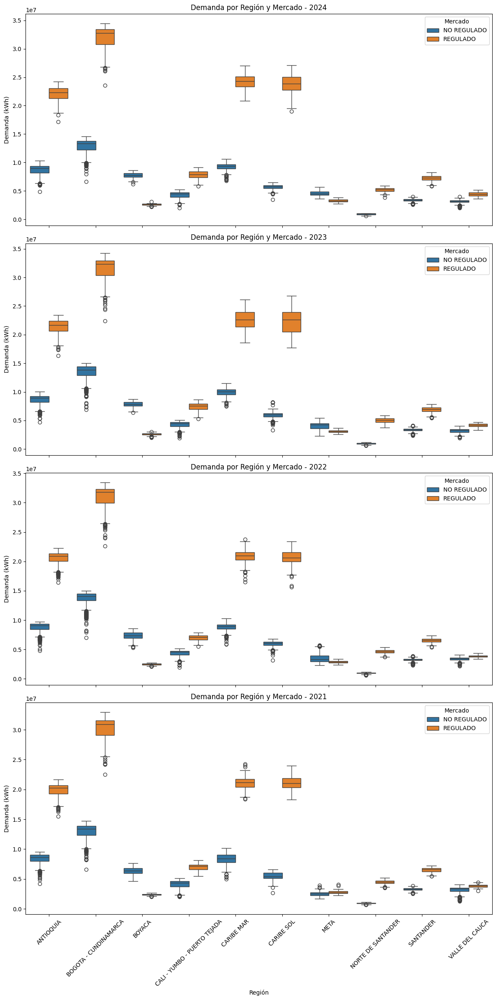

In [65]:
# Filtrar el top 10 de regiones por demanda total
top_10_regiones = df_demanda.groupby('Region')['Demanda'].sum().nlargest(10).index
df_top_10 = df_demanda[df_demanda['Region'].isin(top_10_regiones)]

# Obtener los años únicos a partir de la columna 'Fecha'
anios = df_top_10['Fecha'].dt.year.unique()
num_anios = len(anios)

# Crear un grid de subgráficas para cada año
fig, axes = plt.subplots(nrows=num_anios, ncols=1, figsize=(12, 6 * num_anios), sharex=True)

for i, anio in enumerate(anios):
    # Filtrar datos para el año actual sin modificar el DataFrame original
    subset = df_top_10[df_top_10['Fecha'].dt.year == anio]
    
    # Crear boxplot en la subgráfica actual
    sns.boxplot(ax=axes[i], data=subset, x='Region', y='Demanda', hue='Mercado')
    
    axes[i].set_title(f'Demanda por Región y Mercado - {anio}')
    axes[i].set_ylabel('Demanda (kWh)')
    axes[i].set_xlabel('Región')
    axes[i].tick_params(axis='x', rotation=45)
    axes[i].legend(title='Mercado')

plt.tight_layout()
plt.show()



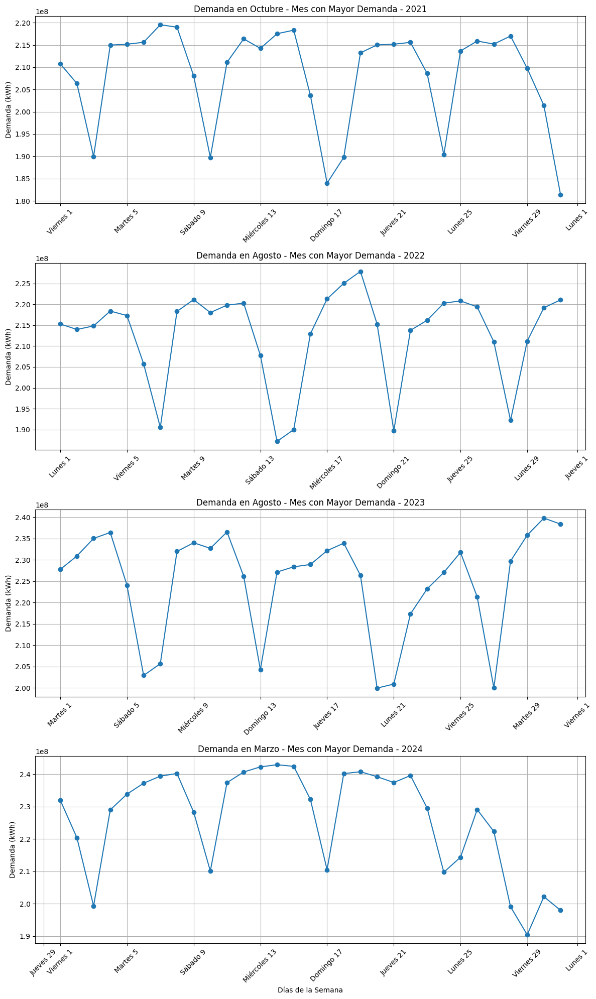

In [100]:
demanda_diaria_anual = df_demanda.groupby(['Fecha'])['Demanda'].sum().reset_index()

demanda_diaria_anual['Año'] = demanda_diaria_anual['Fecha'].dt.year
demanda_diaria_anual['Mes'] = demanda_diaria_anual['Fecha'].dt.month

mes_mayor_demanda = demanda_diaria_anual.groupby(['Año', 'Mes'])['Demanda'].sum().reset_index()
mes_max_dia = mes_mayor_demanda.loc[mes_mayor_demanda.groupby('Año')['Demanda'].idxmax()]

demanda_mes_max = demanda_diaria_anual[demanda_diaria_anual.set_index(['Año', 'Mes']).index.isin(
    mes_max_dia.set_index(['Año', 'Mes']).index
)]

num_anios = demanda_mes_max['Año'].nunique()
fig, axes = plt.subplots(nrows=num_anios, ncols=1, figsize=(12, 20))

# Lista de días en español
dias_espanol = ['Lunes', 'Martes', 'Miércoles', 'Jueves', 'Viernes', 'Sábado', 'Domingo']
meses_espanol = ['Enero', 'Febrero', 'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre', 'Octubre', 'Noviembre', 'Diciembre']

for i, anio in enumerate(demanda_mes_max['Año'].unique()):
    subset = demanda_mes_max[demanda_mes_max['Año'] == anio]
    
    primer_dia_mes = subset['Fecha'].min()
    ultimo_dia_mes = subset['Fecha'].max()
    subset_dias = demanda_diaria_anual[(demanda_diaria_anual['Fecha'] >= primer_dia_mes) & 
                                        (demanda_diaria_anual['Fecha'] <= ultimo_dia_mes)]
    
    axes[i].plot(subset_dias['Fecha'], subset_dias['Demanda'], marker='o', label=f'Año {anio}', color='tab:blue')
    
    # Obtener el nombre del mes en español
    mes = subset['Mes'].unique()[0]
    axes[i].set_title(f'Demanda en {meses_espanol[mes-1]} - Mes con Mayor Demanda - {anio}')
    axes[i].set_ylabel('Demanda (kWh)')
    axes[i].grid()
    
    axes[i].xaxis.set_major_locator(mdates.AutoDateLocator())
    axes[i].xaxis.set_major_formatter(mdates.DateFormatter('%A %d'))

    
    ticks = axes[i].get_xticks()
    new_labels = [f"{dias_espanol[int(mdates.num2date(tick).weekday())]} {mdates.num2date(tick).day}" for tick in ticks]
    axes[i].set_xticks(ticks) 
    axes[i].set_xticklabels(new_labels) 

    axes[i].tick_params(axis='x', rotation=45)

plt.xlabel('Días de la Semana')
plt.tight_layout()
plt.show()

## Información de festivos en Colombia

Con el fin de analizar la demanda de energía en Colombia, se incluye información sobre los festivos en el país. El conjunto de datos contiene las siguientes columnas:

- **Fecha**: Fecha de día.
- **Clasificación**: Clasificación del día (Festivo, No Festivo, Sábado, Domingo).

In [117]:
# Función para obtener los días festivos desde Nager.Date API
def obtener_festivos(colombia, anio):
    url = f"https://date.nager.at/api/v3/publicholidays/{anio}/{colombia}"
    
    response = requests.get(url)
    if response.status_code == 200:
        festivos = response.json()
        # Extraer solo las fechas de los festivos
        return [festivo['date'] for festivo in festivos]
    else:
        print(f"Error al obtener festivos para el año {anio}, código de estado {response.status_code}")
        return []

# Crear un rango de fechas desde 2021 hasta septiembre de 2024
fecha_inicio = datetime(2021, 1, 1)
fecha_fin = datetime(2024, 9, 30)

# Crear una lista con todas las fechas en ese rango
fechas = pd.date_range(start=fecha_inicio, end=fecha_fin)

# Obtener los días festivos para cada año de 2021 a 2024
festivos_colombia = []
for anio in range(2021, 2025):
    festivos_colombia.extend(obtener_festivos('CO', anio))

# Convertir las fechas de festivos a formato datetime
festivos_colombia = [datetime.strptime(festivo, "%Y-%m-%d").date() for festivo in festivos_colombia]

# Función para clasificar los días
def clasificar_dia(fecha):
    if fecha in festivos_colombia:
        return 'Festivo'
    elif fecha.weekday() == 5:
        return 'Sábado'
    elif fecha.weekday() == 6:
        return 'Domingo'
    else:
        return 'No Festivo'

# Crear un DataFrame con las fechas y la clasificación
datos = pd.DataFrame({'Fecha': fechas})
datos['Clasificacion'] = datos['Fecha'].apply(lambda x: clasificar_dia(x.date()))

# Guardar la lista en un archivo CSV
datos.to_csv("./data/dias_colombia_2021_2024.csv", index=False)

In [121]:
df_dias = pd.read_csv('./data/dias_colombia_2021_2024.csv')

In [124]:
# Convertir a formato fecha
df_dias['Fecha'] = pd.to_datetime(df_dias['Fecha'])

df_demanda_dias = pd.merge(df_demanda, df_dias, on='Fecha', how='left')

In [132]:
estadisticas_demanda = df_demanda_dias.groupby('Clasificacion')['Demanda'].describe()

In [133]:
estadisticas_demanda

,count,mean,std,min,25%,50%,75%,max
Clasificacion,,,,,,,,
Domingo,10809.0,3.392900e+06,5.713647e+06,0.03,170029.50,1201426.320,3401443.860,28743031.45
Festivo,3773.0,3.391119e+06,5.725493e+06,18.52,176848.33,1209636.000,3414461.100,29799456.73
No Festivo,51749.0,3.888090e+06,6.494676e+06,0.01,203658.72,1346573.220,3912865.620,34465036.33
Sábado,10752.0,3.730181e+06,6.204490e+06,0.02,191914.94,1306777.375,3841071.585,32066985.56


## Interpretación de las Estadísticas

1. **Count (Número de Observaciones)**:
   - **No Festivo** tiene el mayor número de observaciones (51,749), seguido por **Domingo** (10,809) y **Sábado** (10,752). **Festivo** cuenta con 3,773 observaciones.

2. **Mean (Promedio)**:
   - La demanda promedio es más alta en **No Festivo** (3,888,090.00 kWh), seguido por **Sábado** (3,730,181.00 kWh) y **Domingo** (3,392,900.00 kWh). La demanda promedio de los **Festivos** es similar a la de los domingos.

3. **Std (Desviación Estándar)**:
   - La desviación estándar es más alta para los días **No Festivos** (6,494,676.00), lo que indica una mayor variabilidad en la demanda en comparación con otros tipos de días. Los días **Domingo** y **Festivo** tienen desviaciones estándar similares.

4. **Min (Mínimo)** y **Max (Máximo)**:
   - La demanda mínima es muy baja en todos los tipos de clasificación, especialmente en **No Festivo** (0.01 kWh) y **Domingo** (0.03 kWh). En contraste, la demanda máxima varía significativamente, siendo más alta en **No Festivo** (34,465,036.33 kWh).

5. **Percentiles (25%, 50%, 75%)**:
   - El percentil 25 (25% de los datos) muestra que, en días **No Festivos**, la demanda está por encima de 203,658.72 kWh, mientras que para los **Domingos**, es de 170,029.50 kWh.
   - La mediana (50%) es de 1,346,573.22 kWh para **No Festivo**, lo que indica que la mitad de los días tiene una demanda superior a esta cifra.

In [125]:
df_demanda_dias.head()

,Region,Mercado,Fecha,Demanda,Clasificacion
0,ANTIOQUIA,NO REGULADO,2024-09-12,9569174.95,No Festivo
1,ANTIOQUIA,REGULADO,2024-09-12,23479582.01,No Festivo
2,ARAUCA,NO REGULADO,2024-09-12,1434893.73,No Festivo
3,ARAUCA,REGULADO,2024-09-12,995598.78,No Festivo
4,BAJO PUTUMAYO,NO REGULADO,2024-09-12,4800.20,No Festivo


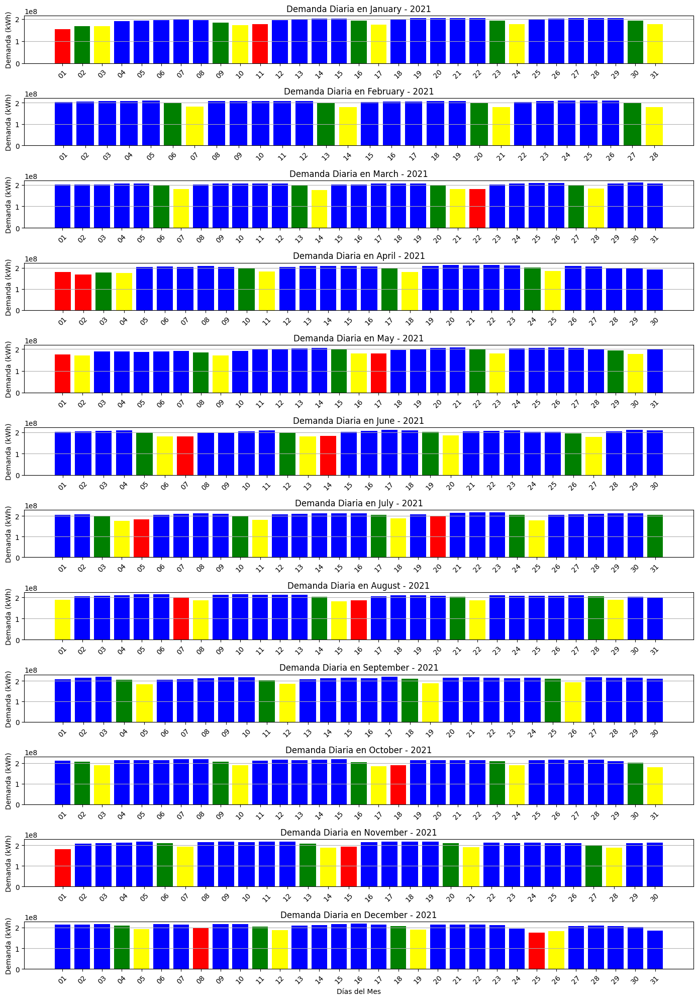

In [135]:
# Filtrar el DataFrame para el año 2021
df_2021 = df_demanda_dias[df_demanda_dias['Fecha'].dt.year == 2021]

demanda_diaria = df_2021.groupby(['Fecha', 'Clasificacion'])['Demanda'].sum().reset_index()

def asignar_color(row):
    if row['Clasificacion'] == 'Festivo':
        return 'red'
    elif row['Fecha'].weekday() == 5: 
        return 'green'
    elif row['Fecha'].weekday() == 6:  
        return 'yellow'
    else:
        return 'blue'

demanda_diaria['Color'] = demanda_diaria.apply(asignar_color, axis=1)

# Crear subplots para cada mes
meses = demanda_diaria['Fecha'].dt.month.unique()
fig, axes = plt.subplots(nrows=len(meses), ncols=1, figsize=(14, 20))

for i, mes in enumerate(sorted(meses)):
    subset = demanda_diaria[demanda_diaria['Fecha'].dt.month == mes]
    
    axes[i].bar(subset['Fecha'], subset['Demanda'], color=subset['Color'])
    axes[i].set_title(f'Demanda Diaria en {subset["Fecha"].dt.month_name().iloc[0]} - 2021')
    axes[i].set_ylabel('Demanda (kWh)')
    axes[i].set_xticks(subset['Fecha'])
    axes[i].set_xticklabels([fecha.strftime('%d') for fecha in subset['Fecha']], rotation=45)
    axes[i].grid(axis='y')

plt.xlabel('Días del Mes')
plt.tight_layout()
plt.show()

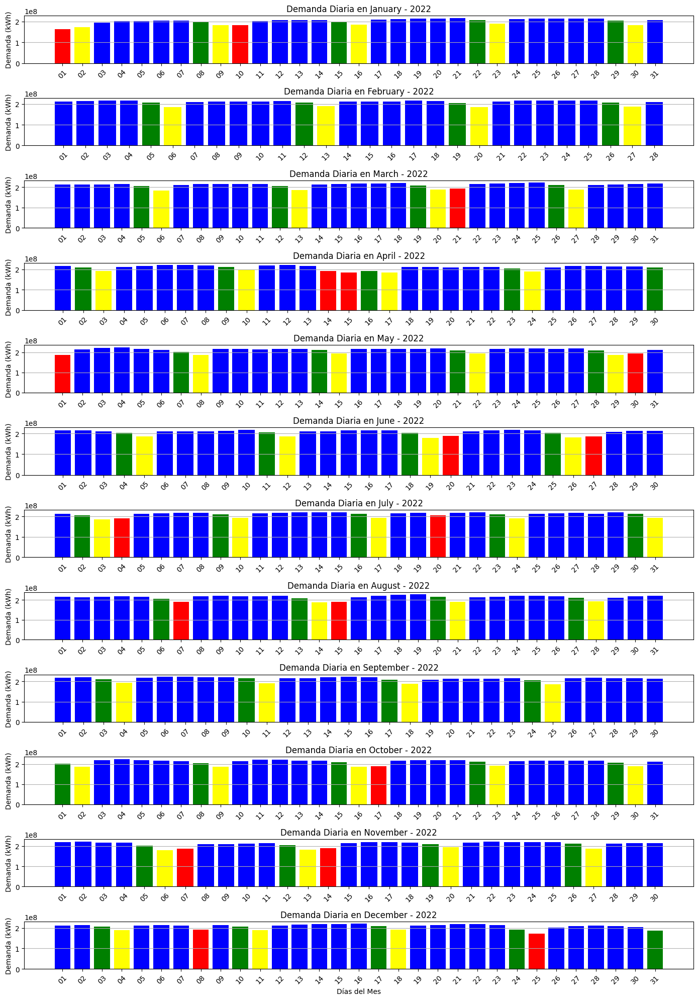

In [134]:

df_2022 = df_demanda_dias[df_demanda_dias['Fecha'].dt.year == 2022]

demanda_diaria_2022 = df_2022.groupby(['Fecha', 'Clasificacion'])['Demanda'].sum().reset_index()

# Crear una nueva columna para el color de las barras
def asignar_color(row):
    if row['Clasificacion'] == 'Festivo':
        return 'red'
    elif row['Fecha'].weekday() == 5: 
        return 'green'
    elif row['Fecha'].weekday() == 6: 
        return 'yellow'
    else:
        return 'blue'

demanda_diaria_2022['Color'] = demanda_diaria_2022.apply(asignar_color, axis=1)

# Crear subplots para cada mes
meses = demanda_diaria_2022['Fecha'].dt.month.unique()
fig, axes = plt.subplots(nrows=len(meses), ncols=1, figsize=(14, 20))

for i, mes in enumerate(sorted(meses)):
    subset = demanda_diaria_2022[demanda_diaria_2022['Fecha'].dt.month == mes]
    
    axes[i].bar(subset['Fecha'], subset['Demanda'], color=subset['Color'])
    axes[i].set_title(f'Demanda Diaria en {subset["Fecha"].dt.month_name().iloc[0]} - 2022')
    axes[i].set_ylabel('Demanda (kWh)')
    axes[i].set_xticks(subset['Fecha'])
    axes[i].set_xticklabels([fecha.strftime('%d') for fecha in subset['Fecha']], rotation=45)
    axes[i].grid(axis='y')

plt.xlabel('Días del Mes')
plt.tight_layout()
plt.show()

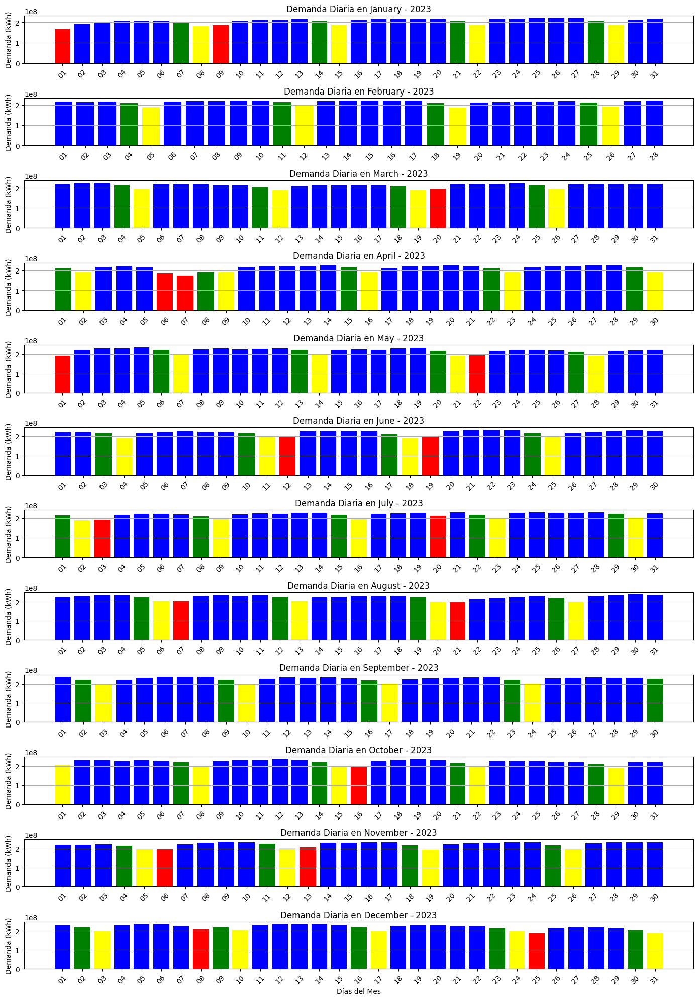

In [136]:
# Demanda diaria en 2023
df_2023 = df_demanda_dias[df_demanda_dias['Fecha'].dt.year == 2023]

demanda_diaria_2023 = df_2023.groupby(['Fecha', 'Clasificacion'])['Demanda'].sum().reset_index()

def asignar_color(row):
    if row['Clasificacion'] == 'Festivo':
        return 'red'
    elif row['Fecha'].weekday() == 5:  
        return 'green'
    elif row['Fecha'].weekday() == 6: 
        return 'yellow'
    else:
        return 'blue'

demanda_diaria_2023['Color'] = demanda_diaria_2023.apply(asignar_color, axis=1)

meses = demanda_diaria_2023['Fecha'].dt.month.unique()
fig, axes = plt.subplots(nrows=len(meses), ncols=1, figsize=(14, 20))

for i, mes in enumerate(sorted(meses)):
    subset = demanda_diaria_2023[demanda_diaria_2023['Fecha'].dt.month == mes]
    
    axes[i].bar(subset['Fecha'], subset['Demanda'], color=subset['Color'])
    axes[i].set_title(f'Demanda Diaria en {subset["Fecha"].dt.month_name().iloc[0]} - 2023')
    axes[i].set_ylabel('Demanda (kWh)')
    axes[i].set_xticks(subset['Fecha'])
    axes[i].set_xticklabels([fecha.strftime('%d') for fecha in subset['Fecha']], rotation=45)
    axes[i].grid(axis='y')

plt.xlabel('Días del Mes')
plt.tight_layout()
plt.show()

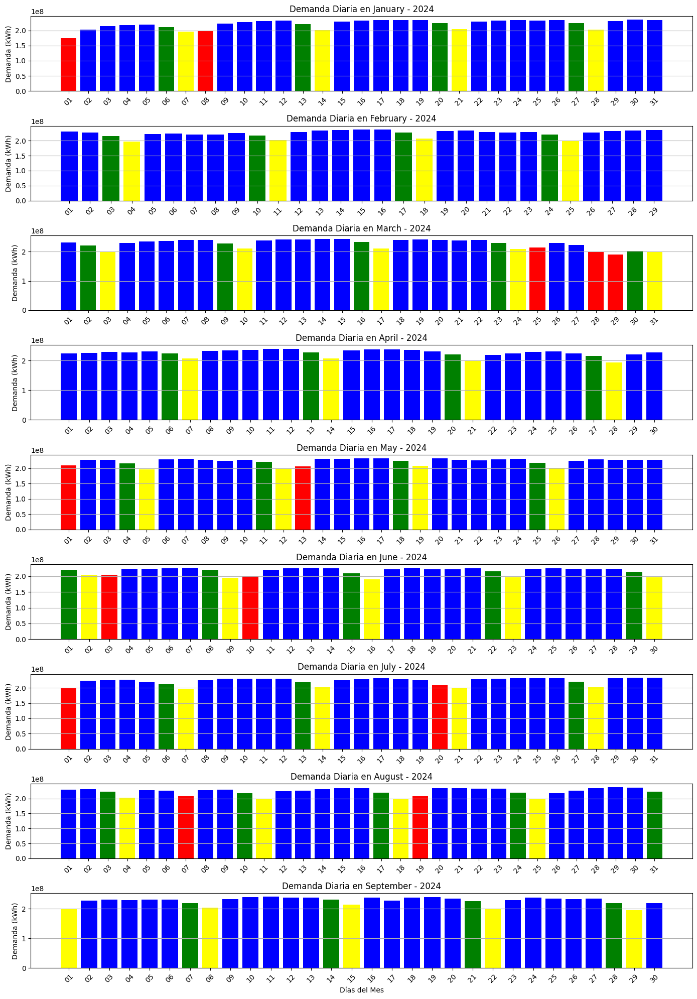

In [138]:
# Filtrar el DataFrame para el año 2024
df_2024 = df_demanda_dias[df_demanda_dias['Fecha'].dt.year == 2024]

# Agrupar por fecha y sumar la demanda
demanda_diaria_2024 = df_2024.groupby(['Fecha', 'Clasificacion'])['Demanda'].sum().reset_index()

def asignar_color(row):
    if row['Clasificacion'] == 'Festivo':
        return 'red'
    elif row['Fecha'].weekday() == 5:  
        return 'green'
    elif row['Fecha'].weekday() == 6:
        return 'yellow'
    else:
        return 'blue'

demanda_diaria_2024['Color'] = demanda_diaria_2024.apply(asignar_color, axis=1)

meses = demanda_diaria_2024['Fecha'].dt.month.unique()
fig, axes = plt.subplots(nrows=len(meses), ncols=1, figsize=(14, 20))

for i, mes in enumerate(sorted(meses)):
    subset = demanda_diaria_2024[demanda_diaria_2024['Fecha'].dt.month == mes]
    
    axes[i].bar(subset['Fecha'], subset['Demanda'], color=subset['Color'])
    axes[i].set_title(f'Demanda Diaria en {subset["Fecha"].dt.month_name().iloc[0]} - 2024')
    axes[i].set_ylabel('Demanda (kWh)')
    axes[i].set_xticks(subset['Fecha'])
    axes[i].set_xticklabels([fecha.strftime('%d') for fecha in subset['Fecha']], rotation=45)
    axes[i].grid(axis='y')

plt.xlabel('Días del Mes')
plt.tight_layout()
plt.show()

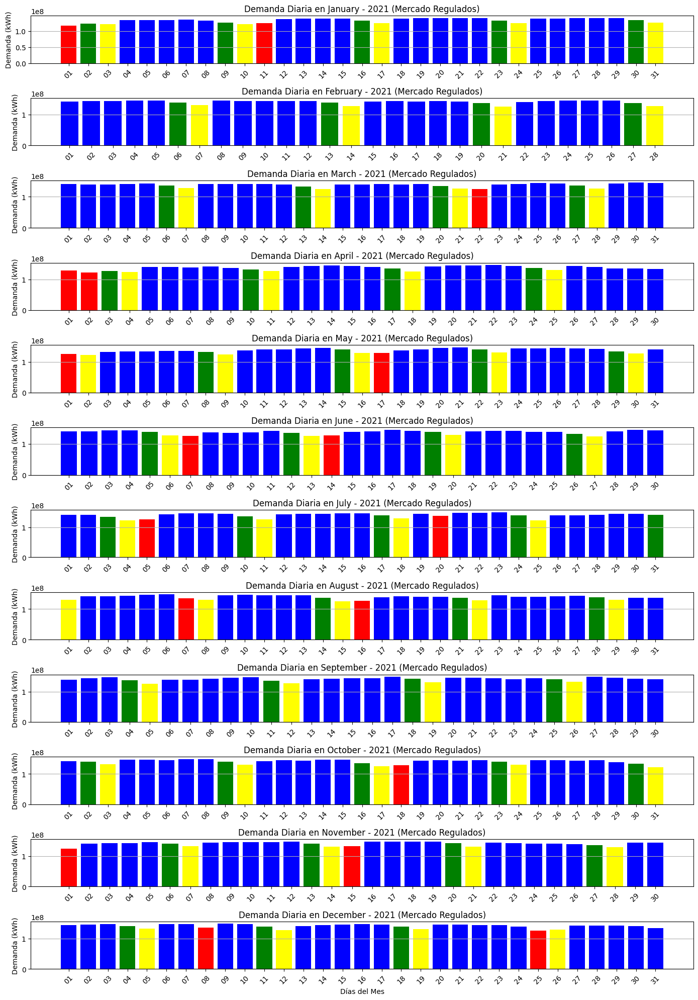

In [142]:
# Filtrar el DataFrame para el año 2021 y solo el mercado regulado
df_2021_regulado = df_demanda_dias[(df_demanda_dias['Fecha'].dt.year == 2021) & (df_demanda_dias['Mercado'] == 'REGULADO')]

demanda_diaria = df_2021_regulado.groupby(['Fecha', 'Clasificacion'])['Demanda'].sum().reset_index()

def asignar_color(row):
    if row['Clasificacion'] == 'Festivo':
        return 'red'
    elif row['Fecha'].weekday() == 5: 
        return 'green'
    elif row['Fecha'].weekday() == 6:  
        return 'yellow'
    else:
        return 'blue'

demanda_diaria['Color'] = demanda_diaria.apply(asignar_color, axis=1)

# Crear subplots para cada mes
meses = demanda_diaria['Fecha'].dt.month.unique()
fig, axes = plt.subplots(nrows=len(meses), ncols=1, figsize=(14, 20))

for i, mes in enumerate(sorted(meses)):
    subset = demanda_diaria[demanda_diaria['Fecha'].dt.month == mes]
    
    axes[i].bar(subset['Fecha'], subset['Demanda'], color=subset['Color'])
    axes[i].set_title(f'Demanda Diaria en {subset["Fecha"].dt.month_name().iloc[0]} - 2021 (Mercado Regulados)')
    axes[i].set_ylabel('Demanda (kWh)')
    axes[i].set_xticks(subset['Fecha'])
    axes[i].set_xticklabels([fecha.strftime('%d') for fecha in subset['Fecha']], rotation=45)
    axes[i].grid(axis='y')

plt.xlabel('Días del Mes')
plt.tight_layout()
plt.show()

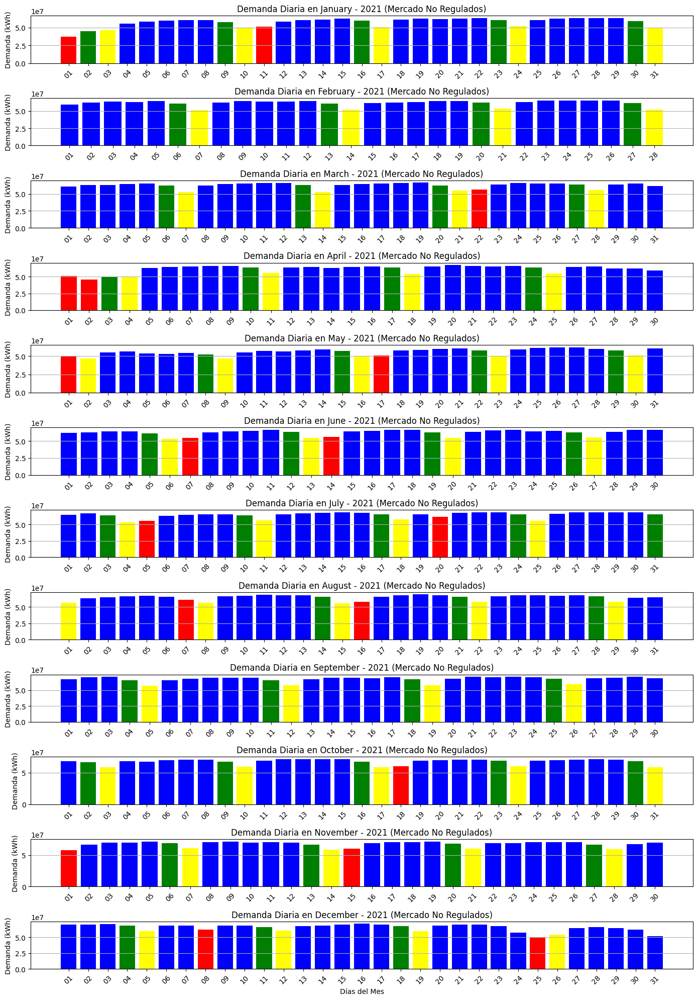

In [144]:
# Filtrar el DataFrame para el año 2021 y solo el mercado no regulado
df_2021_no_regulado = df_demanda_dias[(df_demanda_dias['Fecha'].dt.year == 2021) & (df_demanda_dias['Mercado'] != 'REGULADO')]

demanda_diaria = df_2021_no_regulado.groupby(['Fecha', 'Clasificacion'])['Demanda'].sum().reset_index()

def asignar_color(row):
    if row['Clasificacion'] == 'Festivo':
        return 'red'
    elif row['Fecha'].weekday() == 5: 
        return 'green'
    elif row['Fecha'].weekday() == 6:  
        return 'yellow'
    else:
        return 'blue'

demanda_diaria['Color'] = demanda_diaria.apply(asignar_color, axis=1)

# Crear subplots para cada mes
meses = demanda_diaria['Fecha'].dt.month.unique()
fig, axes = plt.subplots(nrows=len(meses), ncols=1, figsize=(14, 20))

for i, mes in enumerate(sorted(meses)):
    subset = demanda_diaria[demanda_diaria['Fecha'].dt.month == mes]
    
    axes[i].bar(subset['Fecha'], subset['Demanda'], color=subset['Color'])
    axes[i].set_title(f'Demanda Diaria en {subset["Fecha"].dt.month_name().iloc[0]} - 2021 (Mercado No Regulados)')
    axes[i].set_ylabel('Demanda (kWh)')
    axes[i].set_xticks(subset['Fecha'])
    axes[i].set_xticklabels([fecha.strftime('%d') for fecha in subset['Fecha']], rotation=45)
    axes[i].grid(axis='y')

plt.xlabel('Días del Mes')
plt.tight_layout()
plt.show()

### Mapeo de regiones

Debido a que la información de demanda de energía se agrupa por regiones definidas por XM se decide hacer diccionarios que permitan mapear las regiones de las otras fuentes de datos con las regiones de XM.

In [202]:
# Diccionario de correspondencia entre ciudades y regiones
ciudad_a_region = {
    'BARRANQUILLA': 'CARIBE SOL',
    'BOGOTÁ, D.C.': 'BOGOTA - CUNDINAMARCA',
    'CALI': 'CALI - YUMBO - PUERTO TEJADA',
    'MEDELLÍN': 'ANTIOQUIA',
    'MANIZALES': 'CALDAS',
    'PASTO': 'NARIÑO',
    'BUCARAMANGA': 'SANTANDER',
    'PEREIRA': 'PEREIRA',
    'CÚCUTA': 'NORTE DE SANTANDER',
    'VILLAVICENCIO': 'META',
    'NEIVA': 'HUILA',
    'MONTERÍA': 'CARIBE SOL',
    'CARTAGENA DE INDIAS': 'CARIBE SOL',
    'TUNJA': 'BOYACA',
    'FLORENCIA': 'CAQUETA',
    'POPAYÁN': 'CAUCA',
    'VALLEDUPAR': 'CARIBE SOL',
    'RIOHACHA': 'CARIBE SOL',
    'SANTA MARTA': 'CARIBE MAR',
    'ARMENIA': 'QUINDIO',
    'SINCELEJO': 'CARIBE SOL',
    'IBAGUÉ': 'TOLIMA',
    'Otras areas urbanas': 'SIN CLASIFICAR'
}

In [203]:
# Diccionario de equivalencias entre las regiones
mapeo_regiones_poblacion = {
    'Antioquia': 'ANTIOQUIA',
    'Atlántico': 'CARIBE SOL',
    'Bogotá, D.C.': 'BOGOTA - CUNDINAMARCA',
    'Bogotá D.C.': 'BOGOTA - CUNDINAMARCA',
    'Bolívar': 'CARIBE SOL',
    'Boyacá': 'BOYACA',
    'Caldas': 'CALDAS',
    'Caquetá': 'CAQUETA',
    'Cauca': 'CAUCA',
    'Cesar': 'CARIBE SOL',
    'Córdoba': 'CARIBE MAR',
    'Cundinamarca': 'BOGOTA - CUNDINAMARCA',
    'Chocó': 'CHOCO',
    'Huila': 'HUILA',
    'La Guajira': 'CARIBE SOL',
    'Magdalena': 'CARIBE SOL',
    'Meta': 'META',
    'Nariño': 'NARIÑO',
    'Norte de Santander': 'NORTE DE SANTANDER',
    'Quindio': 'QUINDIO',
    'Quindío': 'QUINDIO',
    'Risaralda': 'PEREIRA',
    'Santander': 'SANTANDER',
    'Sucre': 'CARIBE SOL',
    'Tolima': 'TOLIMA',
    'Valle del Cauca': 'CALI - YUMBO - PUERTO TEJADA',  
    'San Andrés, Providencia y Santa Catalina (Archipiélago)': 'CARIBE SOL',
    'Arauca': 'ARAUCA',
    'Casanare': 'CASANARE',
    'Putumayo': 'BAJO PUTUMAYO',
    'Archipiélago de San Andrés': 'CARIBE SOL',
    'Amazonas': 'SIN CLASIFICAR',
    'Guainía': 'SIN CLASIFICAR',
    'Guaviare': 'GUAVIARE',
    'Vaupés': 'SIN CLASIFICAR',
    'Vichada': 'SIN CLASIFICAR'
}

### Predicción de población
Se utilizo una fuente del DANE para obtener la predicción de la población en Colombia para los años 2021 a 2024. 

In [236]:
df_poblacion = pd.read_excel('./data/prediccion_poblacion.xlsx')

In [237]:
#quitar las primeras 7 filas
df_poblacion = df_poblacion[7:]

#Reiniciar el índice
df_poblacion.reset_index(drop=True, inplace=True)

#Asingnar la primera fila como nombres de las columnas
df_poblacion.columns = df_poblacion.iloc[0]

#Eliminar las ultimas 3 filas
df_poblacion = df_poblacion[:-3]

#Eliminar la primera fila
df_poblacion = df_poblacion[1:]

In [238]:
# Contar nulos
df_poblacion.isnull().sum()

0
DP                 0
DPNOM              0
MPIO               0
DPMP               0
AÑO                0
ÁREA GEOGRÁFICA    0
Población          0
dtype: int64

In [239]:
df_poblacion.head()

,DP,DPNOM,MPIO,DPMP,AÑO,ÁREA GEOGRÁFICA,Población
1,05,Antioquia,05001,Medellín,2020,Cabecera Municipal,2476569
2,05,Antioquia,05001,Medellín,2020,Centros Poblados y Rural Disperso,43023
3,05,Antioquia,05001,Medellín,2020,Total,2519592
4,05,Antioquia,05001,Medellín,2021,Cabecera Municipal,2506656
5,05,Antioquia,05001,Medellín,2021,Centros Poblados y Rural Disperso,42352


In [240]:
df_poblacion.nunique()

0
DP                    33
DPNOM                 33
MPIO                1122
DPMP                1039
AÑO                   16
ÁREA GEOGRÁFICA        3
Población          27088
dtype: int64

In [241]:
df_poblacion.columns

Index(['DP', 'DPNOM', 'MPIO', 'DPMP', 'AÑO', 'ÁREA GEOGRÁFICA', 'Población'], dtype='object', name=0)

In [242]:
df_poblacion['DPNOM'].unique()

array(['Antioquia', 'Atlántico', 'Bogotá, D.C.', 'Bolívar', 'Boyacá',
       'Caldas', 'Caquetá', 'Cauca', 'Cesar', 'Córdoba', 'Cundinamarca',
       'Chocó', 'Huila', 'La Guajira', 'Magdalena', 'Meta', 'Nariño',
       'Norte de Santander', 'Quindio', 'Risaralda', 'Santander', 'Sucre',
       'Tolima', 'Valle del Cauca', 'Arauca', 'Casanare', 'Putumayo',
       'Archipiélago de San Andrés', 'Amazonas', 'Guainía', 'Guaviare',
       'Vaupés', 'Vichada'], dtype=object)

Para este análisis solo se utilizará el valor Total de la población por departamento.

In [243]:
# Utilizar las filas de ÁREA GEOGRÁFICA = Total
df_poblacion_total = df_poblacion[df_poblacion['ÁREA GEOGRÁFICA'] == 'Total']

# Incluir años 2021 a 2024
df_poblacion_total = df_poblacion_total[df_poblacion_total['AÑO'].between(2021, 2024)]


In [244]:
df_poblacion_total = df_poblacion_total.groupby(['DPNOM', 'AÑO'], as_index=False)['Población'].sum()

In [245]:
# Renombrar columnas
df_poblacion_total.columns = ['Region', 'Año', 'Poblacion']

In [246]:
# Convertir Region con la correspondencia
df_poblacion_total['Region'] = df_poblacion_total['Region'].map(mapeo_regiones_poblacion)

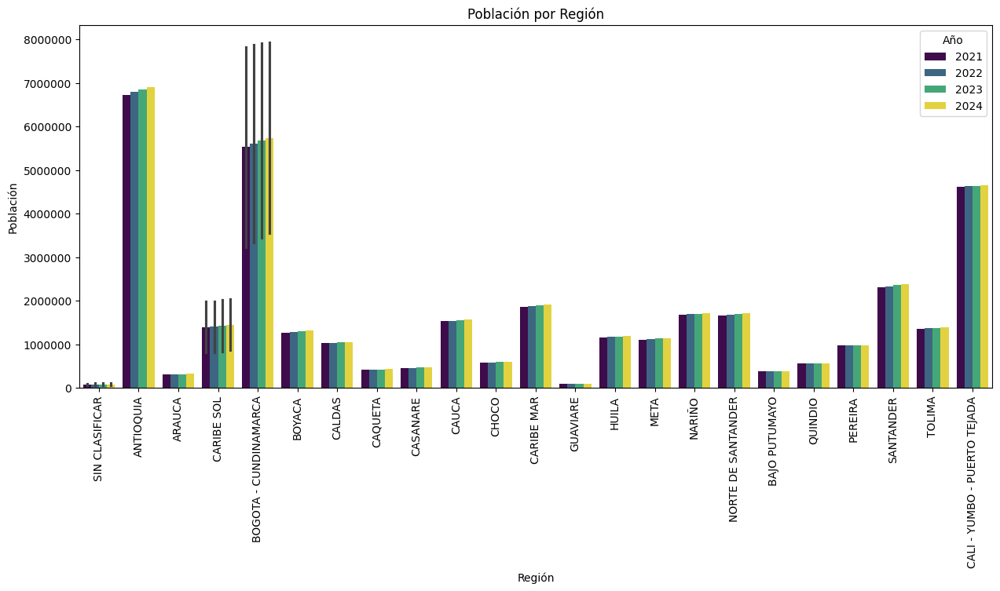

In [249]:
# Grafico de la población por región
plt.figure(figsize=(15, 6))
sns.barplot(data=df_poblacion_total, x='Region', y='Poblacion', hue='Año', palette='viridis')
plt.xlabel("Región")
plt.ylabel("Población")
plt.title("Población por Región")
plt.ticklabel_format(axis="y", style="plain")
plt.xticks(rotation=90)
plt.show()

In [250]:
# Estadisticas de la población por región
estadisticas_poblacion = df_poblacion_total.groupby('Region')['Poblacion'].describe()

In [254]:
# Convertir población a numérica
df_poblacion_total['Poblacion'] = pd.to_numeric(df_poblacion_total['Poblacion'], errors='coerce')

In [255]:
estadisticas_poblacion = df_poblacion_total.groupby('Region')['Poblacion'].describe()

In [256]:
estadisticas_poblacion

,count,mean,std,min,25%,50%,75%,max
Region,,,,,,,,
ANTIOQUIA,4.0,6.816536e+06,7.658169e+04,6726219.0,6772439.25,6818103.0,6862200.25,6903721.0
ARAUCA,4.0,3.096900e+05,7.239465e+03,300637.0,305880.25,310362.5,314172.25,317398.0
BAJO PUTUMAYO,4.0,3.800165e+05,7.547002e+03,371213.0,375624.50,380068.5,384460.50,388716.0
BOGOTA - CUNDINAMARCA,8.0,5.637552e+06,2.402770e+06,3233689.0,3417654.50,5688313.5,7881807.25,7929539.0
BOYACA,4.0,1.291864e+06,1.740276e+04,1271639.0,1281686.00,1291917.5,1302095.75,1311983.0
CALDAS,4.0,1.037295e+06,7.561276e+03,1028635.0,1032772.00,1037217.5,1041740.50,1046110.0
CALI - YUMBO - PUERTO TEJADA,4.0,4.631306e+06,1.458715e+04,4613764.0,4622989.00,4632046.5,4640363.50,4647367.0
CAQUETA,4.0,4.233198e+05,4.254433e+03,418267.0,420914.50,423425.0,425830.25,428162.0
CARIBE MAR,4.0,1.890059e+06,2.169985e+04,1864336.0,1877742.25,1890561.0,1902877.75,1914778.0


In [259]:
# Agrupar demanda por región y año
df_demanda_region_anio = df_demanda_dias.groupby(['Region', 'Fecha', 'Año'])['Demanda'].sum().reset_index()

# Unir con la población
df_demanda_poblacion = pd.merge(df_demanda_region_anio, df_poblacion_total, on=['Region', 'Año'], how='left')

In [261]:
# Eliminar nulos
df_demanda_poblacion.dropna(inplace=True)

In [264]:
# Incluir solo el primer valor de año para cada region y año
df_demanda_poblacion = df_demanda_poblacion.groupby(['Region', 'Año']).first().reset_index()

In [266]:
# Eliminar columna de fecha
df_demanda_poblacion.drop('Fecha', axis=1, inplace=True)

In [268]:
df_demanda_poblacion

,Region,Año,Demanda,Poblacion
0,ANTIOQUIA,2021,19727162.18,6726219.0
1,ANTIOQUIA,2022,21186309.24,6787846.0
2,ANTIOQUIA,2023,21074501.89,6848360.0
3,ANTIOQUIA,2024,22052028.13,6903721.0
4,ARAUCA,2021,1814135.25,300637.0
...,...,...,...,...
85,SIN CLASIFICAR,2022,5861.01,83690.0
86,TOLIMA,2021,3723305.66,1361931.0
87,TOLIMA,2022,3900731.02,1367802.0
88,TOLIMA,2023,3858959.39,1374384.0


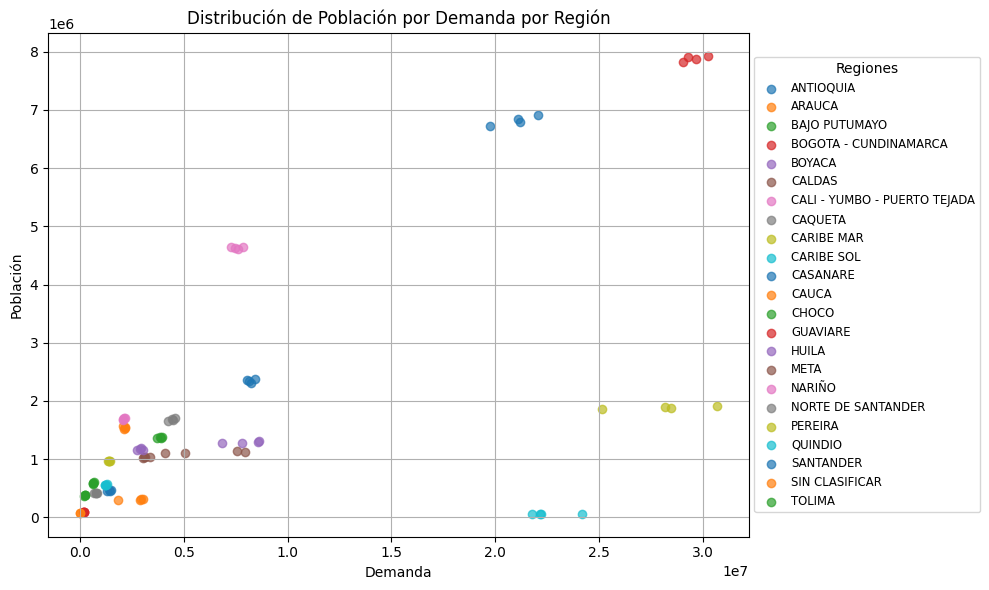

In [285]:
plt.figure(figsize=(10, 6))

for region in df_demanda_poblacion['Region'].unique():
    region_data = df_demanda_poblacion[df_demanda_poblacion['Region'] == region]
    plt.scatter(region_data['Demanda'], region_data['Poblacion'], label=region, alpha=0.7)

plt.title('Distribución de Población por Demanda por Región')
plt.xlabel('Demanda')
plt.ylabel('Población')

plt.legend(title='Regiones', loc='center left', bbox_to_anchor=(1, 0.5), fontsize='small')
plt.grid(True)

plt.subplots_adjust(right=0.75)

plt.tight_layout()
plt.show()

### Analiis del IPC en Colombia

In [290]:
df_demanda = pd.read_csv('./data/demanda_region.csv')

# Convertir a formato fecha
df_demanda['Date'] = pd.to_datetime(df_demanda['Date'])

# Filtrar por las fechas menor a 2024-10-01
df_demanda = df_demanda[df_demanda['Date'] < '2024-10-01']

In [294]:
ipc_df = pd.read_excel('./data/IPC.xls')

In [297]:
ipc_df.describe()

,Año,Número Índice
count,1035.000000,1035.000000
mean,2022.400000,126.629411
std,1.083729,13.630184
min,2021.000000,104.390000
25%,2021.000000,112.825000
50%,2022.000000,127.200000
75%,2023.000000,138.685000
max,2024.000000,154.190000


In [298]:
# Contar nulos
ipc_df.isnull().sum()

Año              0
Mes              0
Ciudad           0
Número Índice    0
dtype: int64

In [299]:
ipc_df['Ciudad'].unique()

array(['Otras areas urbanas', 'TUNJA', 'PEREIRA', 'BUCARAMANGA',
       'SINCELEJO', 'IBAGUÉ', 'CALI', 'NEIVA', 'RIOHACHA', 'SANTA MARTA',
       'VILLAVICENCIO', 'PASTO', 'ARMENIA', 'MANIZALES', 'FLORENCIA',
       'POPAYÁN', 'VALLEDUPAR', 'MONTERÍA', 'MEDELLÍN', 'BARRANQUILLA',
       'BOGOTÁ, D.C.', 'CARTAGENA DE INDIAS', 'CÚCUTA'], dtype=object)

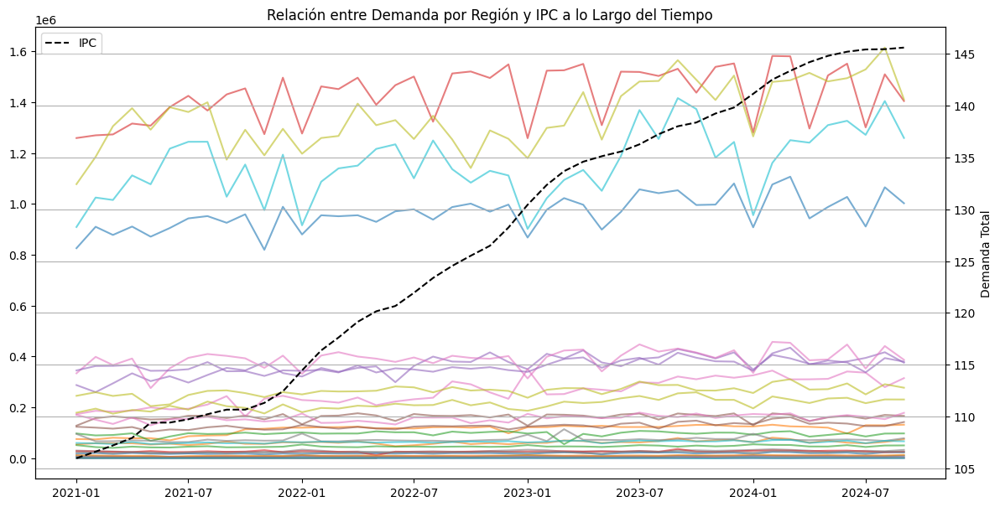

In [295]:
demanda_df['Date'] = pd.to_datetime(demanda_df['Date'])
demanda_df_grouped = demanda_df.groupby(['Date', 'Values_code'])[['Values_Hour01']].sum().reset_index()
demanda_df_grouped.rename(columns={'Values_Hour01': 'Demanda_Total'}, inplace=True)

# Cargar y preparar los datos de IPC
ipc_df_cleaned = ipc_df[['Año', 'Mes', 'Número Índice']].dropna()

# Mapeo de meses en español a inglés
month_mapping = {
    'Ene': 'Jan', 'Feb': 'Feb', 'Mar': 'Mar', 'Abr': 'Apr', 'May': 'May', 'Jun': 'Jun',
    'Jul': 'Jul', 'Ago': 'Aug', 'Sep': 'Sep', 'Oct': 'Oct', 'Nov': 'Nov', 'Dic': 'Dec'
}
ipc_df_cleaned['Mes'] = ipc_df_cleaned['Mes'].map(month_mapping)
ipc_df_cleaned['Fecha'] = pd.to_datetime(ipc_df_cleaned['Año'].astype(int).astype(str) + '-' + ipc_df_cleaned['Mes'], format='%Y-%b')
ipc_df_cleaned.rename(columns={'Número Índice': 'IPC'}, inplace=True)
ipc_df_grouped = ipc_df_cleaned.groupby('Fecha')['IPC'].mean().reset_index()

# Combinar los conjuntos de datos
merged_df = pd.merge(demanda_df_grouped, ipc_df_grouped, left_on='Date', right_on='Fecha', how='inner')

# Graficar la demanda por región y el IPC a lo largo del tiempo
plt.figure(figsize=(14, 7))
for region in merged_df['Values_code'].unique():
    region_data = merged_df[merged_df['Values_code'] == region]
    plt.plot(region_data['Date'], region_data['Demanda_Total'], label=f'Demanda - {region}', alpha=0.6)

# Graficar el IPC en el eje secundario
plt.twinx()
plt.plot(merged_df['Fecha'], merged_df['IPC'], color='black', label='IPC', linestyle='--')
plt.title('Relación entre Demanda por Región y IPC a lo Largo del Tiempo')
plt.xlabel('Fecha')
plt.ylabel('Demanda Total')
plt.legend(loc='upper left')
plt.grid()
plt.show()

Aunque el comportamiento de la demanda se ha mantenido relativamente estacionario en las regiones,vemos que las regiones que mas demanda presentan crecen junto con el crecimiento del IPC.

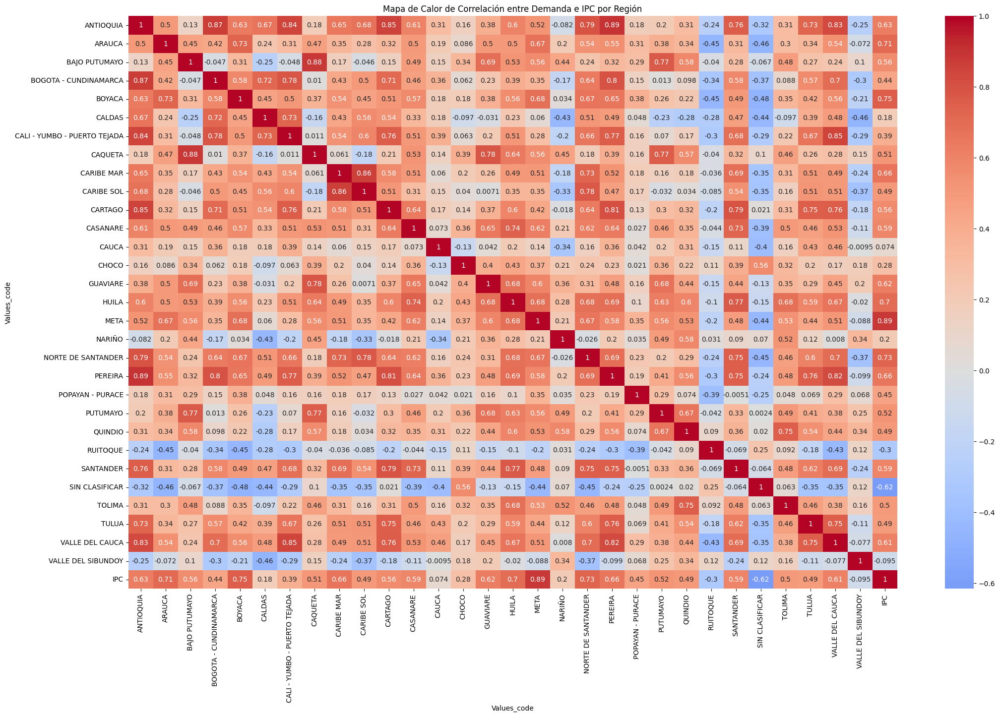

In [300]:
# Pivoting the data to calculate correlation for each region
correlation_df = merged_df.pivot(index='Date', columns='Values_code', values='Demanda_Total')
correlation_df['IPC'] = merged_df.groupby('Date')['IPC'].mean()
correlation_matrix = correlation_df.corr()

plt.figure(figsize=(25, 15))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title("Mapa de Calor de Correlación entre Demanda e IPC por Región")
plt.show()

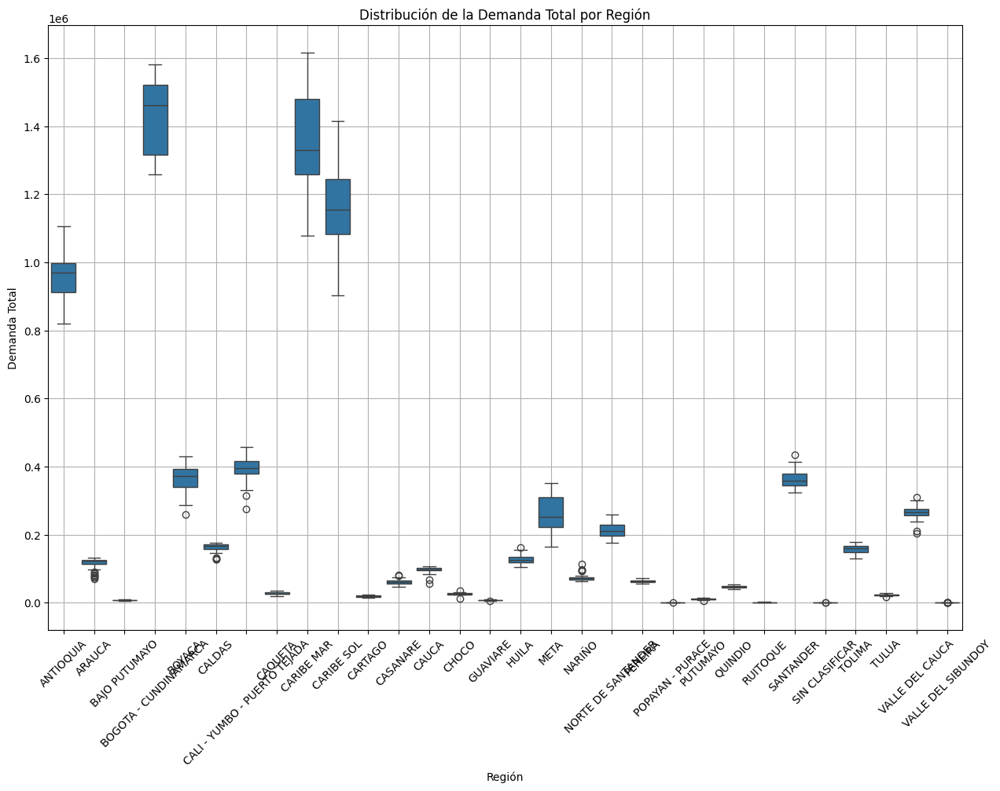

In [301]:
plt.figure(figsize=(15, 10))
sns.boxplot(data=merged_df, x='Values_code', y='Demanda_Total')
plt.title("Distribución de la Demanda Total por Región")
plt.xlabel("Región")
plt.ylabel("Demanda Total")
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

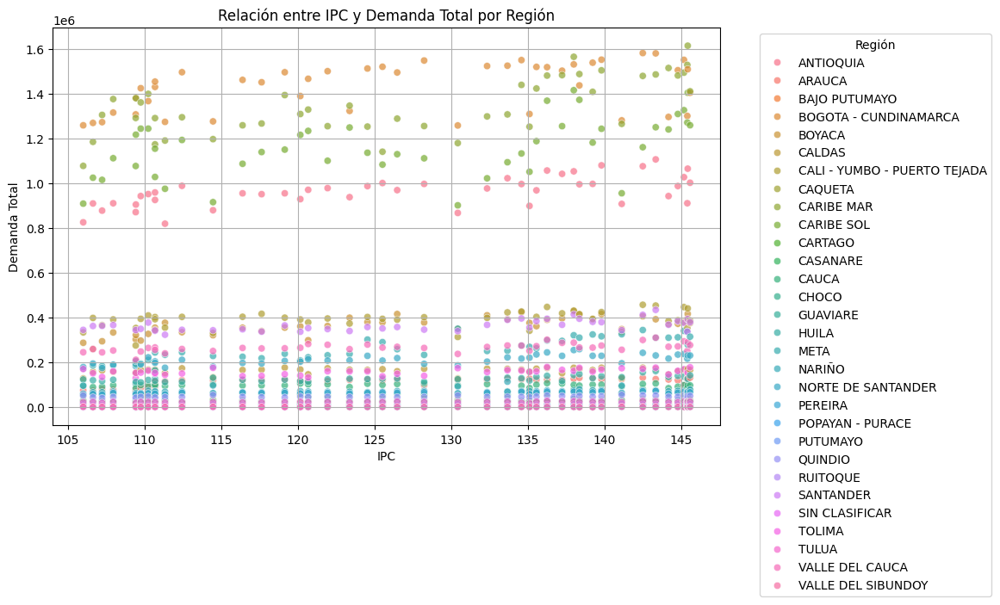

In [302]:
plt.figure(figsize=(10, 6))
sns.scatterplot(data=merged_df, x='IPC', y='Demanda_Total', hue='Values_code', alpha=0.7)
plt.title("Relación entre IPC y Demanda Total por Región")
plt.xlabel("IPC")
plt.ylabel("Demanda Total")
plt.legend(title="Región", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()

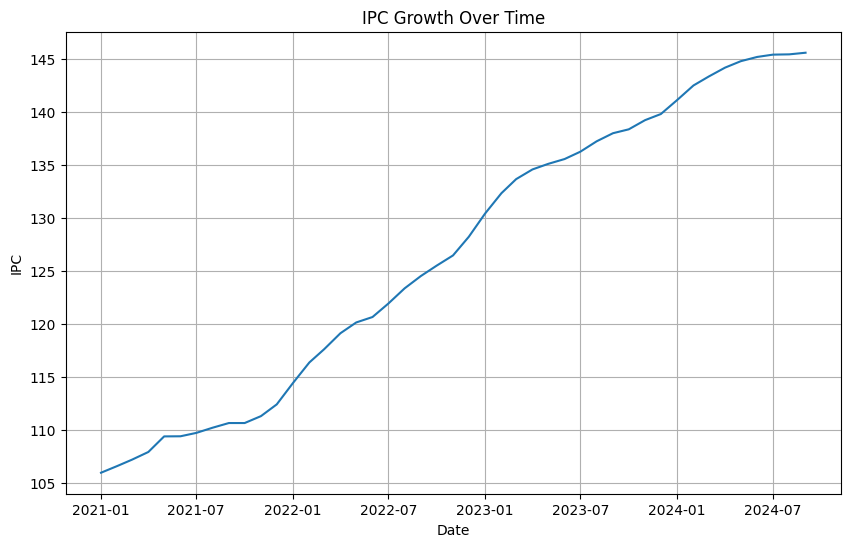

In [303]:
plt.figure(figsize=(10, 6))
plt.plot(ipc_df_grouped['Fecha'], ipc_df_grouped['IPC'])
plt.title('IPC Growth Over Time')
plt.xlabel('Date')
plt.ylabel('IPC')
plt.grid(True)
plt.show()

In [304]:
print("IPC Data Description:\n", ipc_df.describe())
print("\nMissing values in IPC data:\n", ipc_df.isnull().sum())
print("\nIPC Value Counts per Year:\n", ipc_df['Año'].value_counts())
print("\nMean IPC:", ipc_df['Número Índice'].mean())
print("\nMedian IPC:", ipc_df['Número Índice'].median())

IPC Data Description:
                Año  Número Índice
count  1035.000000    1035.000000
mean   2022.400000     126.629411
std       1.083729      13.630184
min    2021.000000     104.390000
25%    2021.000000     112.825000
50%    2022.000000     127.200000
75%    2023.000000     138.685000
max    2024.000000     154.190000

Missing values in IPC data:
 Año              0
Mes              0
Ciudad           0
Número Índice    0
dtype: int64

IPC Value Counts per Year:
 Año
2021    276
2022    276
2023    276
2024    207
Name: count, dtype: int64

Mean IPC: 126.62941062801933

Median IPC: 127.2


### Análisis de la temperatura en Colombia

In [305]:
#Importar datos de temperatura
df_temperatura = pd.read_csv('./data/temperatura_region.csv')

# Convertir a formato fecha
df_temperatura['Date'] = pd.to_datetime(df_temperatura['Date'])

In [306]:
df_temperatura.describe()

,Date,Temperatura
count,27086,27086.000000
mean,2022-11-22 15:52:00.460754688,22.603201
min,2021-01-01 00:00:00,6.400000
25%,2021-12-16 00:00:00,17.300000
50%,2022-11-24 00:00:00,24.200000
75%,2023-11-01 00:00:00,27.400000
max,2024-09-30 00:00:00,36.800000
std,NaN,5.720473


In [307]:
hours_columns=["Values_Hour01","Values_Hour02","Values_Hour03","Values_Hour04","Values_Hour05","Values_Hour06","Values_Hour07","Values_Hour08","Values_Hour09","Values_Hour10","Values_Hour11","Values_Hour12","Values_Hour13","Values_Hour14","Values_Hour15","Values_Hour16","Values_Hour17","Values_Hour18","Values_Hour19",'Values_Hour20', 'Values_Hour21', 'Values_Hour22', 'Values_Hour23',"Values_Hour24"]
df_demanda['Total Demand'] = df_demanda[hours_columns].sum(axis=1)
df_demanda.head()

,Id,Values_code,Values_MarketType,Values_Hour01,Values_Hour02,Values_Hour03,Values_Hour04,Values_Hour05,Values_Hour06,Values_Hour07,...,Values_Hour17,Values_Hour18,Values_Hour19,Values_Hour20,Values_Hour21,Values_Hour22,Values_Hour23,Values_Hour24,Date,Total Demand
667,MercadoComercializacion,ANTIOQUIA,NO REGULADO,378191.79,373207.07,372796.25,373527.31,376376.99,385734.23,386971.59,...,406570.22,391076.18,417662.11,411696.53,406289.62,393638.33,388427.85,378522.26,2024-09-12,9569174.95
668,MercadoComercializacion,ANTIOQUIA,REGULADO,725389.36,681233.57,660791.60,658666.64,706184.61,810299.14,909185.15,...,1141277.05,1095130.62,1146601.17,1148282.87,1098187.74,1007957.35,887890.37,778934.78,2024-09-12,23479582.01
669,MercadoComercializacion,ARAUCA,NO REGULADO,46481.52,45643.30,44646.32,43577.26,43553.70,51110.66,53721.40,...,71416.78,70698.09,71122.14,70089.10,68689.24,66813.83,64849.63,64314.07,2024-09-12,1434893.73
670,MercadoComercializacion,ARAUCA,REGULADO,40245.18,38449.11,37372.19,36180.10,35018.85,33850.17,33189.69,...,45685.88,43530.01,47227.19,47305.63,46531.25,45511.11,42814.98,39077.55,2024-09-12,995598.78
671,MercadoComercializacion,BAJO PUTUMAYO,NO REGULADO,129.80,121.47,112.68,116.13,114.00,124.43,155.99,...,278.26,250.46,213.31,194.01,179.13,184.56,164.10,162.20,2024-09-12,4800.20


In [308]:
df_merged = pd.merge(df_demanda, df_temperatura, on=['Values_code', 'Date'], how='inner')
df_merged.head()

,Id,Values_code,Values_MarketType,Values_Hour01,Values_Hour02,Values_Hour03,Values_Hour04,Values_Hour05,Values_Hour06,Values_Hour07,...,Values_Hour18,Values_Hour19,Values_Hour20,Values_Hour21,Values_Hour22,Values_Hour23,Values_Hour24,Date,Total Demand,Temperatura
0,MercadoComercializacion,ANTIOQUIA,NO REGULADO,378191.79,373207.07,372796.25,373527.31,376376.99,385734.23,386971.59,...,391076.18,417662.11,411696.53,406289.62,393638.33,388427.85,378522.26,2024-09-12,9569174.95,21.533333
1,MercadoComercializacion,ANTIOQUIA,REGULADO,725389.36,681233.57,660791.60,658666.64,706184.61,810299.14,909185.15,...,1095130.62,1146601.17,1148282.87,1098187.74,1007957.35,887890.37,778934.78,2024-09-12,23479582.01,21.533333
2,MercadoComercializacion,ARAUCA,NO REGULADO,46481.52,45643.30,44646.32,43577.26,43553.70,51110.66,53721.40,...,70698.09,71122.14,70089.10,68689.24,66813.83,64849.63,64314.07,2024-09-12,1434893.73,27.600000
3,MercadoComercializacion,ARAUCA,REGULADO,40245.18,38449.11,37372.19,36180.10,35018.85,33850.17,33189.69,...,43530.01,47227.19,47305.63,46531.25,45511.11,42814.98,39077.55,2024-09-12,995598.78,27.600000
4,MercadoComercializacion,BOGOTA - CUNDINAMARCA,NO REGULADO,604733.54,595552.35,571603.57,556989.10,544085.37,541262.65,568206.32,...,596953.10,590763.67,593033.20,595814.90,585336.92,576499.85,597416.62,2024-09-12,14104869.99,16.500000


In [309]:
#Gráfica de información por año
date_2021 = pd.to_datetime('2021-01-01')
date_2022 = pd.to_datetime('2022-01-01')
date_2023 = pd.to_datetime('2023-01-01')
date_2024 = pd.to_datetime('2024-01-01')
df_merged_2021 = df_merged[(df_merged['Date'] >= date_2021) & (df_merged['Date'] < date_2022)]
df_merged_2022 = df_merged[(df_merged['Date'] >= date_2022) & (df_merged['Date'] < date_2023)]
df_merged_2023 = df_merged[(df_merged['Date'] >= date_2023) & (df_merged['Date'] < date_2024)]
df_merged_2024 = df_merged[(df_merged['Date'] >= date_2024)]
df_temperatura_2021 = df_temperatura[(df_temperatura['Date'] >= date_2021) & (df_temperatura['Date'] < date_2022)]
df_temperatura_2022 = df_temperatura[(df_temperatura['Date'] >= date_2022) & (df_temperatura['Date'] < date_2023)]
df_temperatura_2023 = df_temperatura[(df_temperatura['Date'] >= date_2023) & (df_temperatura['Date'] < date_2024)]
df_temperatura_2024 = df_temperatura[(df_temperatura['Date'] >= date_2024)]

In [310]:
#Se dejan únicamente las ciduades que se encuentran dentro del dataset de demanda en conjunto con el de temperatura
ciudades = ['ANTIOQUIA', 'ARAUCA', 'BOGOTA - CUNDINAMARCA', 'BOYACA', 'CALDAS', 'CAQUETA', 'CARIBE MAR', 'CARIBE SOL', 'CAUCA', 'CHOCO', 'GUAVIARE',
            'HUILA', 'META', 'NARIÑO', 'NORTE DE SANTANDER', 'PEREIRA', 'POPAYAN - PURACE', 'PUTUMAYO', 'SANTANDER', 'TOLIMA', 'TULUA']

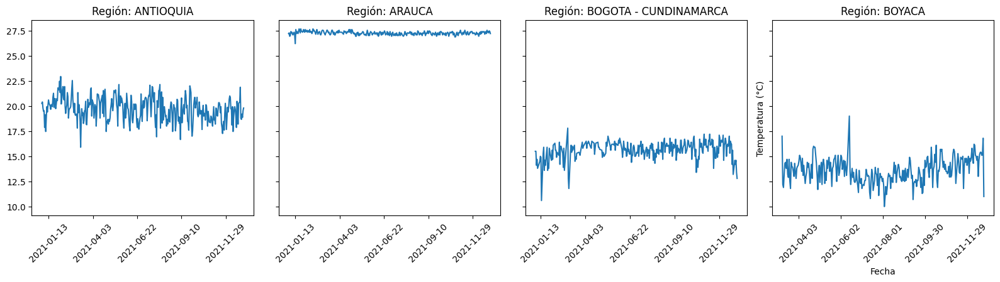

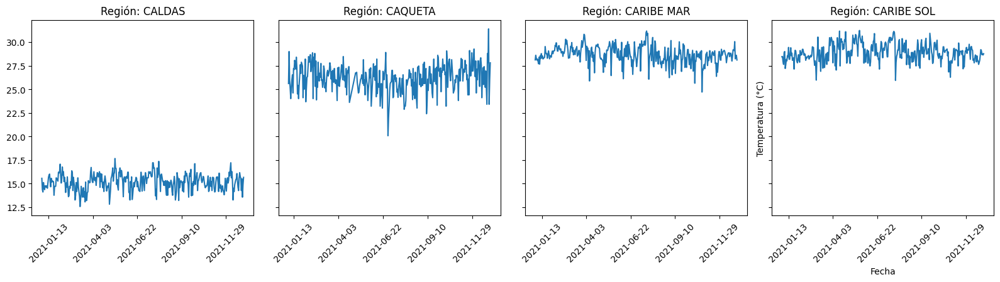

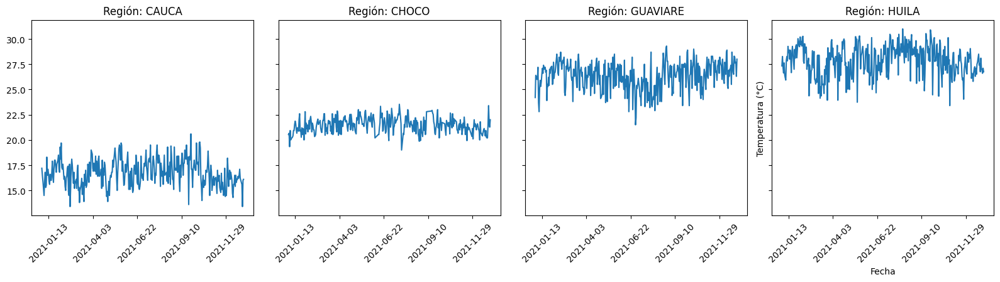

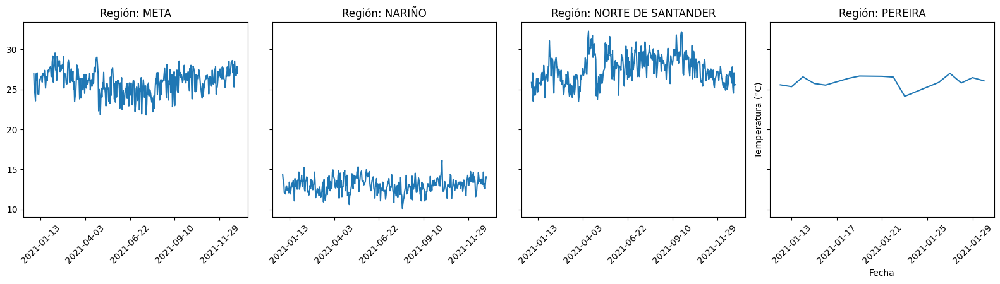

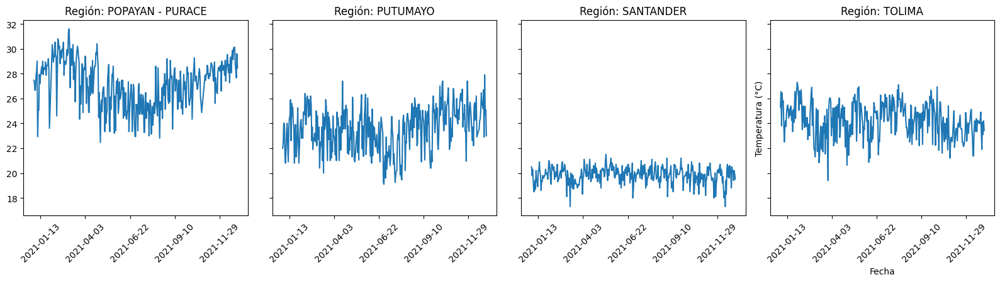

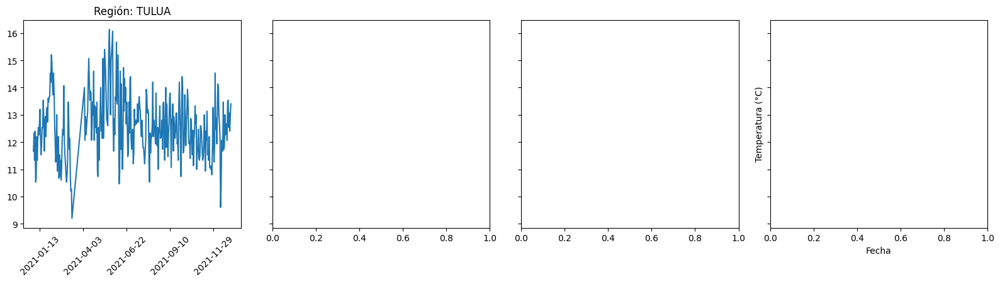

In [311]:
for i in range(0, len(ciudades), 4):
    fig, axes = plt.subplots(1, 4, figsize=(16,5), sharey=True)
    ciudades_grupo = ciudades[i:i+4]
    for ax, ciudad in zip(axes, ciudades_grupo):
        df_temperatura_city = df_temperatura_2021[df_temperatura_2021['Values_code'] == ciudad]
        ax.plot(df_temperatura_city['Date'], df_temperatura_city['Temperatura'], linestyle='-')
        ax.xaxis.set_major_locator(plt.MaxNLocator(nbins=6))
        ax.tick_params(axis='x', rotation=45)
        ax.set_title(f"Región: {ciudad}")
            
    plt.xlabel("Fecha")
    plt.ylabel("Temperatura (°C)")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

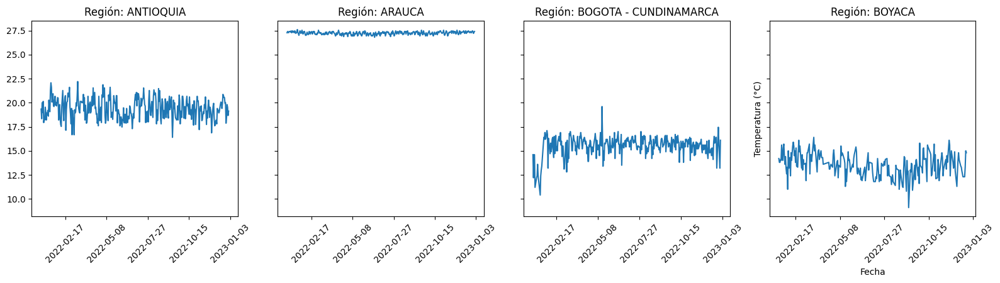

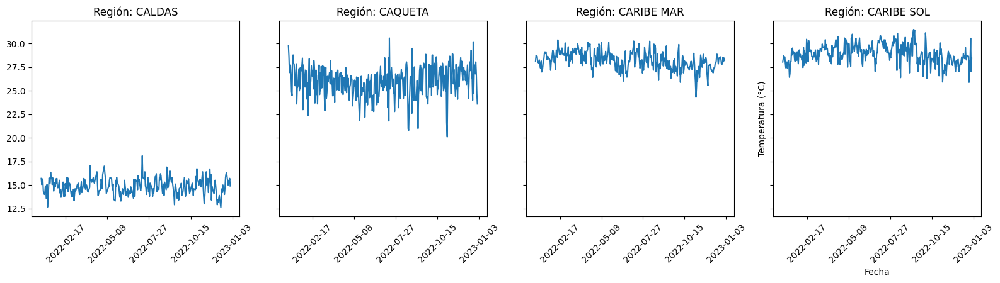

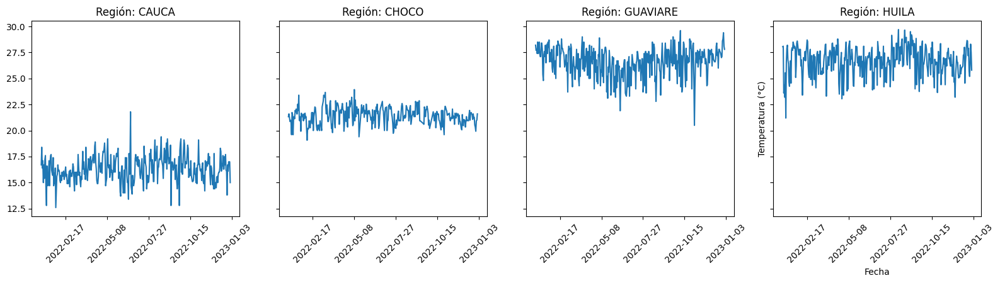

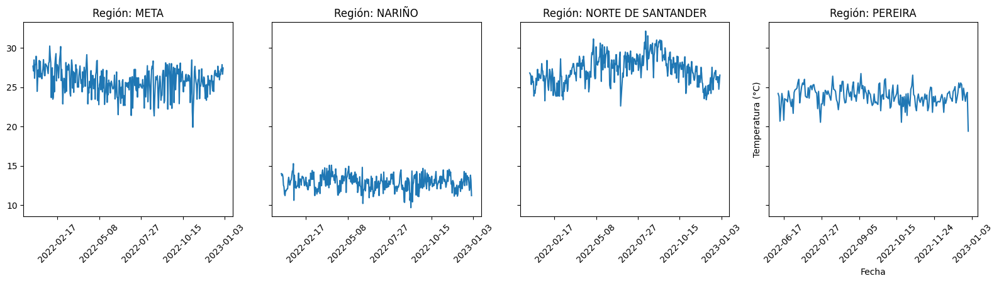

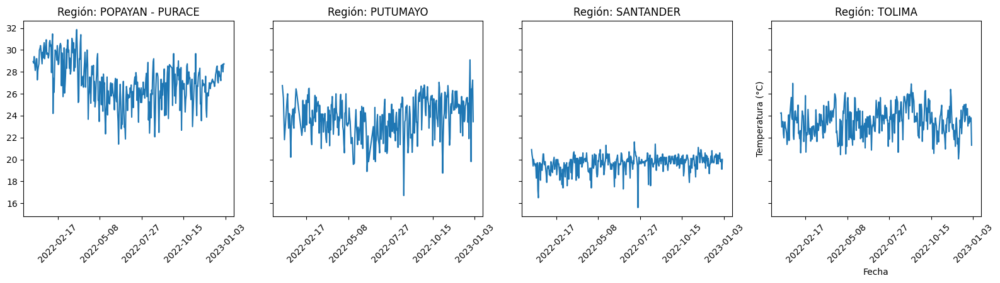

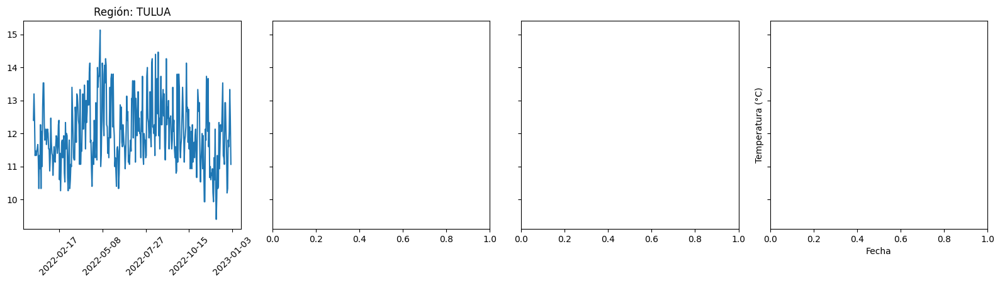

In [312]:
for i in range(0, len(ciudades), 4):
    fig, axes = plt.subplots(1, 4, figsize=(16,5), sharey=True)
    ciudades_grupo = ciudades[i:i+4]
    for ax, ciudad in zip(axes, ciudades_grupo):
        df_temperatura_city = df_temperatura_2022[df_temperatura_2022['Values_code'] == ciudad]
        ax.plot(df_temperatura_city['Date'], df_temperatura_city['Temperatura'], linestyle='-')
        ax.xaxis.set_major_locator(plt.MaxNLocator(nbins=6))
        ax.tick_params(axis='x', rotation=45)
        ax.set_title(f"Región: {ciudad}")
            
    plt.xlabel("Fecha")
    plt.ylabel("Temperatura (°C)")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

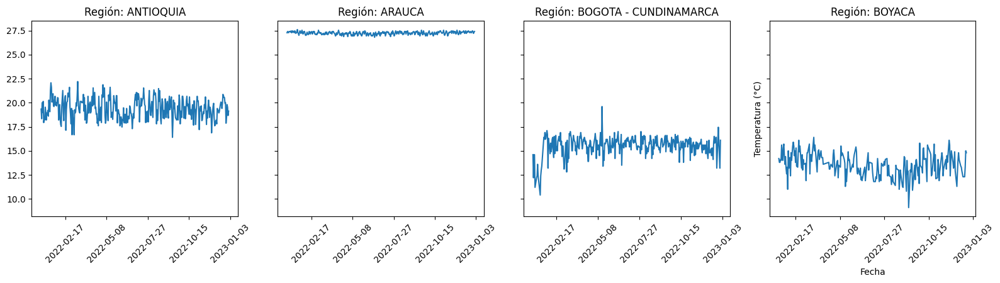

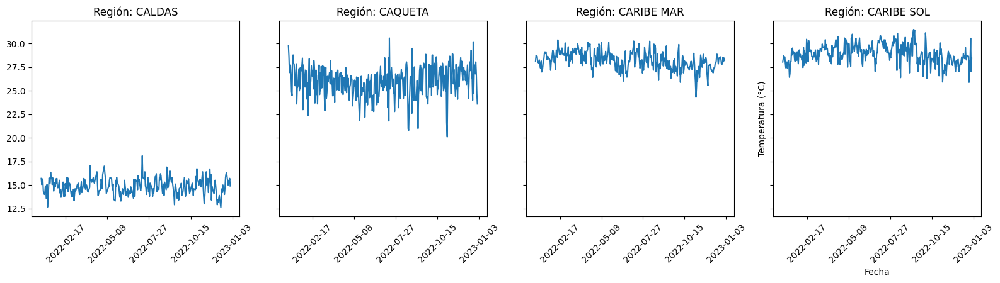

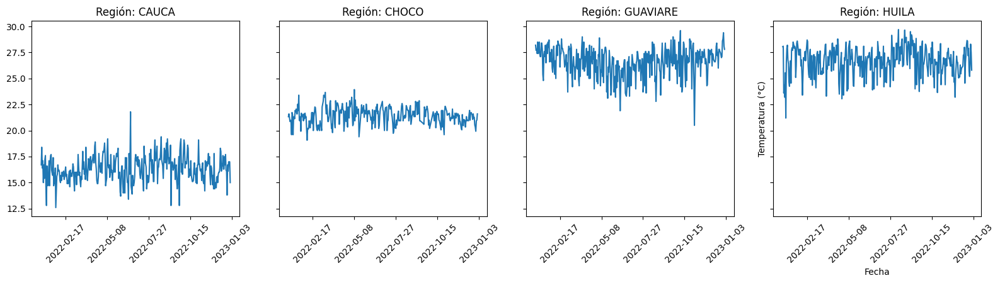

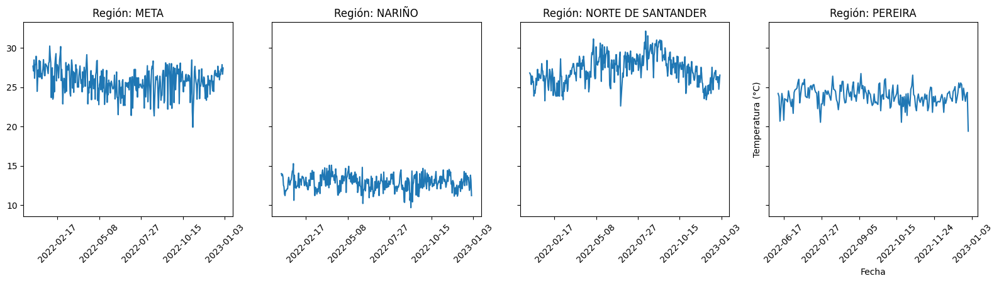

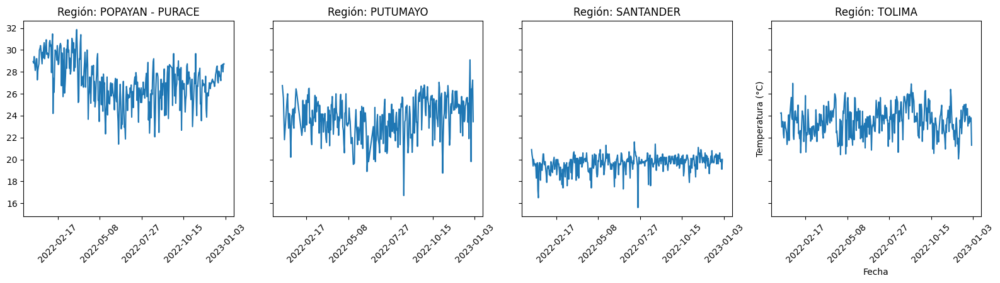

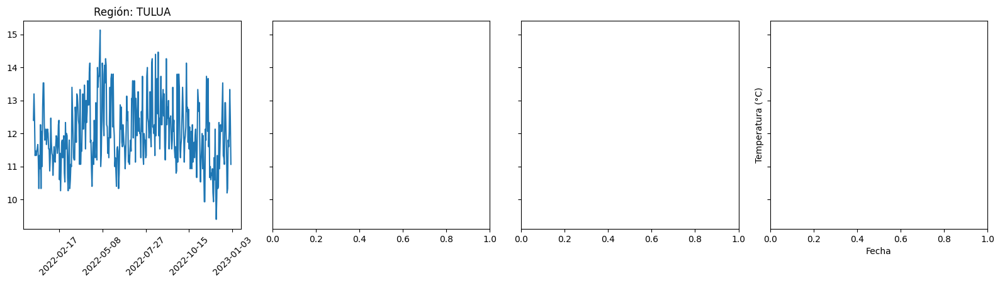

In [313]:
for i in range(0, len(ciudades), 4):
    fig, axes = plt.subplots(1, 4, figsize=(16,5), sharey=True)
    ciudades_grupo = ciudades[i:i+4]
    for ax, ciudad in zip(axes, ciudades_grupo):
        df_temperatura_city = df_temperatura_2022[df_temperatura_2022['Values_code'] == ciudad]
        ax.plot(df_temperatura_city['Date'], df_temperatura_city['Temperatura'], linestyle='-')
        ax.xaxis.set_major_locator(plt.MaxNLocator(nbins=6))
        ax.tick_params(axis='x', rotation=45)
        ax.set_title(f"Región: {ciudad}")
            
    plt.xlabel("Fecha")
    plt.ylabel("Temperatura (°C)")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

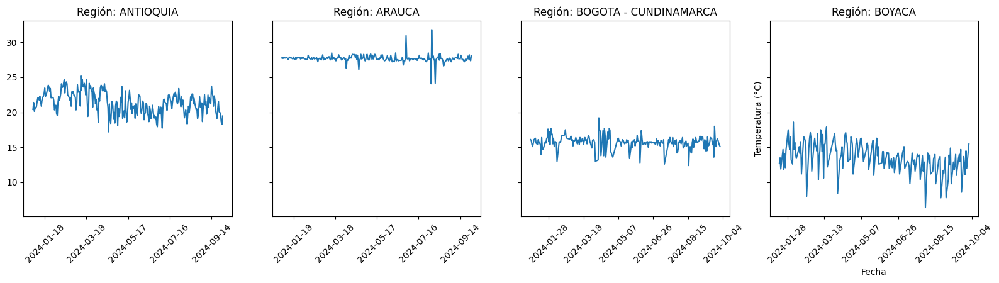

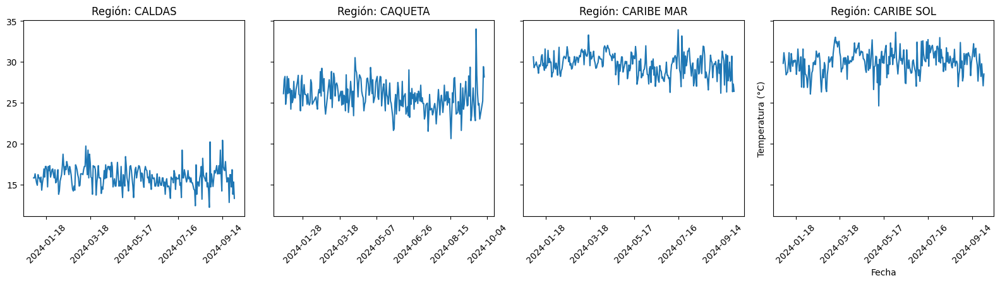

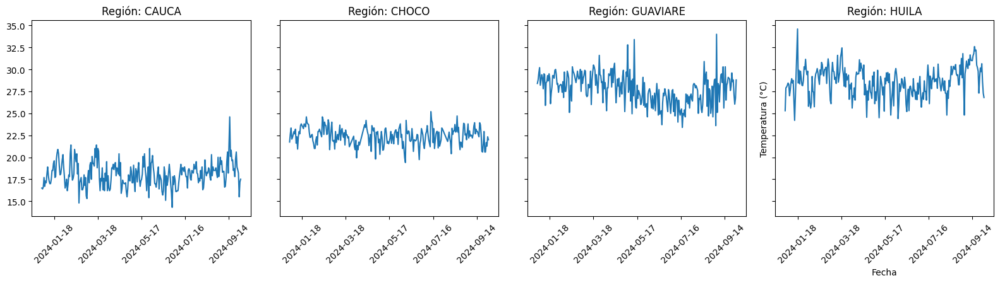

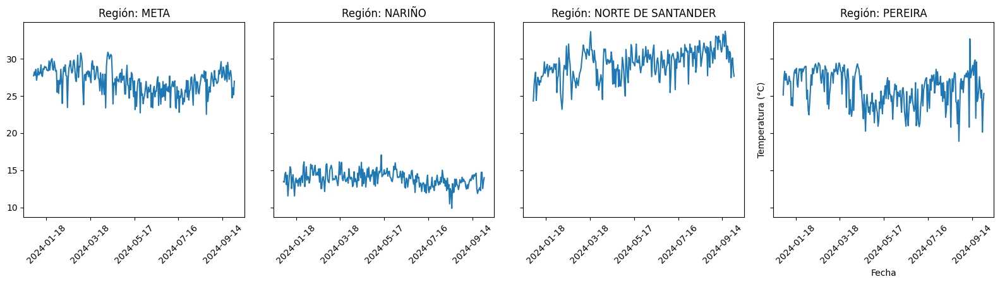

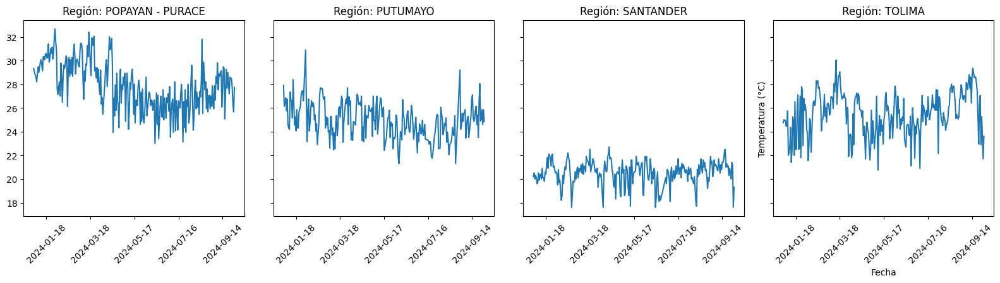

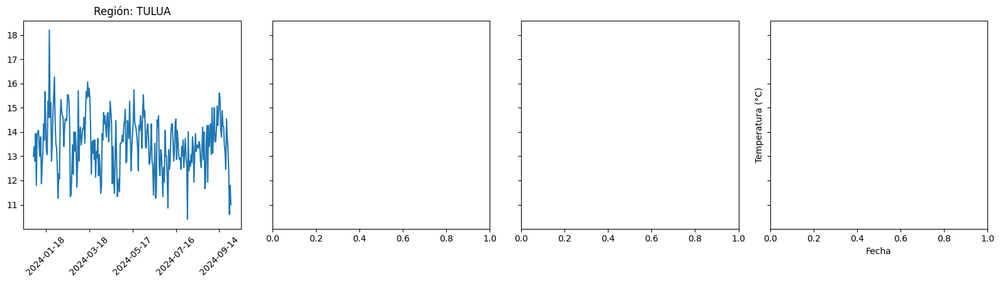

In [314]:
for i in range(0, len(ciudades), 4):
    fig, axes = plt.subplots(1, 4, figsize=(16,5), sharey=True)
    ciudades_grupo = ciudades[i:i+4]
    for ax, ciudad in zip(axes, ciudades_grupo):
        df_temperatura_city = df_temperatura_2024[df_temperatura_2024['Values_code'] == ciudad]
        ax.plot(df_temperatura_city['Date'], df_temperatura_city['Temperatura'], linestyle='-')
        ax.xaxis.set_major_locator(plt.MaxNLocator(nbins=6))
        ax.tick_params(axis='x', rotation=45)
        ax.set_title(f"Región: {ciudad}")
            
    plt.xlabel("Fecha")
    plt.ylabel("Temperatura (°C)")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

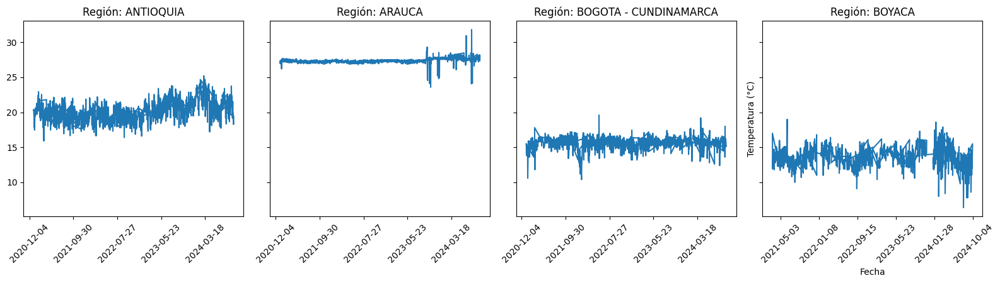

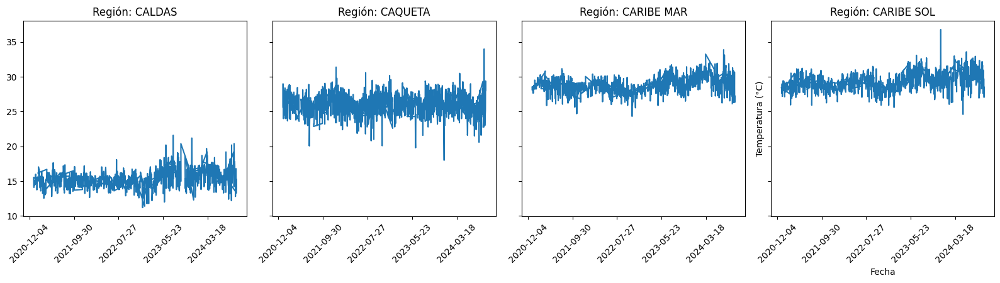

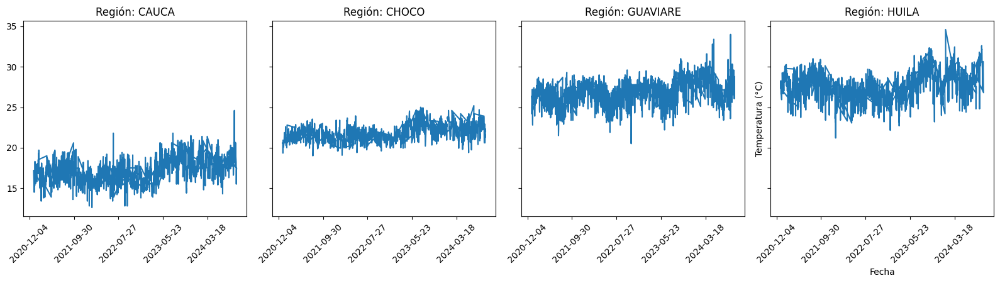

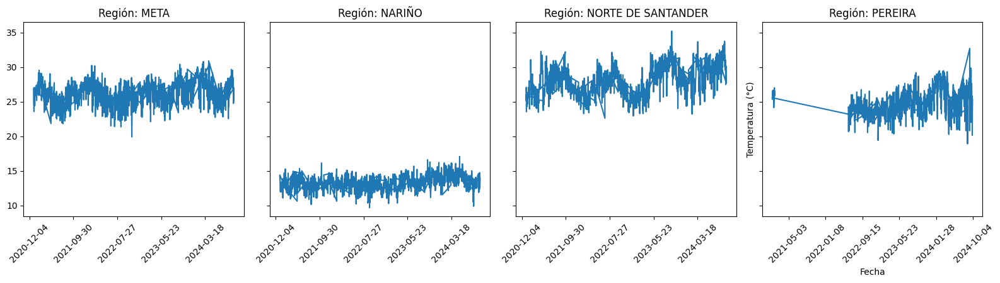

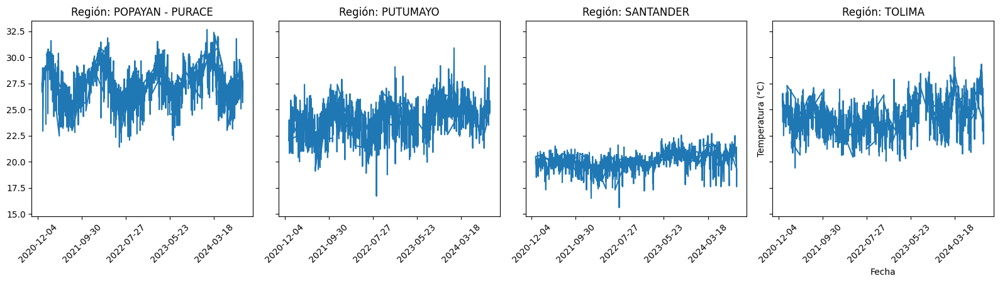

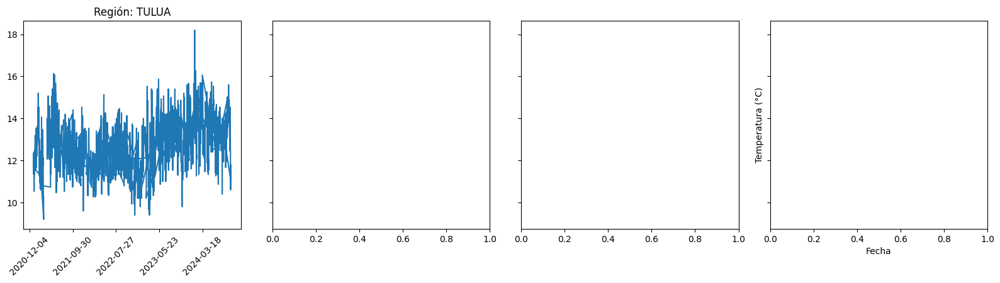

In [315]:
for i in range(0, len(ciudades), 4):
    fig, axes = plt.subplots(1, 4, figsize=(16,5), sharey=True)
    ciudades_grupo = ciudades[i:i+4]
    for ax, ciudad in zip(axes, ciudades_grupo):
        df_temperatura_city = df_merged[df_merged['Values_code'] == ciudad]
        ax.plot(df_temperatura_city['Date'], df_temperatura_city['Temperatura'], linestyle='-')
        ax.xaxis.set_major_locator(plt.MaxNLocator(nbins=6))
        ax.tick_params(axis='x', rotation=45)
        ax.set_title(f"Región: {ciudad}")
            
    plt.xlabel("Fecha")
    plt.ylabel("Temperatura (°C)")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

In [316]:
demanda_por_ciudad = df_merged_2021.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2021 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2021 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

In [317]:
demanda_por_ciudad = df_merged_2022.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2022 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2022 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

In [318]:
demanda_por_ciudad = df_merged_2023.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2023 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2023 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

In [319]:
demanda_por_ciudad = df_merged_2024.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2024 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2024 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

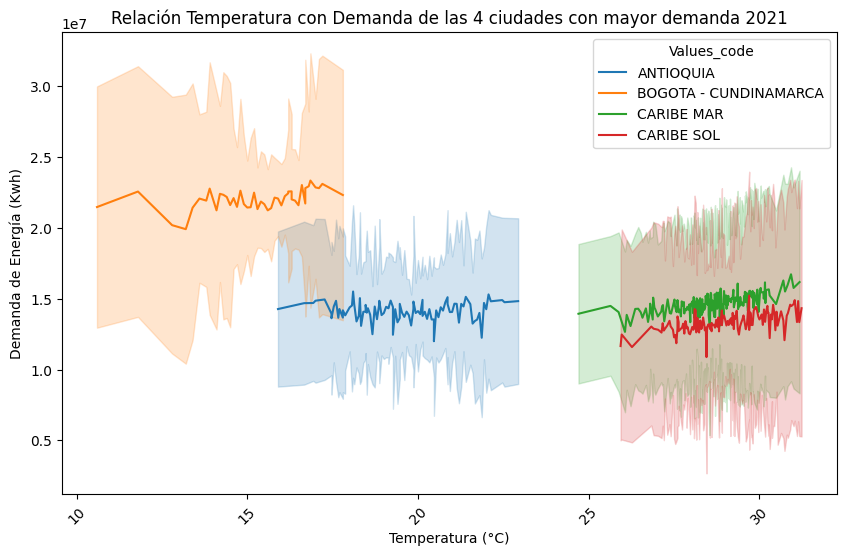

In [320]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_2021[df_merged_2021['Values_code'].isin(top_4_ciudades_2021)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda 2021")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

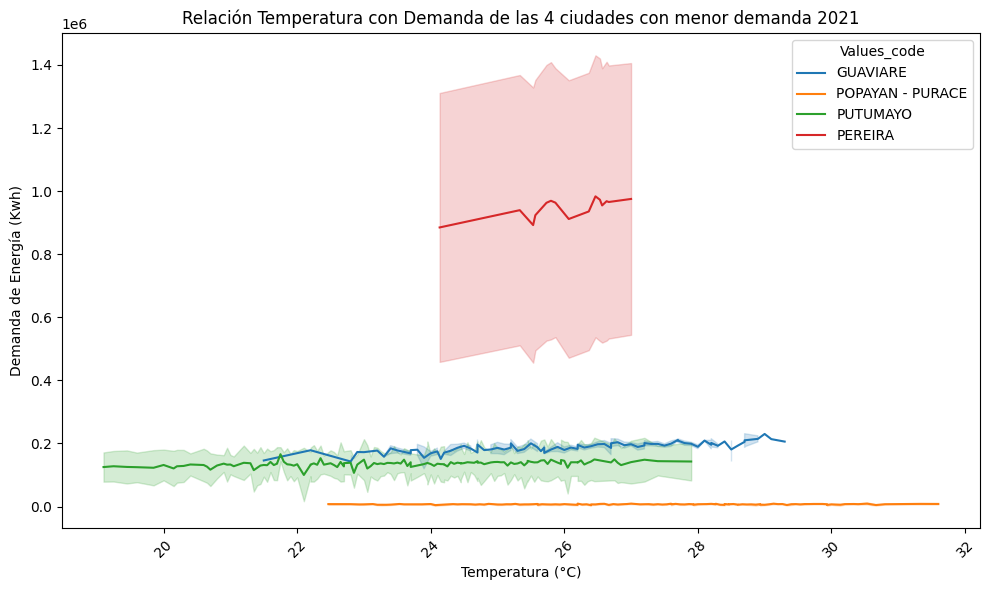

In [321]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_2021[df_merged_2021['Values_code'].isin(last_4_ciudades_2021)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con menor demanda 2021")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

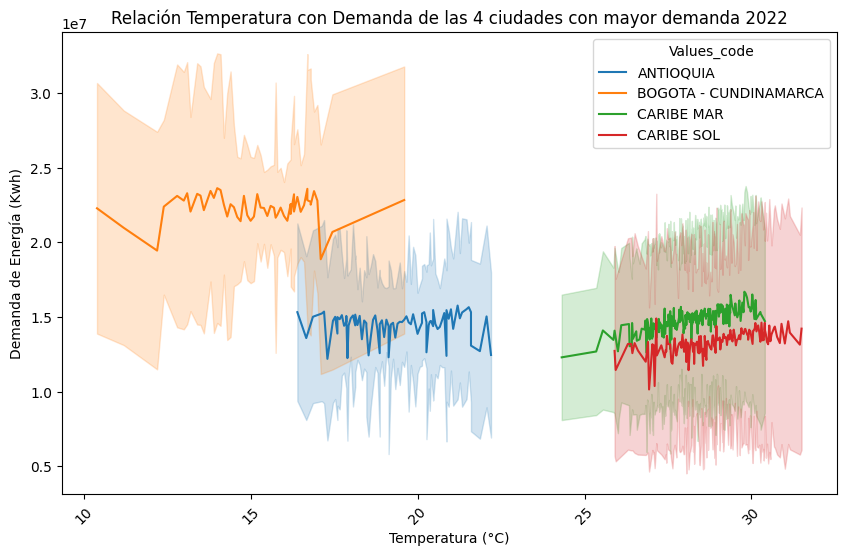

In [322]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_2022[df_merged_2022['Values_code'].isin(top_4_ciudades_2022)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda 2022")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

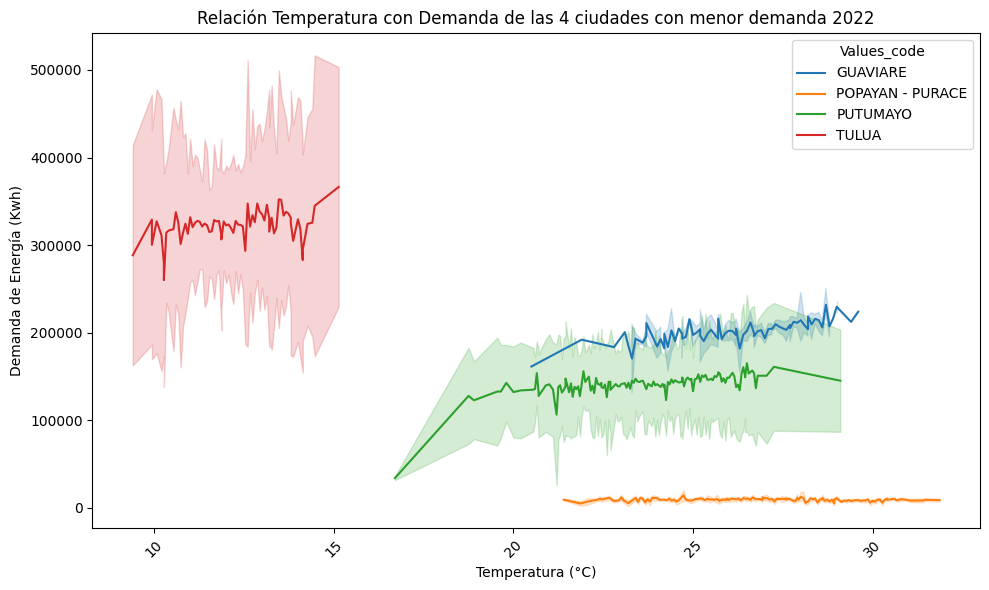

In [323]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_2022[df_merged_2022['Values_code'].isin(last_4_ciudades_2022)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con menor demanda 2022")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

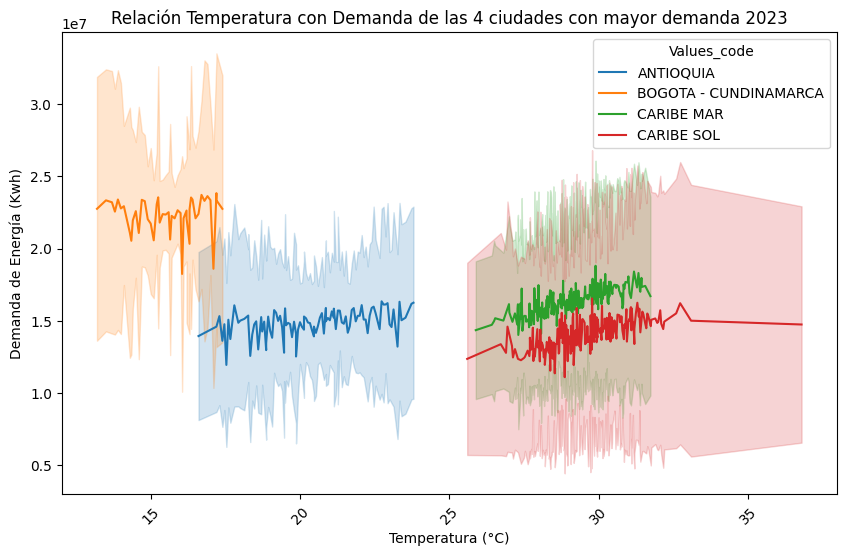

In [324]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_2023[df_merged_2023['Values_code'].isin(top_4_ciudades_2023)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda 2023")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

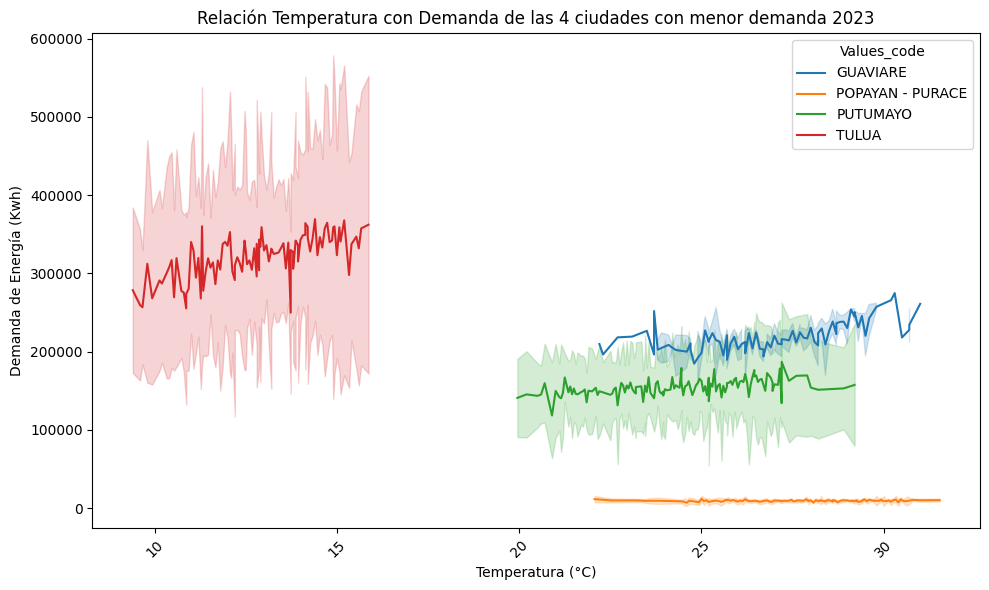

In [325]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_2023[df_merged_2023['Values_code'].isin(last_4_ciudades_2023)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con menor demanda 2023")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

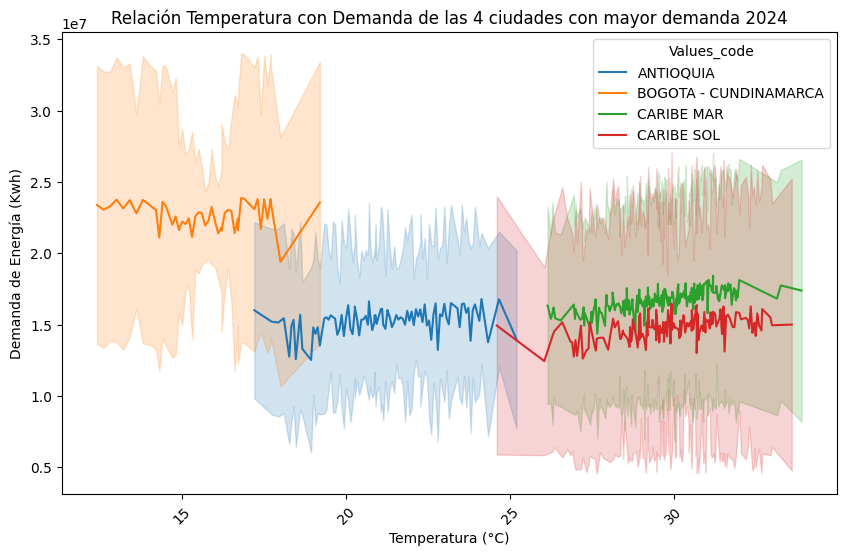

In [326]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_2024[df_merged_2024['Values_code'].isin(top_4_ciudades_2024)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda 2024")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

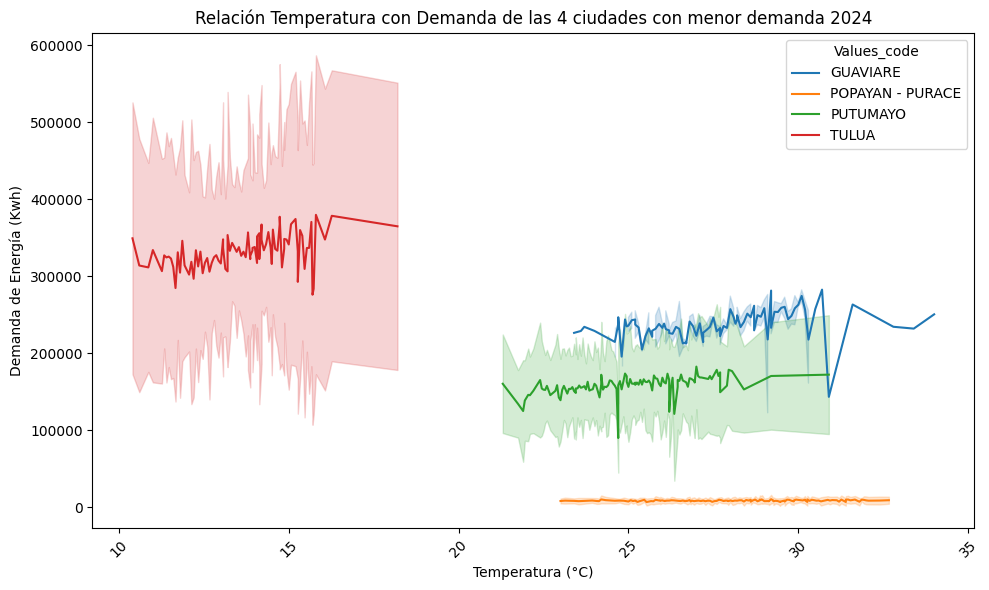

In [327]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_2024[df_merged_2024['Values_code'].isin(last_4_ciudades_2024)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con menor demanda 2024")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Revisión de relación separada entre mercado regulado y no regulado

### Regulado

In [328]:
df_merged_reg_2021 = df_merged_2021[df_merged_2021['Values_MarketType'] == 'REGULADO']

In [329]:
demanda_por_ciudad = df_merged_reg_2021.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2021 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2021 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

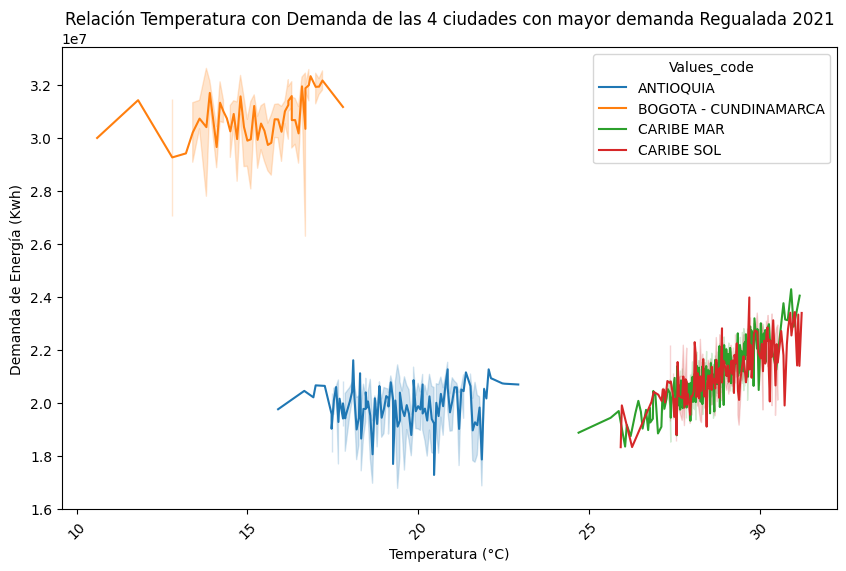

In [330]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_reg_2021[df_merged_reg_2021['Values_code'].isin(top_4_ciudades_2021)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda Regualada 2021")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

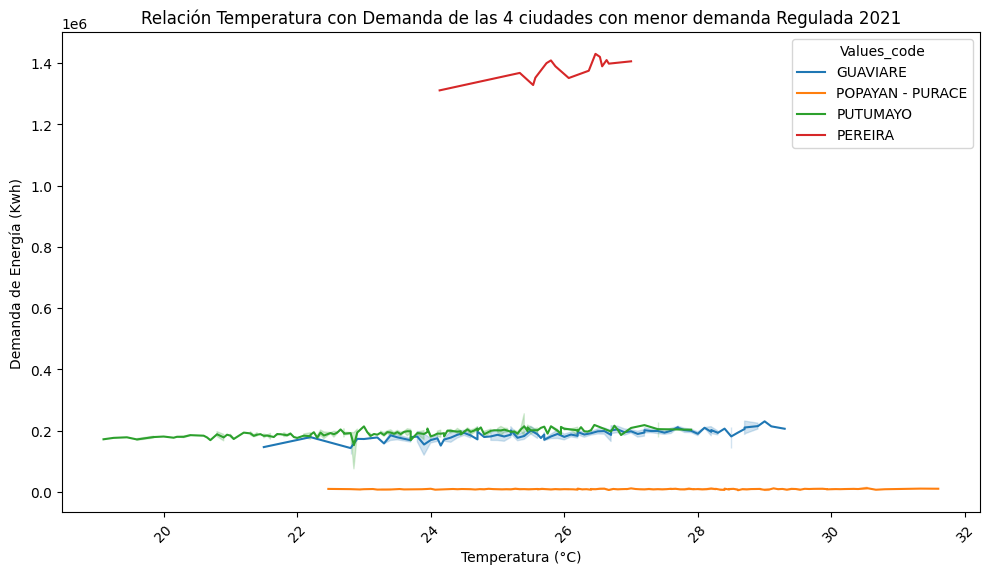

In [331]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_reg_2021[df_merged_reg_2021['Values_code'].isin(last_4_ciudades_2021)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con menor demanda Regulada 2021")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [332]:
df_merged_reg_2022 = df_merged_2022[df_merged_2022['Values_MarketType'] == 'REGULADO']

In [333]:
demanda_por_ciudad = df_merged_reg_2022.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2022 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2022 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

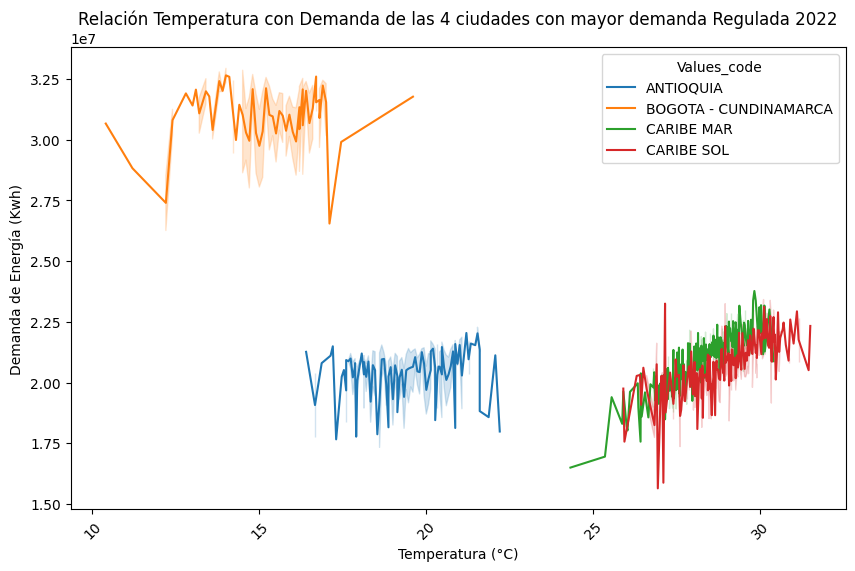

In [334]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_reg_2022[df_merged_reg_2022['Values_code'].isin(top_4_ciudades_2022)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda Regulada 2022")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

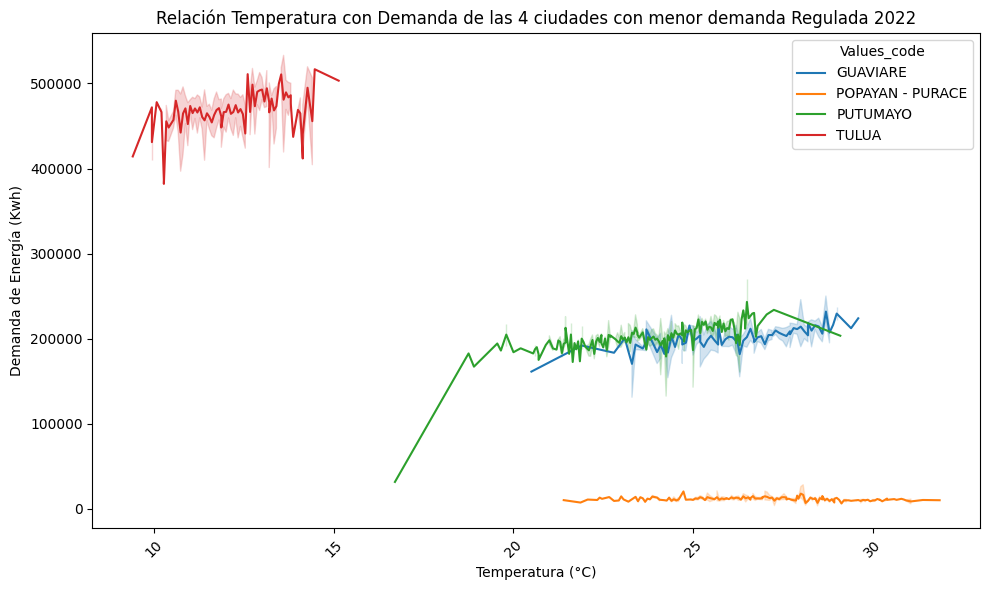

In [335]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_reg_2022[df_merged_reg_2022['Values_code'].isin(last_4_ciudades_2022)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con menor demanda Regulada 2022")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [336]:
df_merged_reg_2023 = df_merged_2023[df_merged_2023['Values_MarketType'] == 'REGULADO']

In [337]:
demanda_por_ciudad = df_merged_reg_2023.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2023 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2023 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

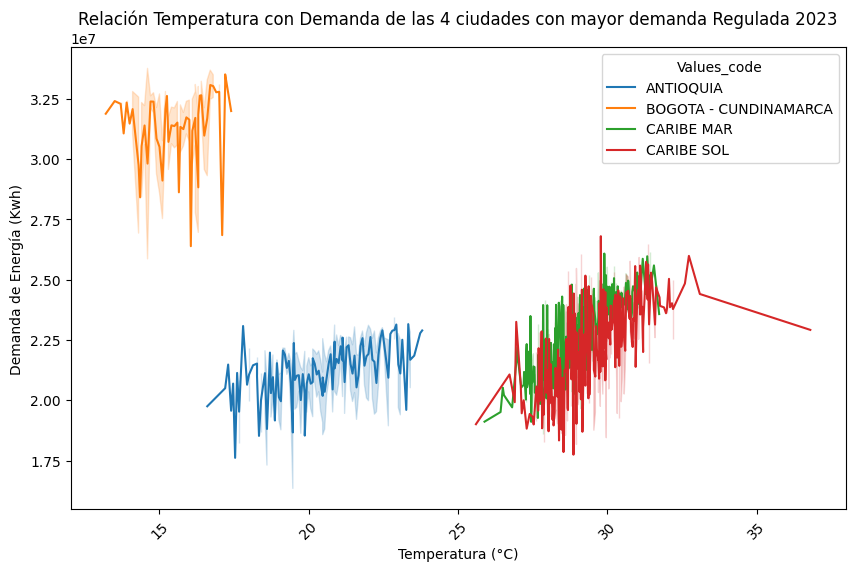

In [338]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_reg_2023[df_merged_reg_2023['Values_code'].isin(top_4_ciudades_2023)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda Regulada 2023")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

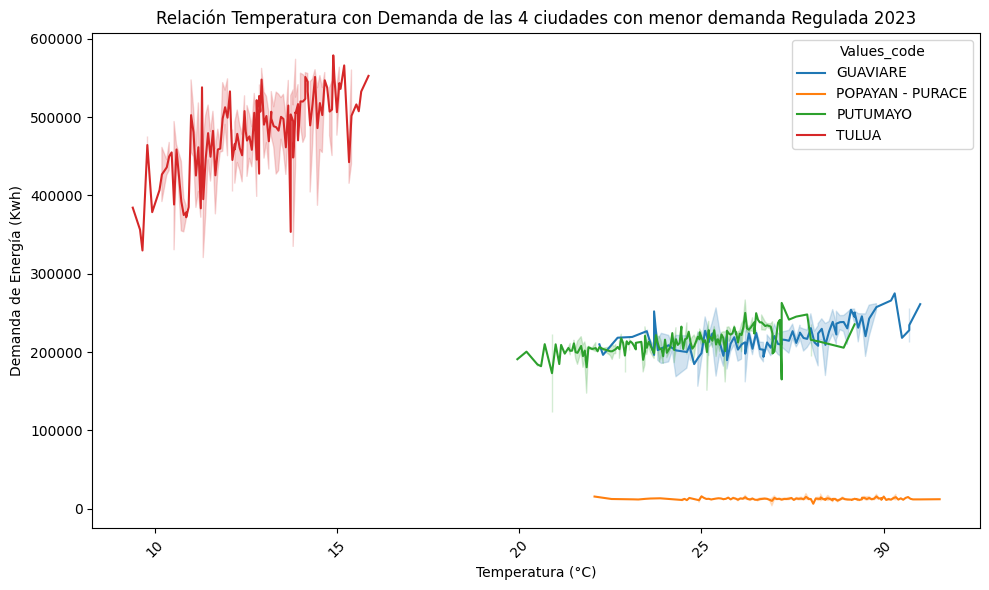

In [339]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_reg_2023[df_merged_reg_2023['Values_code'].isin(last_4_ciudades_2023)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con menor demanda Regulada 2023")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [340]:
df_merged_reg_2024 = df_merged_2024[df_merged_2024['Values_MarketType'] == 'REGULADO']

In [341]:
demanda_por_ciudad = df_merged_reg_2024.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2024 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2024 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

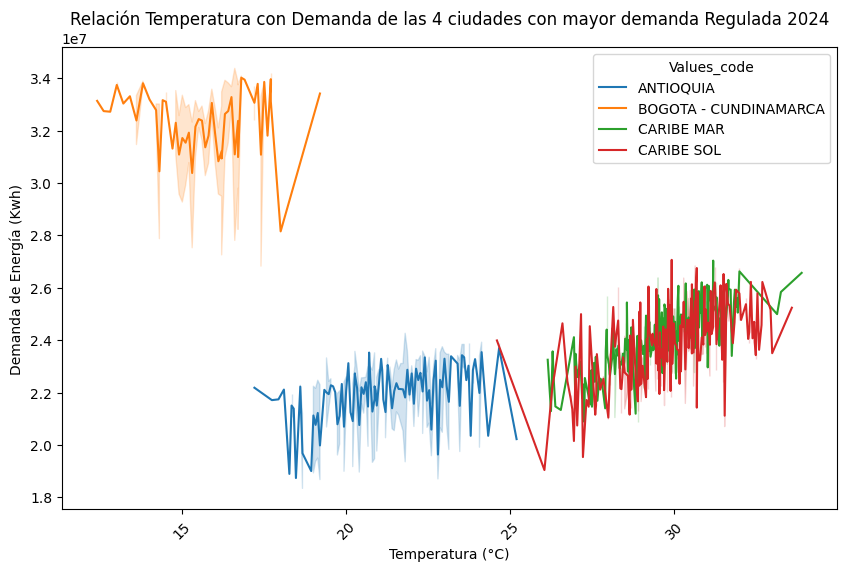

In [342]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_reg_2024[df_merged_reg_2024['Values_code'].isin(top_4_ciudades_2024)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda Regulada 2024")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

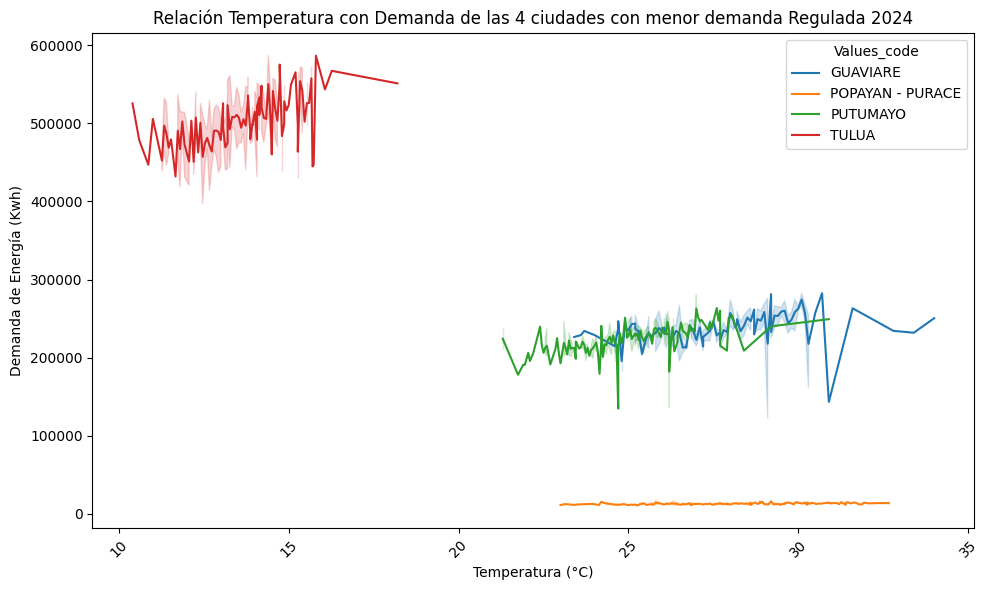

In [343]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_reg_2024[df_merged_reg_2024['Values_code'].isin(last_4_ciudades_2024)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con menor demanda Regulada 2024")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### No Regulado

In [344]:
df_merged_noreg_2021 = df_merged_2021[df_merged_2021['Values_MarketType'] == 'NO REGULADO']

In [345]:
demanda_por_ciudad = df_merged_reg_2021.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2021 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2021 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

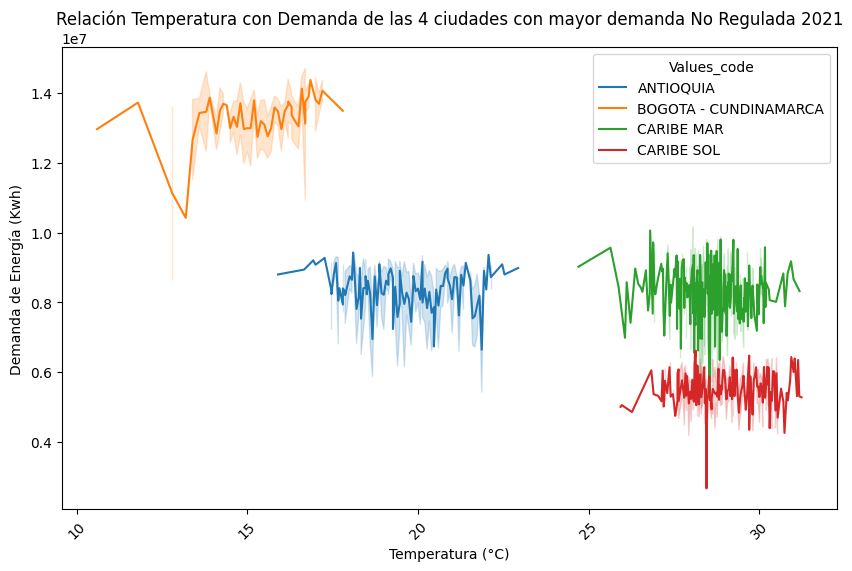

In [346]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_noreg_2021[df_merged_noreg_2021['Values_code'].isin(top_4_ciudades_2021)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda No Regulada 2021")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

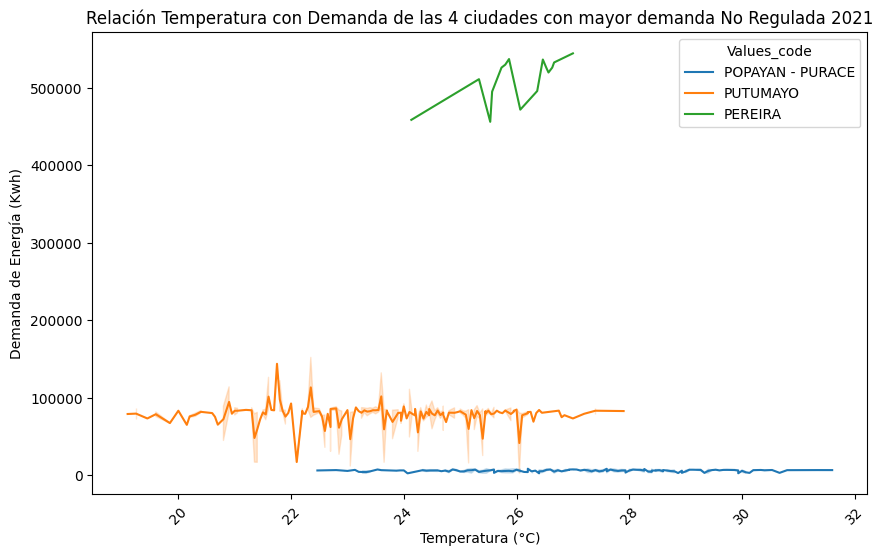

In [347]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_noreg_2021[df_merged_noreg_2021['Values_code'].isin(last_4_ciudades_2021)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda No Regulada 2021")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

In [348]:
df_merged_noreg_2022 = df_merged_2022[df_merged_2022['Values_MarketType'] == 'NO REGULADO']

In [349]:
demanda_por_ciudad = df_merged_reg_2022.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2022 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2022 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

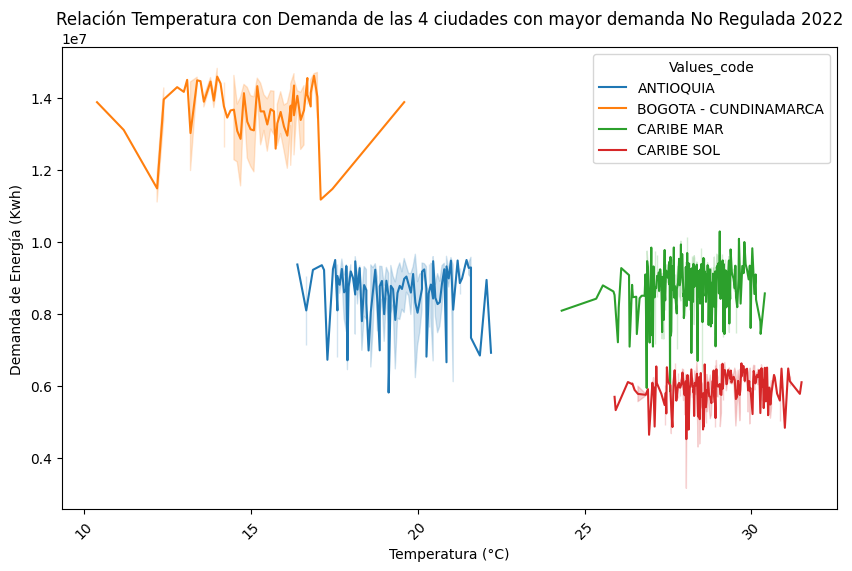

In [350]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_noreg_2022[df_merged_noreg_2022['Values_code'].isin(top_4_ciudades_2022)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda No Regulada 2022")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

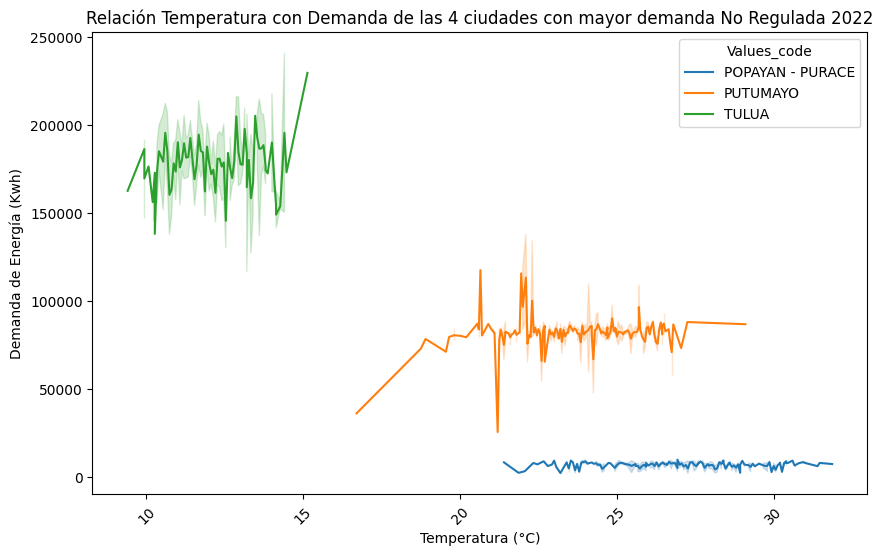

In [351]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_noreg_2022[df_merged_noreg_2022['Values_code'].isin(last_4_ciudades_2022)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda No Regulada 2022")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

In [352]:
df_merged_noreg_2023 = df_merged_2023[df_merged_2023['Values_MarketType'] == 'NO REGULADO']

In [353]:
demanda_por_ciudad = df_merged_reg_2023.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2023 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2023 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

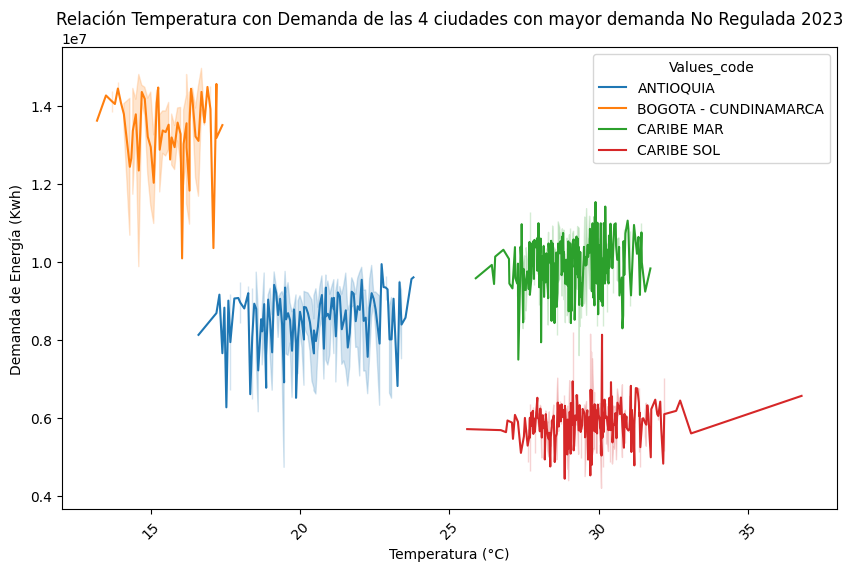

In [354]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_noreg_2023[df_merged_noreg_2023['Values_code'].isin(top_4_ciudades_2023)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda No Regulada 2023")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

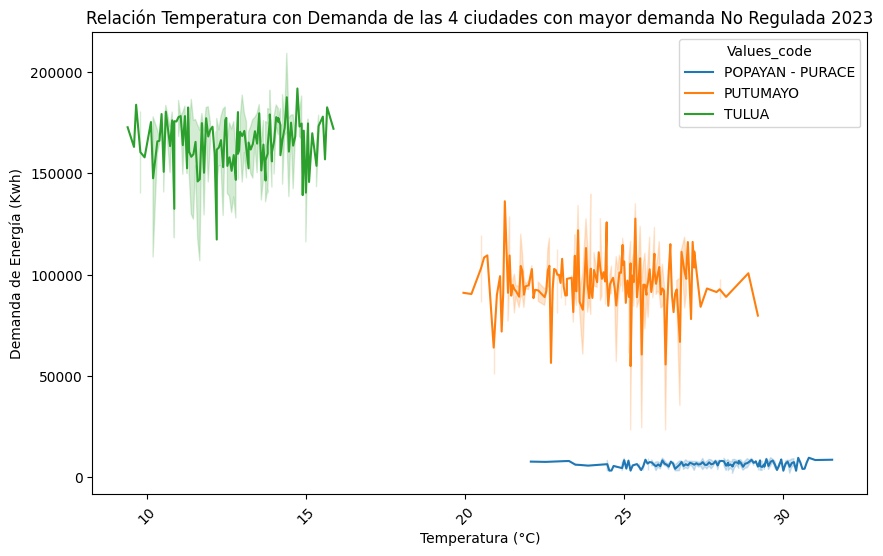

In [355]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_noreg_2023[df_merged_noreg_2023['Values_code'].isin(last_4_ciudades_2023)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda No Regulada 2023")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

In [356]:
df_merged_noreg_2024 = df_merged_2024[df_merged_2024['Values_MarketType'] == 'NO REGULADO']

In [357]:
demanda_por_ciudad = df_merged_reg_2024.groupby('Values_code')['Total Demand'].sum().reset_index()
top_4_ciudades_2024 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=False).head(4)['Values_code'].tolist()
last_4_ciudades_2024 = demanda_por_ciudad.sort_values(by='Total Demand', ascending=True).head(4)['Values_code'].tolist()

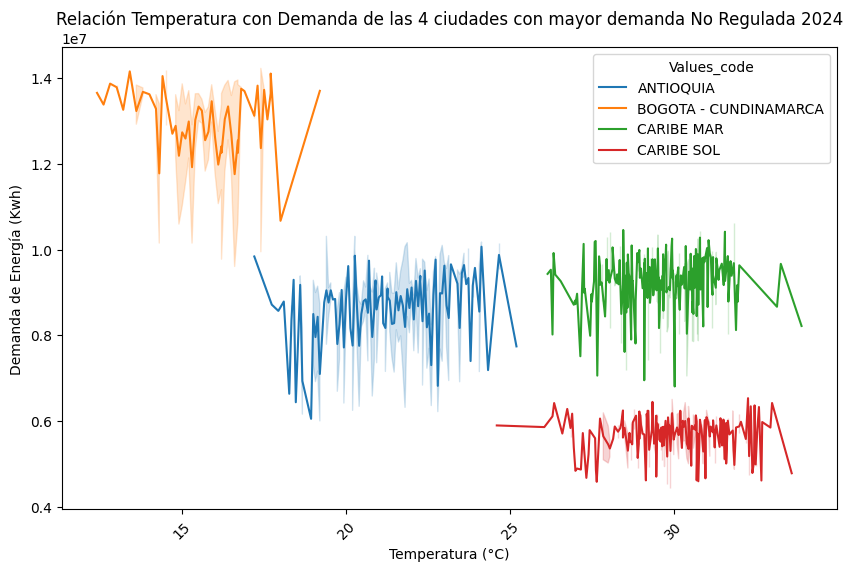

In [358]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_noreg_2024[df_merged_noreg_2024['Values_code'].isin(top_4_ciudades_2024)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda No Regulada 2024")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

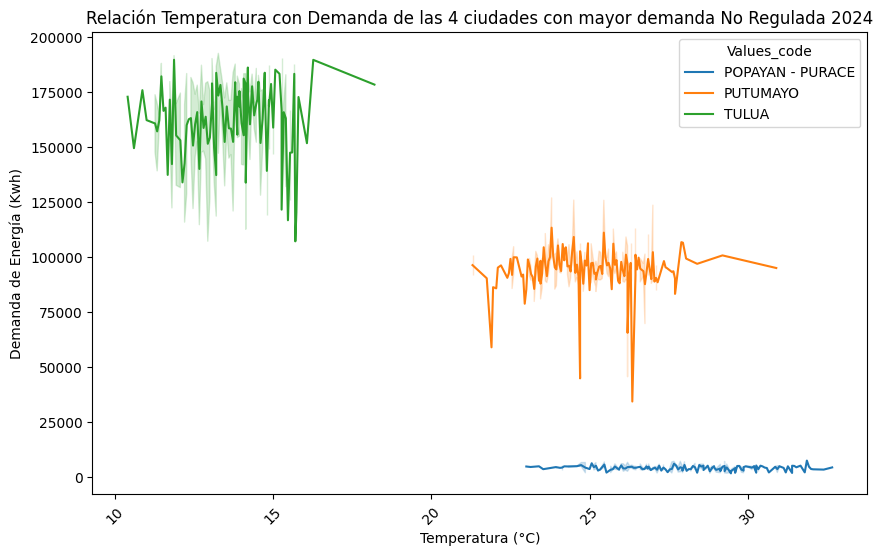

In [359]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df_merged_noreg_2024[df_merged_noreg_2024['Values_code'].isin(last_4_ciudades_2024)], x='Temperatura', y='Total Demand', hue='Values_code', palette="tab10", linestyle='-')

# Etiquetas y título
plt.xlabel("Temperatura (°C)")
plt.ylabel("Demanda de Energía (Kwh)")
plt.title("Relación Temperatura con Demanda de las 4 ciudades con mayor demanda No Regulada 2024")

# Mostrar el gráfico
plt.xticks(rotation=45)
plt.show()

## PIB

In [361]:
df_pib = pd.read_excel('./data/pib.xlsx', sheet_name='Cuadro 2')

In [362]:
#Eliminar las primeras 8 filas
df_pib = df_pib[8:]

#Reiniciar el índice
df_pib.reset_index(drop=True, inplace=True)

#Asingnar la primera fila como nombres de las columnas
df_pib.columns = df_pib.iloc[0]

#Eliminar la primera fila
df_pib = df_pib[2:]

#Eliminar las ultimas  5 filas
df_pib = df_pib[:-5]

In [363]:
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Antioquia", "ANTIOQUIA")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Arauca", "ARAUCA")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Bogotá D.C.", "BOGOTA - CUNDINAMARCA")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Boyacá", "BOYACA")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Caldas", "CALDAS")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Caquetá", "CAQUETA")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Cauca", "CAUCA")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Chocó", "CHOCO")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Guaviare", "GUAVIARE")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Huila", "HUILA")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Meta", "META")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Nariño", "NARIÑO")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Norte de Santander", "NORTE DE SANTANDER")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Risaralda", "PEREIRA")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Casanare", "POPAYAN - PURACE")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Putumayo", "PUTUMAYO")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Santander", "SANTANDER")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Tolima", "TOLIMA")
df_pib["DEPARTAMENTOS"] = df_pib["DEPARTAMENTOS"].replace("Valle del Cauca", "TULUA")
df_pib = df_pib.rename(columns={'DEPARTAMENTOS': 'Values_code', '2021p': '2021', '2022p': '2022', '2023pr': '2023'})

In [364]:
df_pib = df_pib.drop(columns = ['Código Departamento (DIVIPOLA)'])

In [365]:
df_demanda['Año'] = df_demanda['Date'].dt.year

In [366]:
df_melted = df_pib.melt(id_vars='Values_code', var_name='Año', value_name='PIB')
df_melted['Año'] = df_melted['Año'].astype(int)  # Convertir el año a entero para que coincida en formato con df2

In [367]:
df_PIB = pd.merge(df_demanda, df_melted, on=['Values_code', 'Año'], how='inner')

In [368]:
df_PIB = df_PIB.drop(columns=hours_columns)

In [369]:
df_PIB.describe()

,Date,Total Demand,Año
count,40515,4.051500e+04,40515.000000
mean,2022-07-02 00:00:00,3.498903e+06,2022.000000
min,2021-01-01 00:00:00,1.560500e+02,2021.000000
25%,2021-10-01 00:00:00,4.018641e+05,2021.000000
50%,2022-07-02 00:00:00,1.372172e+06,2022.000000
75%,2023-04-02 00:00:00,3.100452e+06,2023.000000
max,2023-12-31 00:00:00,3.426680e+07,2023.000000
std,NaN,6.088462e+06,0.816507


In [370]:
df_PIB['PIB'].isnull().sum()

0

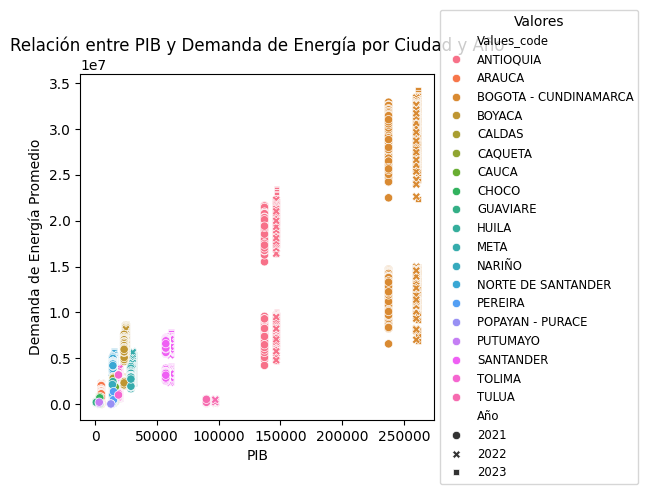

In [372]:
# Crear el gráfico de dispersión
sns.scatterplot(data=df_PIB, x='PIB', y='Total Demand', hue='Values_code', style='Año')

# Personalizar el gráfico
plt.xlabel("PIB")
plt.ylabel("Demanda de Energía Promedio")
plt.title("Relación entre PIB y Demanda de Energía por Ciudad y Año")

# Ajustar la leyenda para que esté a la derecha y no se superponga al gráfico
plt.legend(title='Valores', loc='center left', bbox_to_anchor=(1, 0.5), fontsize='small')

# Ajustar el espacio derecho del gráfico
plt.subplots_adjust(right=0.75)  # Ajusta este valor según sea necesario

# Mostrar el gráfico
plt.tight_layout()
plt.show()

## Conclusiones

- Las regiones con mayor consumo medio de energía son Bogotá y Cundinamarca, con aproximadamente 21.9 millones de kWh, seguidas de Antioquia con 14.7 millones de kWh. 

- Otras regiones con consumo notable incluyen el Caribe Mar y el Caribe Sol, ambos superando los 13 millones de kWh. 

- Las regiones de Bajo Putumayo y Popayán - Puracé presentan los consumos medios más bajos, con menos de 100,000 kWh.

- La variabilidad en el consumo de energía es considerable, siendo Bogotá y Cundinamarca las que muestran la mayor desviación estándar, lo que indica una fluctuación significativa en su demanda. En contraste, regiones como Chocó y Guaviare presentan un consumo más estable, con desviaciones estándar menores.

- Las regiones sin clasificar tienen un consumo significativamente bajo, sugiriendo que los datos de estas áreas pueden no estar completamente representados o que la actividad económica es mínima.

- Los sectores con mayor consumo de energía son predominantemente industriales, como las industrias manufactureras y la explotación de minas y canteras.

- Sectores como el comercio al por mayor y al por menor, así como el transporte y almacenamiento, presentan un consumo energético moderado.

- Las actividades artísticas y otras actividades de bajo impacto muestran un consumo de energía significativamente menor.

- Los sectores con altos niveles de consumo de energía también presentan una gran variabilidad, indicando diferencias significativas en las prácticas operativas.

- **No Festivo** muestra una demanda más alta y variabilidad en comparación con los días **Festivos** y **Domingos**.
- Los **Domingos** y **Festivos** tienen demandas promedio similares, lo que sugiere un patrón de consumo similar en esos días.
- Es recomendable considerar la variabilidad en la demanda, especialmente en días **No Festivos**, para el análisis y la planificación futura de la oferta de energía.


### IPC
Correlaciones: En regiones con mayor actividad económica, como "Bogotá - Cundinamarca" y "Antioquia", podríamos observar niveles más altos tanto de demanda como de IPC. Esto sugiere una correlación positiva en la que las regiones con mayor crecimiento económico y urbanización podrían experimentar una mayor demanda de energía junto con un mayor costo de vida (reflejado en el IPC).

Estabilidad de la demanda: Regiones como "Caribe Sol" y "Cali - Yumbo - Puerto Tejada" muestran una demanda relativamente estable, lo que posiblemente indica que estas áreas tienen necesidades energéticas constantes, tal vez impulsadas por patrones estables de consumo industrial o residencial.

Alta variabilidad: algunas regiones, particularmente aquellas con características mixtas urbanas y rurales, pueden exhibir una alta variabilidad en la demanda a lo largo de los meses. Por ejemplo, las regiones con actividad agrícola podrían experimentar picos en el consumo de energía durante las temporadas agrícolas pico, pero el IPC podría no aumentar tan rápidamente, lo que indica que la demanda de energía está impulsada por sectores específicos y no por una inflación económica generalizada.

Baja variabilidad: Por otro lado, las regiones con bases comerciales o industriales consistentes, como "Cundinamarca", pueden mostrar un aumento más constante tanto en el IPC como en la demanda, lo que sugiere una relación más predecible entre el crecimiento económico y las necesidades energéticas.

### Temperatura

1. Se observa que en el año 2024, la temperatura presenta valores más altos que en los años anteriores, incluso con picos que superan los valores máximos de otros años. Esto puede presentar un posible fallo al utilizar la variable dentro del modelo, dado que no presenta un comportamiento estable para la proyección a estimar.
2. El mayor valor de demanda se presenta en las ciudades capitales, por lo que no presenta una relación directa entre el valor de la temperatura promedio con la demanda.